# CSE327 Homework 2
**Due date: 11:59 pm on Oct. 20, 2017 (Friday)**

## Description
---
In this homework you will experiment with SIFT features for scene matching and object recognition. You will work with the SIFT tutorial and code from the University of Toronto. In the compressed homework file (hw2_files.tgz), you will find the tutorial document (tutSIFT04.pdf) and a paper from the International Journal of Computer Vision (ijcv04.pdf) describing SIFT and object recognition. Although the tutorial document assumes matlab implemention, you should still be able to follow the technical details in it. In addition, you are **STRONGLY** encouraged to read this paper unless you’re already quite familiar with matching and recognition using SIFT.

## Using SIFT in OpenCV 3.x.x
---
Feature descriptors like SIFT and SURF are no longer included in OpenCV since version 3. This section provides  instructions on how to use SIFT for those who use OpenCV 3.x.x. If you are using OpenCV 2.x.x then you are all set, please skip this section. Read this if you are curious about why SIFT is removed https://www.pyimagesearch.com/2015/07/16/where-did-sift-and-surf-go-in-opencv-3/.

One simple way to use the OpenCV in-built function `SIFT` is to switch back to version 2.x.x, but if you want to keep using OpenCV 3.x.x, do the following:
1. uninstall your original OpenCV package
2. install opencv-contrib-python using pip (pip is a Python tool for installing packages written in Python), please find detailed instructions at https://pypi.python.org/pypi/opencv-contrib-python

After you have your OpenCV set up, you should be able to use `cv2.xfeatures2d.SIFT_create()` to create a SIFT object, whose functions are listed at http://docs.opencv.org/3.0-beta/modules/xfeatures2d/doc/nonfree_features.html

## Some Resources
---
In addition to the tutorial document, the following resources can definitely help you in this homework:
- http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_matcher/py_matcher.html
- http://docs.opencv.org/3.1.0/da/df5/tutorial_py_sift_intro.html
- http://docs.opencv.org/3.0-beta/modules/xfeatures2d/doc/nonfree_features.html?highlight=sift#cv2.SIFT
- http://docs.opencv.org/3.0-beta/doc/py_tutorials/py_imgproc/py_geometric_transformations/py_geometric_transformations.html

In [48]:
# import packages here
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm

print ('OpenCV version = ' + cv2.__version__)

OpenCV version = 3.3.0


## Problem 1: Match transformed images using SIFT features
{40 points} You will transform an image, and match it back to the original image using SIFT keypoints.

- **Step 1**. Choose an image you want to use for problem 1. Read it into OpenCV and, if it is a color image, convert it to grayscale (you can use `cv2.cvtColor`). Then use the `detect` function in SIFT object to detect keypoints from the image. Draw the kepoints on the image using the `cv2.drawKeypoints` function. *NOTE: To test if your results are valid, you can use the “./images/einstein.bmp” image in the folder and compare the outputs to the tutorial document. For actual submission, use your own image.*

- **Step 2**. Rotate your image by a certain degree with the `cv2.warpAffine` function. Extract SIFT keypoints for this rotated image and plot the rotated picture with keypoints scale and orientation overlaid just as in step 1.

- **Step 3**. Match the SIFT keypoints of the original image and the rotated imag using the `knnMatch` function in the `cv2.BFMatcher` class. Discard bad matches using the ratio test proposed by D.Lowe in the SIFT paper. Draw the remaining keypoint matches on the image using `cv2.drawMatchesKnn` function.

- **Step 4**. Use the RANSAC algorithm to find the affine transformation from the rotated image to the original image. You are not required to implement RANSAC algorithm yourself, instead you could use the `cv2.findHomography` function (set the 3rd parameter `method` to `cv2.RANSAC`) to compute the transformation matrix. Draw the keypoint matches selected by RANSAC on the image using `cv2.drawMatchesKnn` function. Rotate the rotated image back using this matrix and the `cv2.warpPerspective` function. Does this matrix look similar to the matrix you used in Step 2? If not, how do they differ?

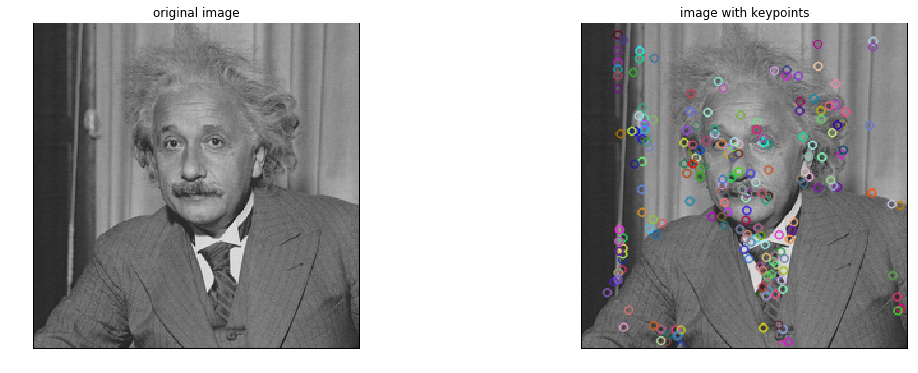

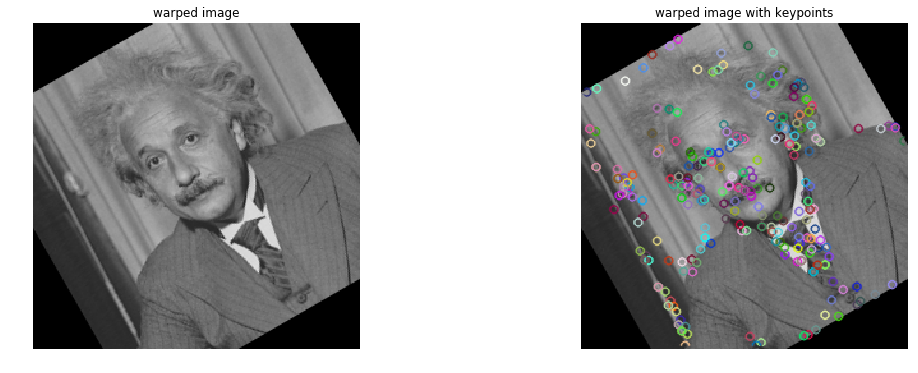

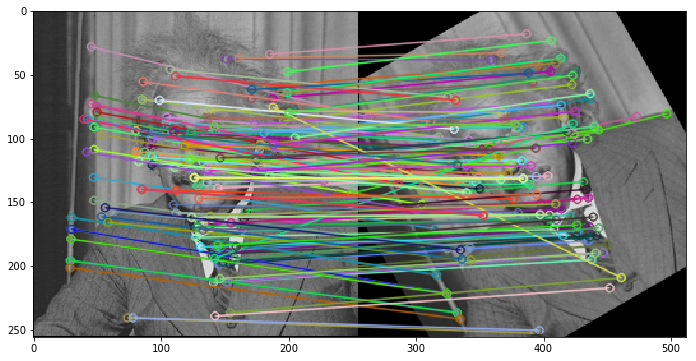

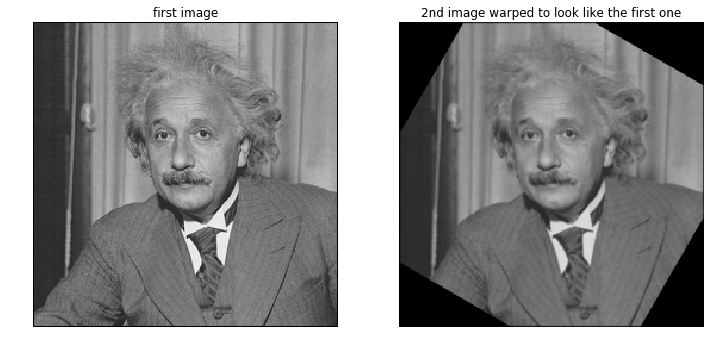

In [147]:
# # read the image from images in local directory
img = cv2.imread('images/einstein.bmp')
# convert a color image to gray
img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# creating SIFT
d= cv2.xfeatures2d.SIFT_create() 

#getting the keypoints for the warped image
kp1 = d.detect(img_gray)

#drawing keypoints 
out_img = cv2.drawKeypoints(img_gray, kp1, np.array([])) #,(0,0,255),  cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) 

# plotting the original image
plt.figure(figsize=(18, 6))
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.title('original image')
plt.axis("off")

#plotting the image with keypoints
plt.subplot(1, 2, 2)
plt.imshow(out_img, 'gray')
plt.title('image with keypoints')
plt.axis("off")

plt.show()

#creating an affine image
#specifying the angle
angle = 30 

#getting the height and width of the image
rows, cols = img_gray.shape

#finding the rotation matrix w.r.t. rotation point being the center of the image
M = cv2.getRotationMatrix2D((cols/2,rows/2),angle,1) 

#warping the image
warp_img = cv2.warpAffine(img, M, (cols,rows))

#getting the keypoints for the warped image
kp2 = d.detect(warp_img)

#drawing keypoints 
out_warp_img = cv2.drawKeypoints(warp_img, kp2, np.array([]))

#plotting the warped image
plt.figure(figsize=(18, 6))
plt.subplot(1, 2, 1)
plt.imshow(warp_img)
plt.title('warped image')
plt.axis("off")

#plotting the warped image with its keypoints
plt.subplot(1, 2, 2)
plt.imshow(out_warp_img, 'gray')
plt.title('warped image with keypoints')
plt.axis("off")

plt.show()

#getting descriptors because we only got the keypoints above
kp1, des1 = d.detectAndCompute(img_gray, None)
kp2, des2 = d.detectAndCompute(warp_img ,None)


#creating a Brute-force descriptor matcher
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)

#using and applying the ratio test proposed by D.Lowe in the SIFT 
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

#drawing the knn matches 
img3 = cv2.drawMatchesKnn(img_gray ,kp1, warp_img, kp2, good, None, flags = 2)
plt.figure(figsize=(18, 6))
plt.imshow(img3)
plt.show()


im_src = img_gray
im_dst = warp_img
MIN_MATCH_COUNT = 10

if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m[0].queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m[0].trainIdx].pt for m in good ]).reshape(-1,1,2)
    
    #applying RANSAC
    M, mask = cv2.findHomography( dst_pts,src_pts, cv2.RANSAC,5.0)

else:
    print "Please use more appropriate pictures"

#warping the second image to look like the first one
out_img = cv2.warpPerspective(im_dst, M, (im_src.shape[1],im_src.shape[0]))

#plotting the images
plt.figure(figsize=(12, 36))
plt.subplot(1, 2, 1)
plt.imshow(img_gray, 'gray')
plt.title('first image')
plt.axis("off")

# plotting the warped image
plt.subplot(1, 2, 2)
plt.imshow(out_img, 'gray')
plt.title("2nd image warped to look like the first one")
plt.axis("off")
plt.show()

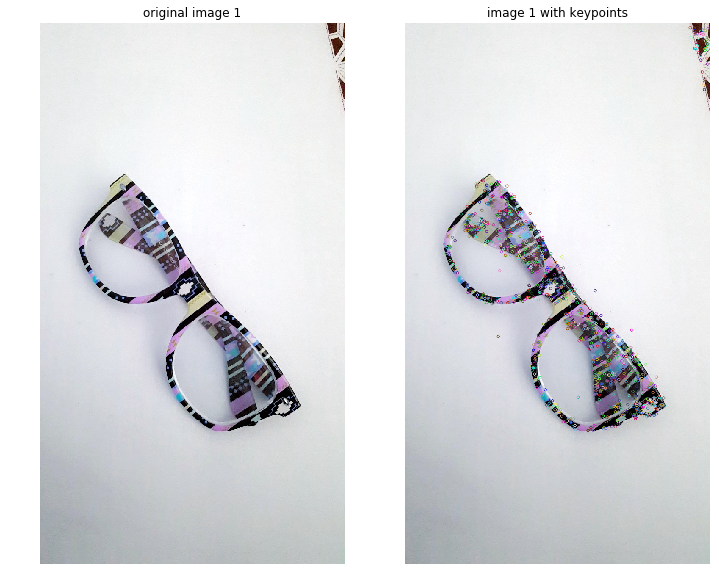

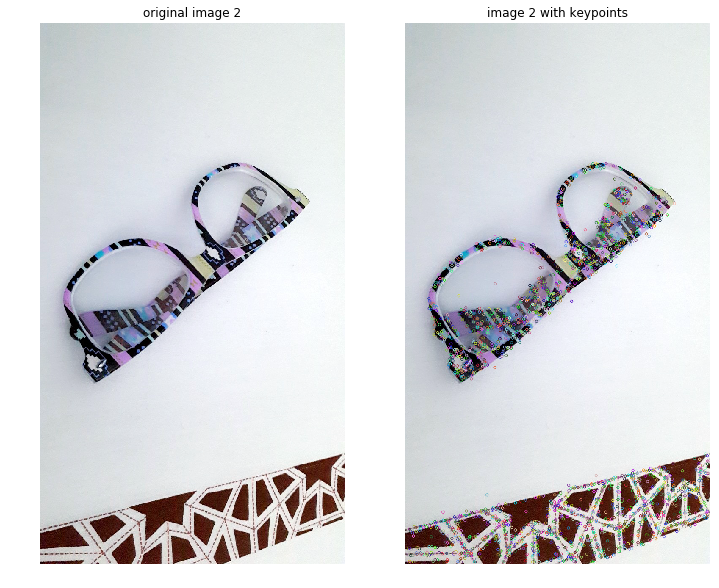

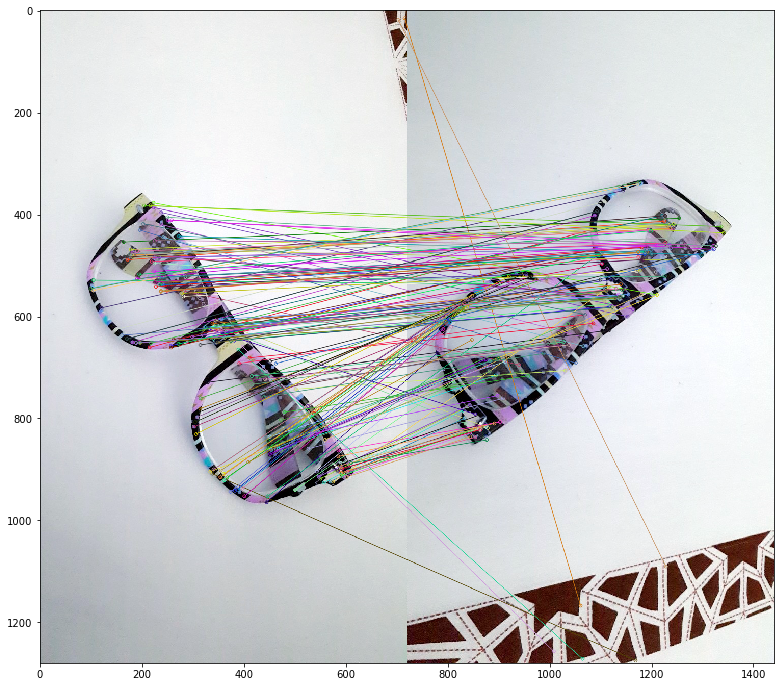

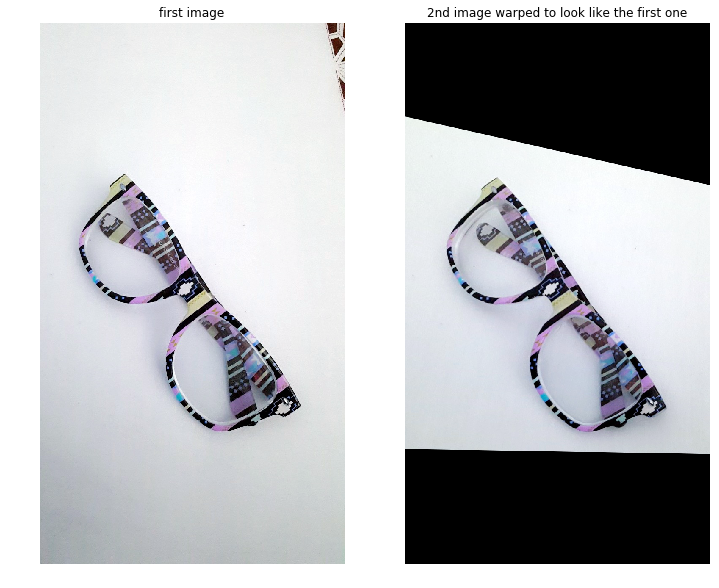

In [62]:
# Step 4. 
# Use the RANSAC algorithm to find the affine transformation from the rotated image to the original image. 
# You are not required to implement RANSAC algorithm yourself, instead you could use the cv2.findHomography function 
# (set the 3rd parameter method to cv2.RANSAC) to compute the transformation matrix. Draw the keypoint matches 
# selected by RANSAC on the image using cv2.drawMatchesKnn function. Rotate the rotated image back using this 
# matrix and the cv2.warpPerspective function. Does this matrix look similar to the matrix you used in Step 2? 
# If not, how do they differ?

#Here we are using 2 different images instead of using the same image and warping it 

# # read the image from images in local directory
# im_src = cv2.imread('images/book1.jpg')
# im_dst = cv2.imread('images/book2.jpg')
im_src = cv2.imread('images/img1.jpg')
im_dst = cv2.imread('images/img2.jpg')
img_gray = cv2.cvtColor(im_src, cv2.COLOR_RGB2GRAY)

# im_src = cv2.imread('images/img3.jpg')
# im_dst = cv2.imread('images/img4.jpg')
# # im_src = cv2.imread('images/img5.jpg')
# # im_dst = cv2.imread('images/img6.jpg')

# creating SIFT
d= cv2.xfeatures2d.SIFT_create() 

#getting the keypoints and descriptors
kp1, des1 = d.detectAndCompute(im_src, None)
kp2, des2 = d.detectAndCompute(im_dst, None)

#drawing keypoints 
out_img = cv2.drawKeypoints(im_src, kp1, np.array([])) 
#,(0,0,255),  cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS) // can use this for specific color for keypoint


#plotting the 1st original image
plt.figure(figsize=(12, 36))
plt.subplot(1, 2, 1)
plt.imshow(im_src)
plt.title('original image 1')
plt.axis("off")

#plotting the 1st original image with its keypoints
plt.subplot(1, 2, 2)
plt.imshow(out_img, 'gray')
plt.title('image 1 with keypoints')
plt.axis("off")
plt.show()

out_img = cv2.drawKeypoints(im_dst, kp2, np.array([]))

#plotting the 2nd original image
plt.figure(figsize=(12, 36))
plt.subplot(1, 2, 1)
plt.imshow(im_dst)
plt.title('original image 2')
plt.axis("off")

#plotting the 2nd original image with its keypoints
plt.subplot(1, 2, 2)
plt.imshow(out_img, 'gray')
plt.title('image 2 with keypoints')
plt.axis("off")
plt.show()

#creating a Brute-force descriptor matcher
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)

#using and applying the ratio test proposed by D.Lowe in the SIFT 
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

im_connection = cv2.drawMatchesKnn(im_src, kp1, im_dst, kp2, good, None, flags = 2)
plt.figure(figsize=(36, 12))
plt.imshow(im_connection)
plt.show()

MIN_MATCH_COUNT = 10

#making sure there are atleast the minimum matches required to find homography
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([kp1[m[0].queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m[0].trainIdx].pt for m in good]).reshape(-1,1,2)

    #applying RANSAC with tolerance
    M, mask = cv2.findHomography(dst_pts,src_pts, cv2.RANSAC,5.0)
else:
    print "Please use more appropriate pictures"

#warping the second image to look like the first one
out_img = cv2.warpPerspective(im_dst, M, (im_src.shape[1],im_src.shape[0]))

#plotting the images
plt.figure(figsize=(12, 36))
plt.subplot(1, 2, 1)
plt.imshow(im_src)
plt.title('first image')
plt.axis("off")

# plotting the warped image
plt.subplot(1, 2, 2)
plt.imshow(out_img, 'gray')
plt.title("2nd image warped to look like the first one")
plt.axis("off")
plt.show()


## Problem 2: Scene stitching with SIFT features
{30 points} You will match and align between different views of a scene with SIFT features.

- **Step 1**. Choose two or more pictures of the same scene but taken from a different viewpoint. You can find appropriate images on the web or take photos by yourself (recommended). Adjust them so that they match in size. Or you could just use `input[1~3].png` in folder `./images/`. You may use `cv2.copyMakeBorder` function to pad the image with zeros into a larger size. 

- **Step 2**. Extract SIFT features for both images and go through the same procedures as you did in problem 1. Your goal is to find the affine transformation between the two images. Align one of your images to the other using .
- **Step 3** Use the `cv2.addWeighted` function to blend the aligned images together and show the stitched image. Examples can be found at http://docs.opencv.org/trunk/d0/d86/tutorial_py_image_arithmetics.html.
- **Bonus Part {15 points}**. Instead of using `cv2.addWeighted` to do the blending, you are asked to implement Laplacian Pyramids to blend the two aligned images. Tutorials can be found at http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_pyramids/py_pyramids.html.

In [149]:
# making the code that we did in part 1 as a function
# so we can use it modularly
def getTransformation(im_src, im_dst):

    # creating SIFT
    d= cv2.xfeatures2d.SIFT_create() 

    #getting the keypoints and descriptors
    kp1, des1 = d.detectAndCompute(im_src, None)
    kp2, des2 = d.detectAndCompute(im_dst ,None)
    #creating a Brute-force descriptor matcher
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)

    #using and applying the ratio test proposed by D.Lowe in the SIFT 
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append([m])
            
    MIN_MATCH_COUNT = 10
    #making sure there are atleast the minimum matches required to find homography
    if len(good)>MIN_MATCH_COUNT:
        src_pts = np.float32([kp1[m[0].queryIdx].pt for m in good]).reshape(-1,1,2)
        dst_pts = np.float32([kp2[m[0].trainIdx].pt for m in good]).reshape(-1,1,2)

        #applying RANSAC with tolerance
        M, mask = cv2.findHomography(dst_pts,src_pts, cv2.RANSAC,5.0)
    else:
        print "Please use more appropriate pictures"
        M = 0
    
    return M

    

In [150]:
#function to take 2 images and overlap them without transparency issues
# This is done to avoid black padding created while warping
# we use overlap(image, image) function instead of addweighted(...) function
def overlap(img1, img2):
    output = img2 # copies the 2nd image
    height, width = img1.shape # getting the height and width of the 1st image
    
    #iterate over the image
    for x in xrange(height):
        for y in xrange(width):
            # if the value of the pixel of 1st image is greater than the 2nd
            # we replace the pixel in the output image with that pixel
            # This is done to avoid black padding created while warping
            # doesnt put black unless both of them are black
            if img1.item(x, y) > img2.item(x, y):
                output.itemset((x,y),img1.item(x, y))
    return output

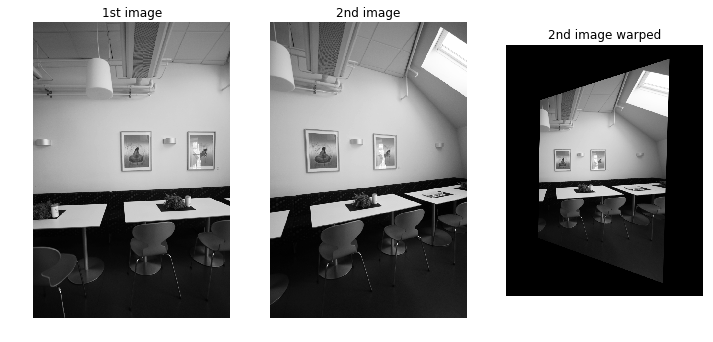

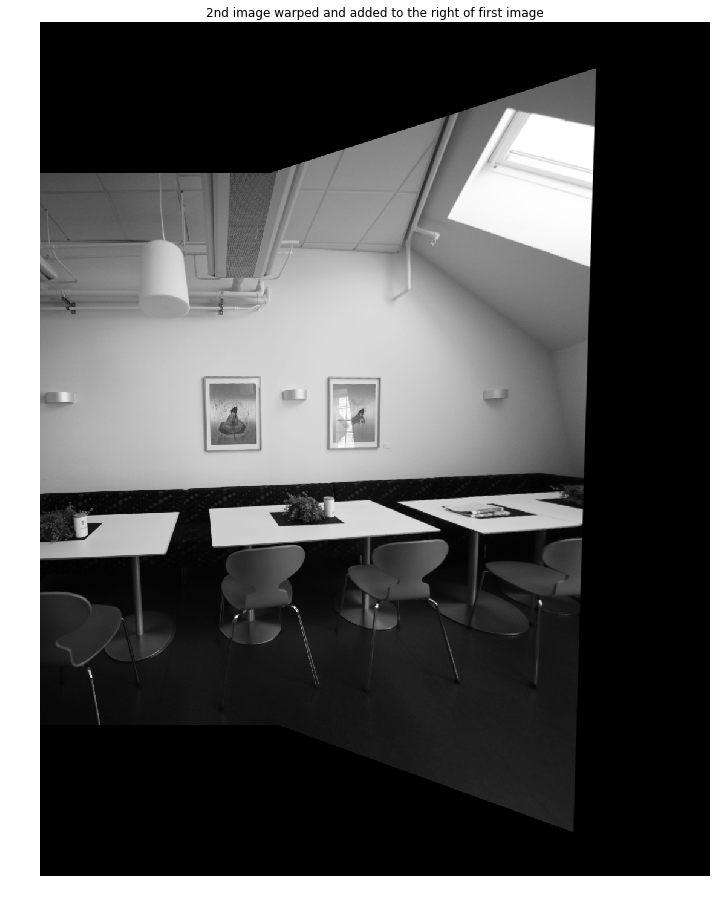

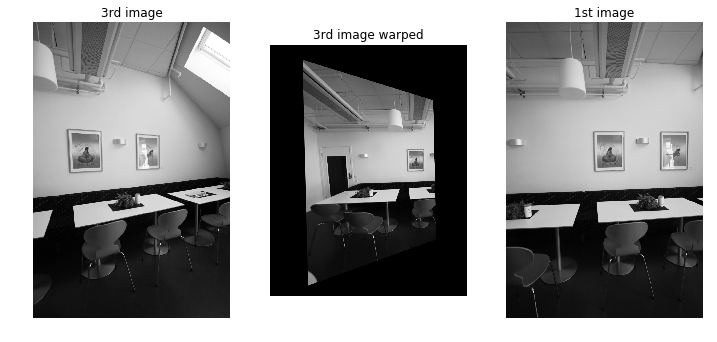

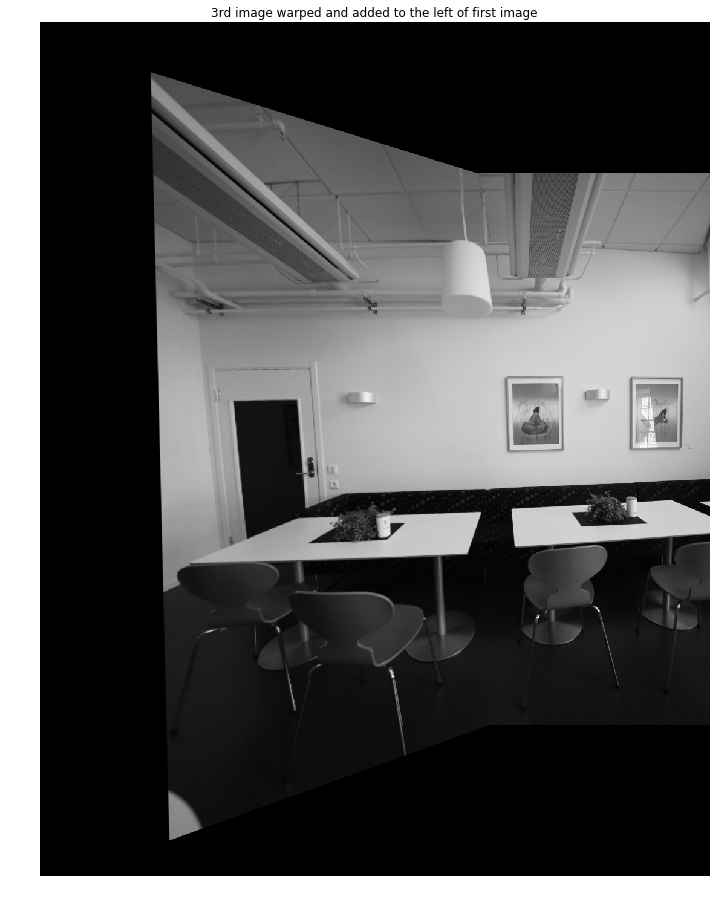

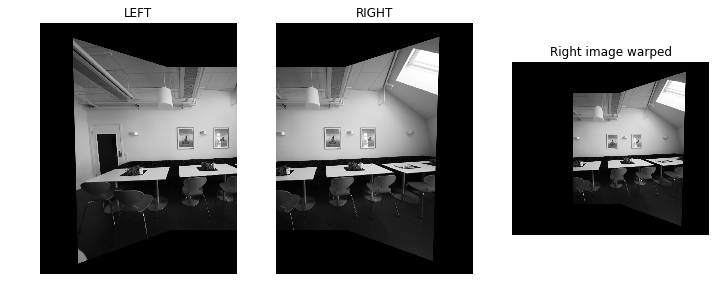

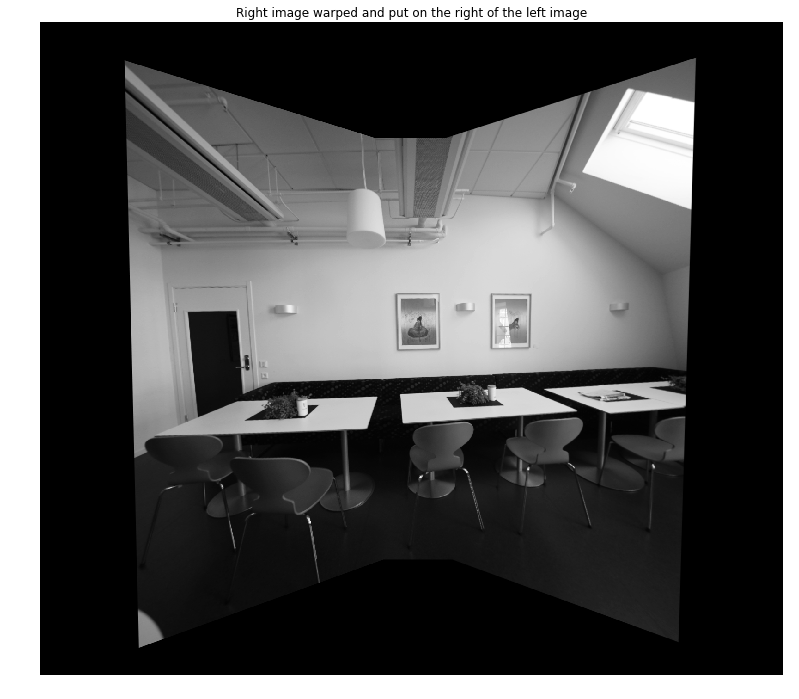

In [151]:
# read the image from images in local directory
img1 = cv2.imread('images/input1.png')
img2 = cv2.imread('images/input2.png')
img3 = cv2.imread('images/input3.png')

# converting them into gray to make life easier
img1 = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)
img3 = cv2.cvtColor(img3, cv2.COLOR_RGB2GRAY)

# creating SIFT
d= cv2.xfeatures2d.SIFT_create() 

#getting the keypoints and descriptors
kp1, des1 = d.detectAndCompute(img1, None)
kp2, des2 = d.detectAndCompute(img2 ,None)
kp3, des3 = d.detectAndCompute(img3 ,None)

# defining black color to make the image bigger and putting black in the boundary
BLACK = [0,0,0]

# adding constant black padding on the 1st image
#cv2.copyMakeBorder(src, top, bottom, left, right, borderType[, dst[, value]]) → dst
#added black padding to the top, bottom and right as we are going to add the warped image to the right
constant = cv2.copyMakeBorder(img1,250,250,0,500,cv2.BORDER_CONSTANT,value=BLACK)

# creating the warped image of the 2nd image
out_img = cv2.warpPerspective(img2, getTransformation(constant,img2), (constant.shape[1],constant.shape[0]))

#plotting 1st images
plt.figure(figsize=(12, 36))
plt.subplot(1, 3, 1)
plt.imshow(img1, 'gray')
plt.title('1st image')
plt.axis("off")

#plotting 2nd image
plt.subplot(1, 3, 2)
plt.imshow(img2, 'gray')
plt.title('2nd image')
plt.axis("off")

# plotting the warped image
plt.subplot(1, 3, 3)
plt.imshow(out_img, 'gray')
plt.title("2nd image warped")
plt.axis("off")
plt.show()

#dst1 = cv2.addWeighted(constant, 0.7, out_img,0.3,0)
right = overlap(constant, out_img)

#plotting the combined image
plt.figure(figsize=(12,36))
plt.imshow(right, 'gray')
plt.title("2nd image warped and added to the right of first image")
plt.axis("off")
plt.show()

# adding constant black padding on the 1st image
#added black padding to the top, bottom and left as we are going to add the warped image to the left
constant= cv2.copyMakeBorder(img1,250,250,500,0,cv2.BORDER_CONSTANT,value=BLACK)
out_img = cv2.warpPerspective(img3, getTransformation(constant,img3), (constant.shape[1],constant.shape[0]))

#plotting the images
plt.figure(figsize=(12, 36))
plt.subplot(1, 3, 1)
plt.imshow(img2,'gray')
plt.title('3rd image')
plt.axis("off")


# plotting the warped image
plt.subplot(1, 3, 2)
plt.imshow(out_img, 'gray')
plt.title("3rd image warped")
plt.axis("off")


plt.subplot(1, 3, 3)
plt.imshow(img1,'gray')
plt.title('1st image')
plt.axis("off")
plt.show()

#dst2 = cv2.addWeighted( out_img,0.3,constant, 0.4,0)
left = overlap(constant, out_img)

#plotting the combined image
plt.figure(figsize=(12,36))
plt.imshow(left, 'gray')
plt.title("3rd image warped and added to the left of first image")
plt.axis("off")
plt.show()


# adding constant black padding on the left warped image
#added black padding to the top, bottom and left as we are going to add the warped image to the left
constant= cv2.copyMakeBorder(left,0,0,0,500,cv2.BORDER_CONSTANT,value=BLACK)
out_img = cv2.warpPerspective(right, getTransformation(left,right), (constant.shape[1],constant.shape[0]))


#plotting the images
plt.figure(figsize=(12, 36))
plt.subplot(1, 3, 1)
plt.imshow(left, 'gray')
plt.title('LEFT')
plt.axis("off")

# plotting the warped image
plt.subplot(1, 3, 2)
plt.imshow(right, 'gray')
plt.title("RIGHT")
plt.axis("off")

# plotting the warped image
plt.subplot(1, 3, 3)
plt.imshow(out_img, 'gray')
plt.title("Right image warped")
plt.axis("off")
plt.show()

#dst = cv2.addWeighted(constant, 0.5, out_img,0.5,0)

dst = overlap(constant, out_img)

#plotting the ultimate combined picture
plt.figure(figsize=(36,12))
plt.imshow(dst, 'gray')
plt.title("Right image warped and put on the right of the left image")
plt.axis("off")
plt.show()

## Problem 3: Object Recognition with HOG features
{30 points} You will use the histogram of oriented gradients (HOG) to extract features from objects and recognize them.

HOG decomposes an image into multiple cells, computes the direction of the  gradients for all pixels in each cell, and creates a histogram of gradient orientation for that cell. Object recognition with HOG is usually done by extracting HOG features from a training set of images, learning a support vector machine (SVM) from those features, and then testing a new image with the SVM to determine if there are objects.

You can use `cv2.HOGDescriptor` to extract HoG feature and `cv2.ml.SVM_create` for SVM (and a lot of other algorithms). You can also use other Python machine learning packages for SVM, e.g.`scikit-learn`. Please find the OpenCV SVM tutorial at https://www.learnopencv.com/handwritten-digits-classification-an-opencv-c-python-tutorial/.

- **Step 1**. Find several pictures of two different objects. However, if you have only a small number of images for each object, try to add more (I would recommend at least 10 images for each object.). Or you could use the digit dataset `digits.png` in the HW2.zip file and select two classes/digits to train your SVM. Please see http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_ml/py_knn/py_knn_opencv/py_knn_opencv.html#knn-opencv to extract the images.

- **Step 2**. Divide your image set into training and testing sets. For example, if you have 20 images (10 for each object), use 19 for the training set and pick only one image for the testing set. (We will do a cross validation afterwards by changing the image in the test set.)

- **Step 3**. Crop the training images around the actual object that you want to detect. Keep in mind that the cropped image size should be the same across all training images, regardless of what kind of objects are in those images. (Which means that we’ll not consider multiple object scales at this point.) Try to find a cropping size that nicely wraps around most objects. You don’t need to crop the test image.

- **Step 4**. Extract HOG features from the cropped training images. You can use the OpenCV function `cv2.HOGDescriptor`. Show what your HOG features look like on your images.

- **Step 5**. The extracted HOG features will be in the form of three-dimensional matrices. Reshape them so that the HOG features from each image form a single column vector. Use the reshape() function in numpy to do this. For example, if your HOG feature for each image is a 60 * 80 * 31 matrix, reshape it to a 148800 * 1 vector. Then concatenate the vectors from all training images into a single matrix. If you had 19 images in the training set, your final matrix size would be 148800 * 19.

- **Step 6**. Train a SVM on your features. You need to pass the matrix you calculated in step 5, as well as a vector of labels that indicate which columns in that matrix correspond to which object. For example, if your matrix has 10 columns where the first 5 columns represent pictures of a book and the last 5 columns represent pictures of a phone, your vector of labels would be something like [1 1 1 1 1 -1 -1 -1 -1 -1].

- **Step 7**. Extract HOG features from the test image. Implement a simple sliding-window algorithm where you calculate HOG features for different locations in the image. The size of the sliding window should be the same as that of the cropped training images. For each sliding window location, calculate the classification score for the test image. This score indicates the classification result for your test image. For example, if you labeled the pictures of a book as 1 and the pictures of a phone as -1 during the training phase, the scores would be close to 1 if SVM classified the test image as a book and -1 if SVM classified it as a phone. (They would be real values between -1 and 1.) Try to find the sliding window location that gives you the most confident scores. That location will be where your detected object is.

- **Step 8**. Now do a leave-one-out cross validation on the images. Repeat steps 2 to 7, but pick a different test image for each iteration. Remember that you should not include this test image in the training set. In the end, you should have a classification score and the sliding window location of the detected object for each and every image. Submit all the scores, as well as figures showing the location of the detected objects in the images.

In [4]:
img = [] #array for the image
label =[] #array for the image

print "Importing all the image data.."

# defining white color to make the image bigger and putting white in the boundary
# it is not so that we can resize the outlier images which are smaller than the cropped size
WHITE = [255,255,255]

# iterating over 500 pairs of images to store them in an array
# which means we have a total of 1000 data
# index goes from 1-1 to 501-1 -> 0 to 500.
for i in range(1,501):
    # just making sure that we get the appropriate images
    if i<10:
        ex = '000'
    elif i<100:
        ex = '00'
    else:
        ex = '0'
       
    # importing the airplane data
    img_input = cv2.imread('images/airplanes/image_' + str(ex) + str(i) + '.jpg')
    # making it bigger and cropping it accordingly
    img_input = cv2.copyMakeBorder(img_input,0,200,0,200,cv2.BORDER_CONSTANT,value= WHITE)[0:200,0:350]
    # saving the grayscale image to the array
    img.append(cv2.cvtColor(img_input,cv2.COLOR_RGB2GRAY))
    label.append(1)
    
    # importing the airplane data
    img_input = cv2.imread('images/Motorbikes/image_' + str(ex) + str(i) + '.jpg')
    # making it bigger and cropping it accordingly
    img_input = cv2.copyMakeBorder(img_input,0,200,0,200,cv2.BORDER_CONSTANT,value= WHITE)[0:200,0:350]
    # saving the grayscale image to the array
    img.append(cv2.cvtColor(img_input,cv2.COLOR_RGB2GRAY))
    label.append(-1)
    
    print "Processing image pair number: " + str(i) + " with shape " + str(img_input.shape) + "..."

# 1 for Airplane
# -1 for Motorbike

#here train_len is used to selectedly train from only some of the data from all the inputed data
x = np.array(img)
train_len = 200
total_len = len(img)

#training data
train_img = x[0:train_len] #saving the partial data
# we take the labels for the train data
train_label = np.array(label[:train_len])

# rest of them can be used for testing data
test_img = np.array(x[train_len: total_len])
test_label = np.array(label[train_len:total_len])

print "Importing image data finished.."
print "We will only train from " + str(train_len) + " number of data out of " + str(total_len) + " data ... "
print "We can move on to the next step......"

Importing all the image data..
Processing image pair number: 1 with shape (200L, 350L, 3L)...
Processing image pair number: 2 with shape (200L, 350L, 3L)...
Processing image pair number: 3 with shape (200L, 350L, 3L)...
Processing image pair number: 4 with shape (200L, 350L, 3L)...
Processing image pair number: 5 with shape (200L, 350L, 3L)...
Processing image pair number: 6 with shape (200L, 350L, 3L)...
Processing image pair number: 7 with shape (200L, 350L, 3L)...
Processing image pair number: 8 with shape (200L, 350L, 3L)...
Processing image pair number: 9 with shape (200L, 350L, 3L)...
Processing image pair number: 10 with shape (200L, 350L, 3L)...
Processing image pair number: 11 with shape (200L, 350L, 3L)...
Processing image pair number: 12 with shape (200L, 350L, 3L)...
Processing image pair number: 13 with shape (200L, 350L, 3L)...
Processing image pair number: 14 with shape (200L, 350L, 3L)...
Processing image pair number: 15 with shape (200L, 350L, 3L)...
Processing image p

Processing image pair number: 131 with shape (200L, 350L, 3L)...
Processing image pair number: 132 with shape (200L, 350L, 3L)...
Processing image pair number: 133 with shape (200L, 350L, 3L)...
Processing image pair number: 134 with shape (200L, 350L, 3L)...
Processing image pair number: 135 with shape (200L, 350L, 3L)...
Processing image pair number: 136 with shape (200L, 350L, 3L)...
Processing image pair number: 137 with shape (200L, 350L, 3L)...
Processing image pair number: 138 with shape (200L, 350L, 3L)...
Processing image pair number: 139 with shape (200L, 350L, 3L)...
Processing image pair number: 140 with shape (200L, 350L, 3L)...
Processing image pair number: 141 with shape (200L, 350L, 3L)...
Processing image pair number: 142 with shape (200L, 350L, 3L)...
Processing image pair number: 143 with shape (200L, 350L, 3L)...
Processing image pair number: 144 with shape (200L, 350L, 3L)...
Processing image pair number: 145 with shape (200L, 350L, 3L)...
Processing image pair num

Processing image pair number: 263 with shape (200L, 350L, 3L)...
Processing image pair number: 264 with shape (200L, 350L, 3L)...
Processing image pair number: 265 with shape (200L, 350L, 3L)...
Processing image pair number: 266 with shape (200L, 350L, 3L)...
Processing image pair number: 267 with shape (200L, 350L, 3L)...
Processing image pair number: 268 with shape (200L, 350L, 3L)...
Processing image pair number: 269 with shape (200L, 350L, 3L)...
Processing image pair number: 270 with shape (200L, 350L, 3L)...
Processing image pair number: 271 with shape (200L, 350L, 3L)...
Processing image pair number: 272 with shape (200L, 350L, 3L)...
Processing image pair number: 273 with shape (200L, 350L, 3L)...
Processing image pair number: 274 with shape (200L, 350L, 3L)...
Processing image pair number: 275 with shape (200L, 350L, 3L)...
Processing image pair number: 276 with shape (200L, 350L, 3L)...
Processing image pair number: 277 with shape (200L, 350L, 3L)...
Processing image pair num

Processing image pair number: 396 with shape (200L, 350L, 3L)...
Processing image pair number: 397 with shape (200L, 350L, 3L)...
Processing image pair number: 398 with shape (200L, 350L, 3L)...
Processing image pair number: 399 with shape (200L, 350L, 3L)...
Processing image pair number: 400 with shape (200L, 350L, 3L)...
Processing image pair number: 401 with shape (200L, 350L, 3L)...
Processing image pair number: 402 with shape (200L, 350L, 3L)...
Processing image pair number: 403 with shape (200L, 350L, 3L)...
Processing image pair number: 404 with shape (200L, 350L, 3L)...
Processing image pair number: 405 with shape (200L, 350L, 3L)...
Processing image pair number: 406 with shape (200L, 350L, 3L)...
Processing image pair number: 407 with shape (200L, 350L, 3L)...
Processing image pair number: 408 with shape (200L, 350L, 3L)...
Processing image pair number: 409 with shape (200L, 350L, 3L)...
Processing image pair number: 410 with shape (200L, 350L, 3L)...
Processing image pair num

In [5]:
print "Starting to compute the HOG of the train data "
hog = cv2.HOGDescriptor() #initialising hog descriptor

#svm2 = cv2.ml.SVM_create()

hog_train = [] # array to save the HOG training data
count = 0 # just for decoration
for i in train_img:
    y = np.array(hog.compute(i))
    index = y.shape[0] # here index stores the hog's dimension so that we dont have to hard code
    hog_train.append(y) # saving the data to the hog train
    count+=1
    print "Computing HOG data number: "+ str(count) + " with the shape " + str(y.shape) + "..."

print "HOG computation of all training data is calculated and stored ..."
print "Reshaping the HOG data to " + str(train_len) + "," + str(index) + "..."
hog_train = np.array(hog_train) #changing it into a numpy array
hog_train = hog_train.reshape(train_len, index) #reshaping the matrix

print "HOG computation of all training data is calculated, stored and reshaped to " + str(hog_train.shape) + "..."
print "We can move on to the next step......"


Starting to compute the HOG of the train data 
Computing HOG data number: 1 with the shape (1360800L, 1L)...
Computing HOG data number: 2 with the shape (1360800L, 1L)...
Computing HOG data number: 3 with the shape (1360800L, 1L)...
Computing HOG data number: 4 with the shape (1360800L, 1L)...
Computing HOG data number: 5 with the shape (1360800L, 1L)...
Computing HOG data number: 6 with the shape (1360800L, 1L)...
Computing HOG data number: 7 with the shape (1360800L, 1L)...
Computing HOG data number: 8 with the shape (1360800L, 1L)...
Computing HOG data number: 9 with the shape (1360800L, 1L)...
Computing HOG data number: 10 with the shape (1360800L, 1L)...
Computing HOG data number: 11 with the shape (1360800L, 1L)...
Computing HOG data number: 12 with the shape (1360800L, 1L)...
Computing HOG data number: 13 with the shape (1360800L, 1L)...
Computing HOG data number: 14 with the shape (1360800L, 1L)...
Computing HOG data number: 15 with the shape (1360800L, 1L)...
Computing HOG dat

Computing HOG data number: 132 with the shape (1360800L, 1L)...
Computing HOG data number: 133 with the shape (1360800L, 1L)...
Computing HOG data number: 134 with the shape (1360800L, 1L)...
Computing HOG data number: 135 with the shape (1360800L, 1L)...
Computing HOG data number: 136 with the shape (1360800L, 1L)...
Computing HOG data number: 137 with the shape (1360800L, 1L)...
Computing HOG data number: 138 with the shape (1360800L, 1L)...
Computing HOG data number: 139 with the shape (1360800L, 1L)...
Computing HOG data number: 140 with the shape (1360800L, 1L)...
Computing HOG data number: 141 with the shape (1360800L, 1L)...
Computing HOG data number: 142 with the shape (1360800L, 1L)...
Computing HOG data number: 143 with the shape (1360800L, 1L)...
Computing HOG data number: 144 with the shape (1360800L, 1L)...
Computing HOG data number: 145 with the shape (1360800L, 1L)...
Computing HOG data number: 146 with the shape (1360800L, 1L)...
Computing HOG data number: 147 with the 

In [6]:
print "Training Started..."
clf = svm.SVC() #initialising the svm #classifier
#clf = svm.SVC(gamma=0.001, C = 100)
clf.fit(hog_train,train_label) #fitting and training

print "Training Finished..."
print "We can move on to the next step......"

Training Started...
Training Finished...
We can move on to the next step......


Predicting image number 250


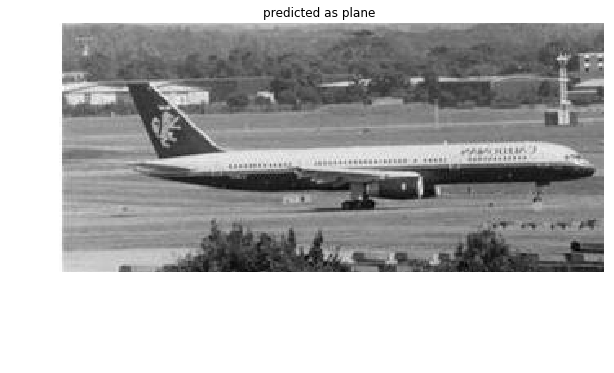

Predicting image number 251


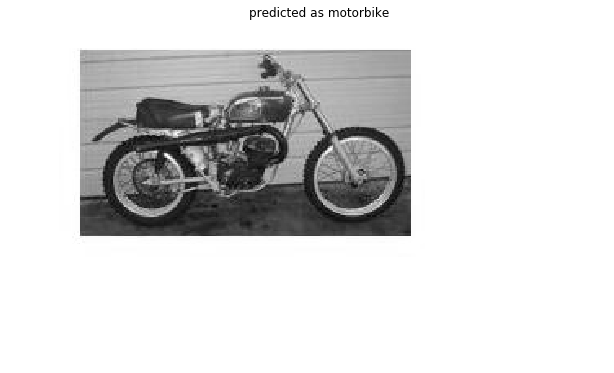

Predicting image number 252


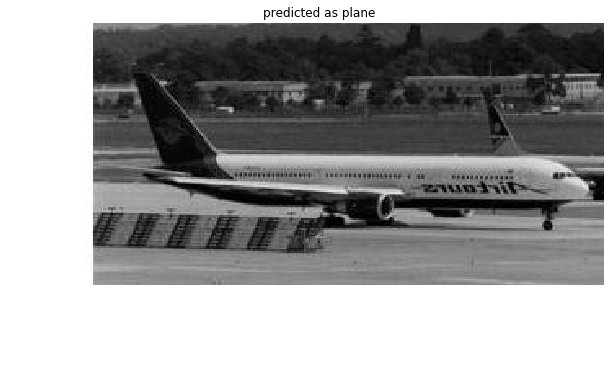

Predicting image number 253


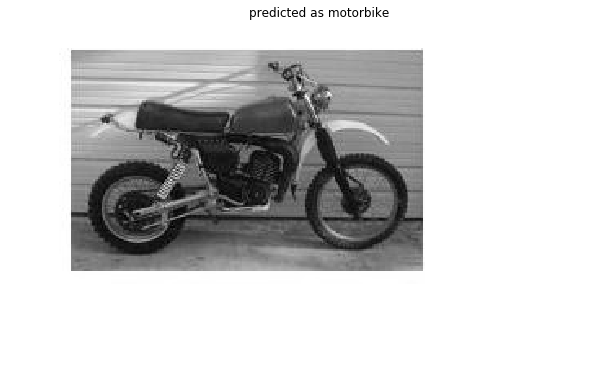

Predicting image number 254


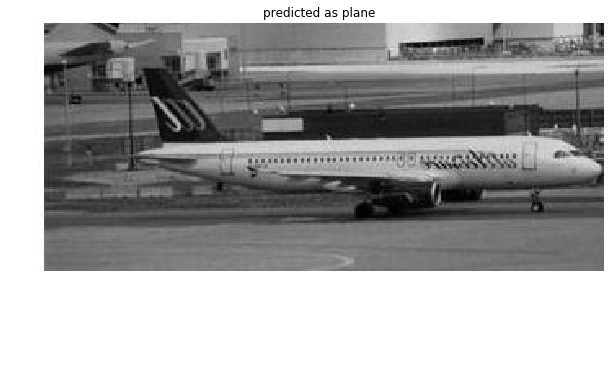

Predicting image number 255


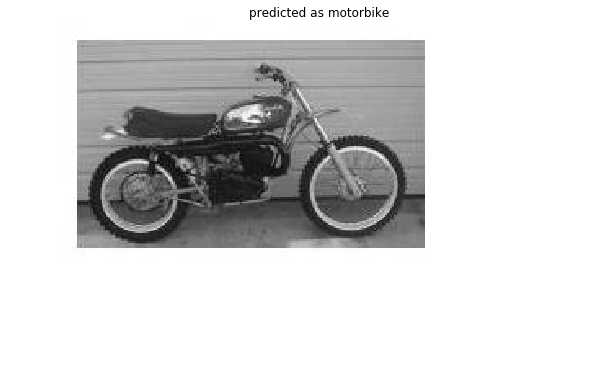

Predicting image number 256


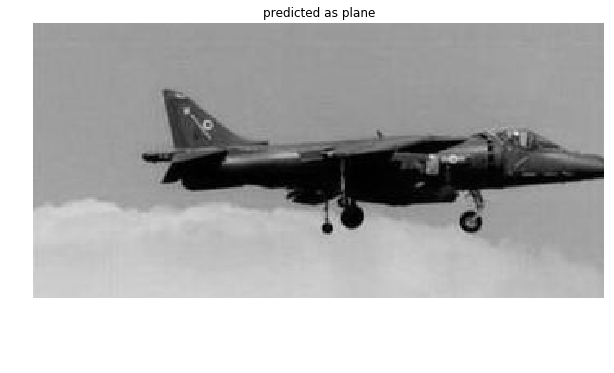

Predicting image number 257


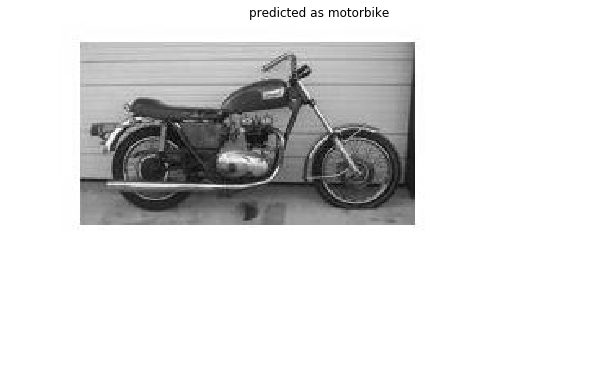

Predicting image number 258


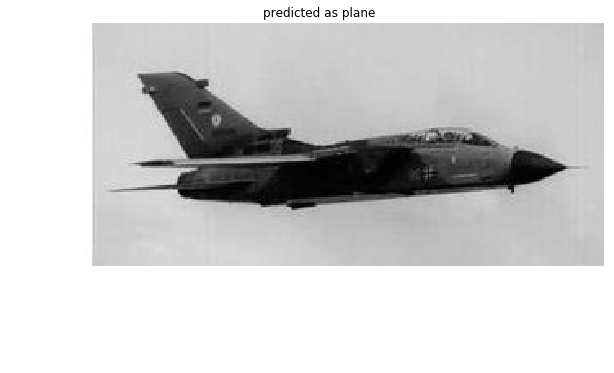

Predicting image number 259


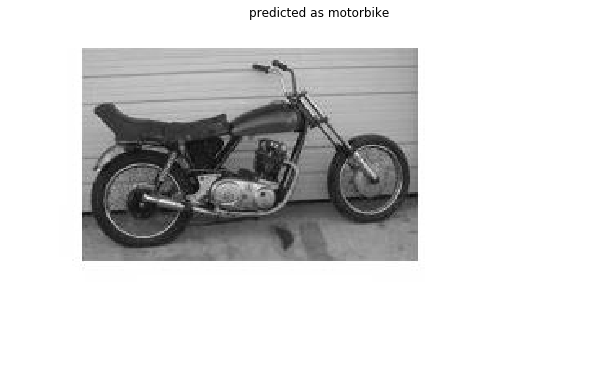

Predicting image number 260


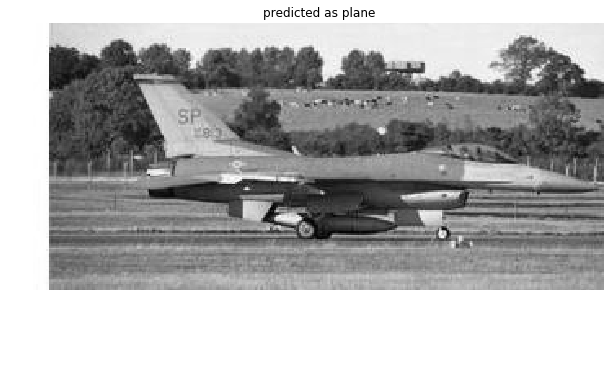

Predicting image number 261


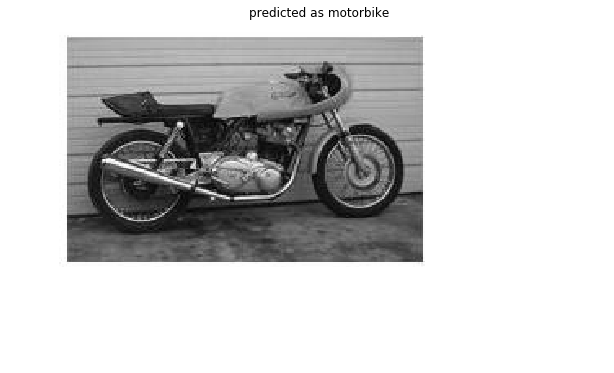

Predicting image number 262


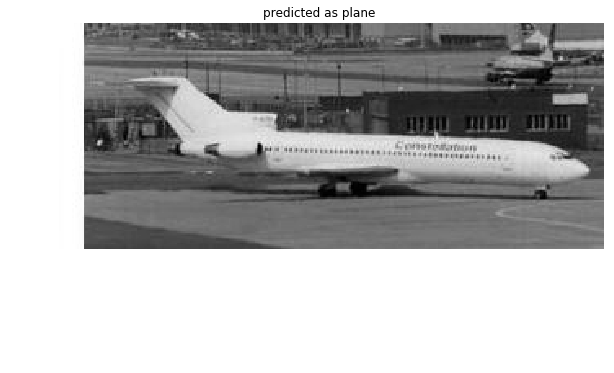

Predicting image number 263


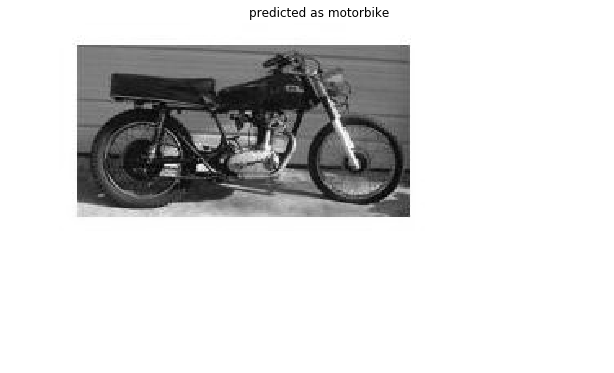

Predicting image number 264


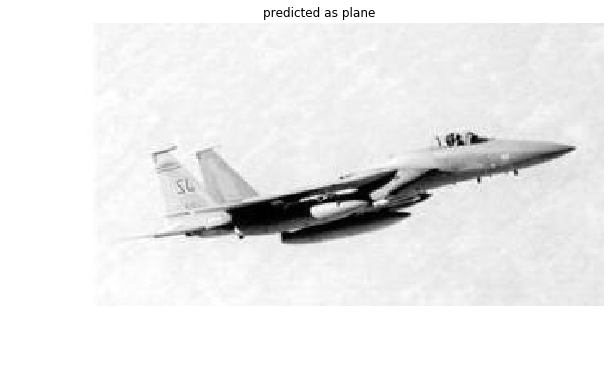

Predicting image number 265


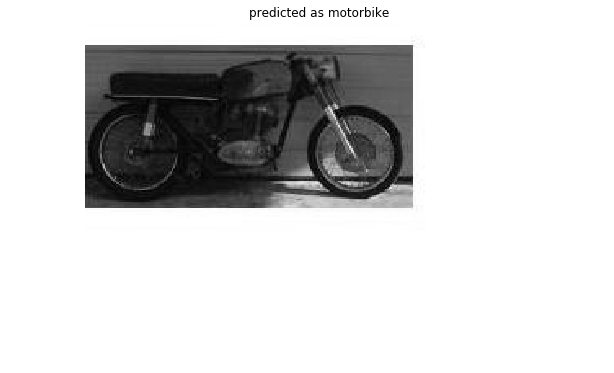

Predicting image number 266


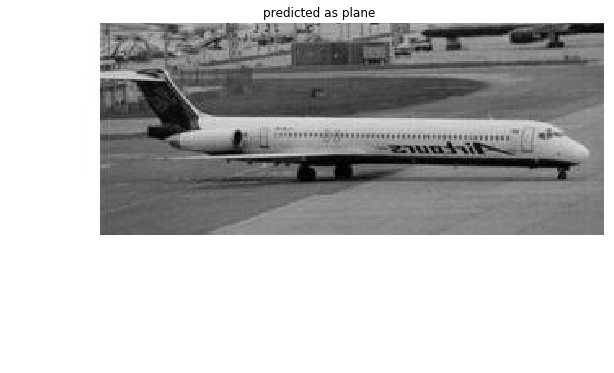

Predicting image number 267


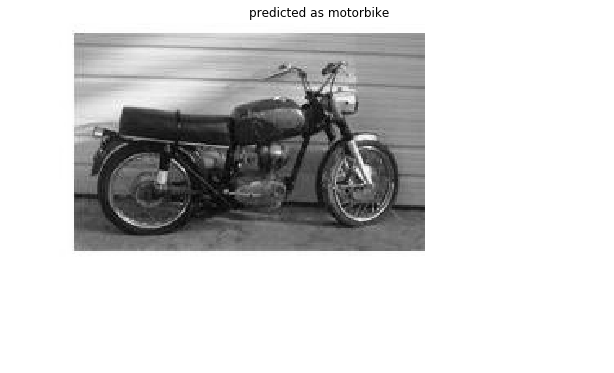

Predicting image number 268


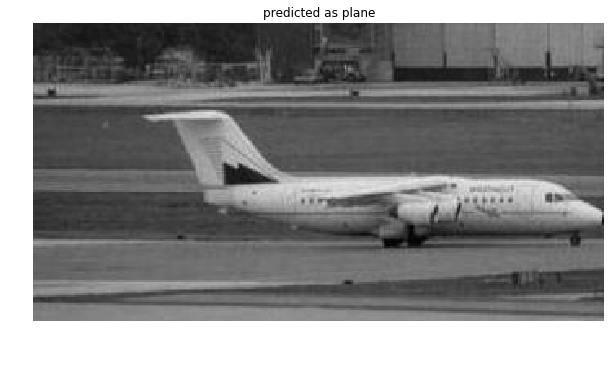

Predicting image number 269


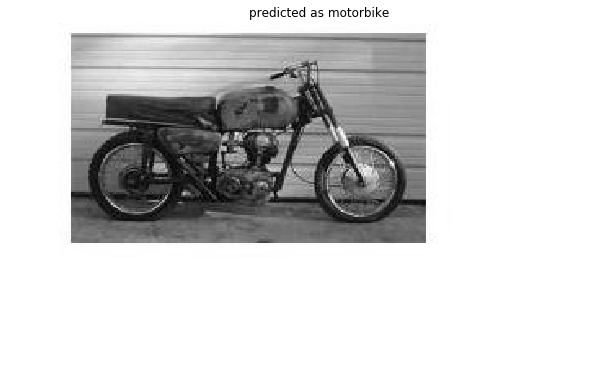

Predicting image number 270


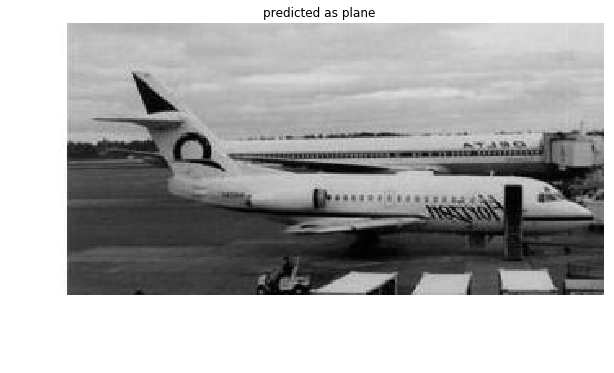

Predicting image number 271


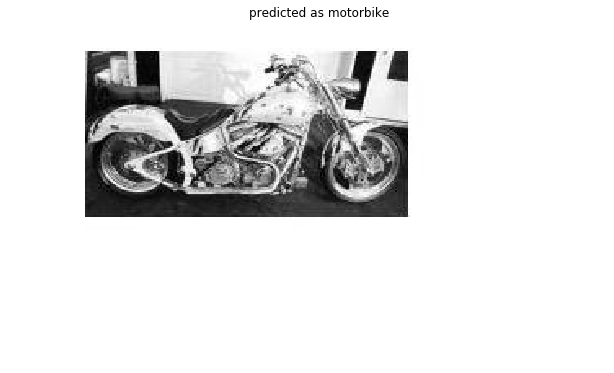

Predicting image number 272


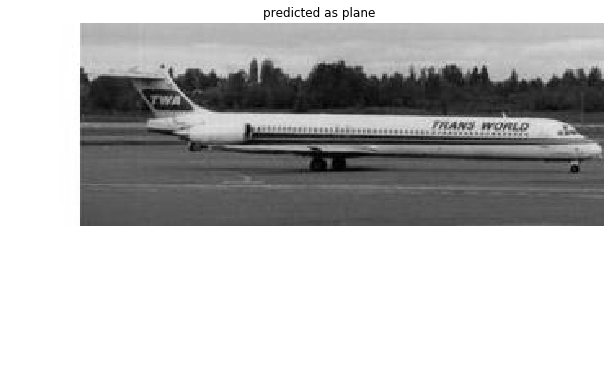

Predicting image number 273


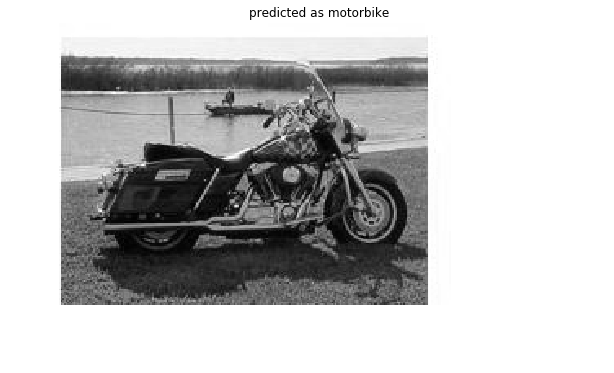

Predicting image number 274


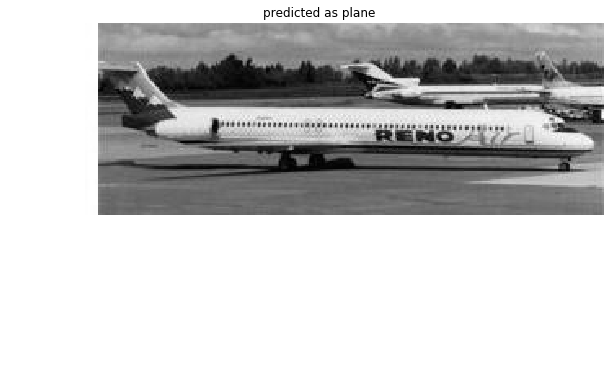

Predicting image number 275


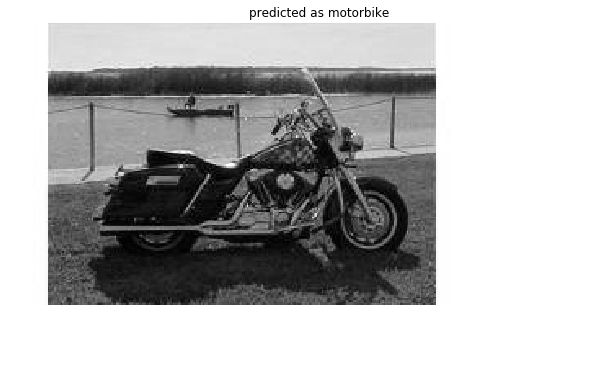

Predicting image number 276


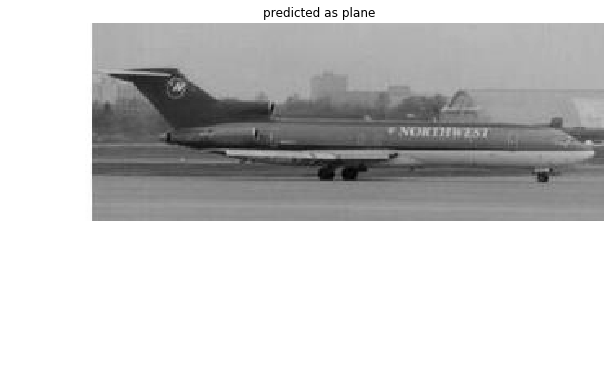

Predicting image number 277


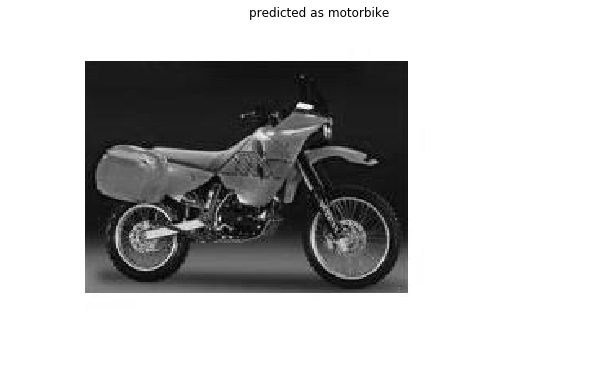

Predicting image number 278


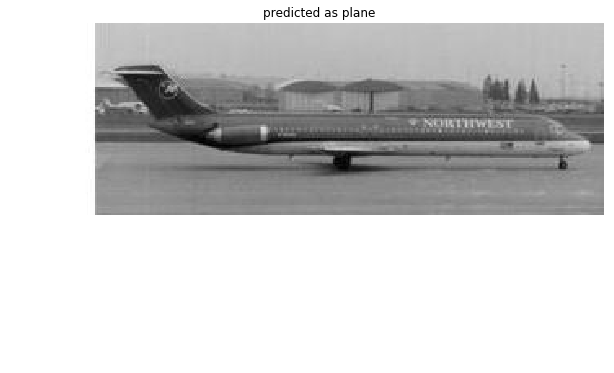

Predicting image number 279


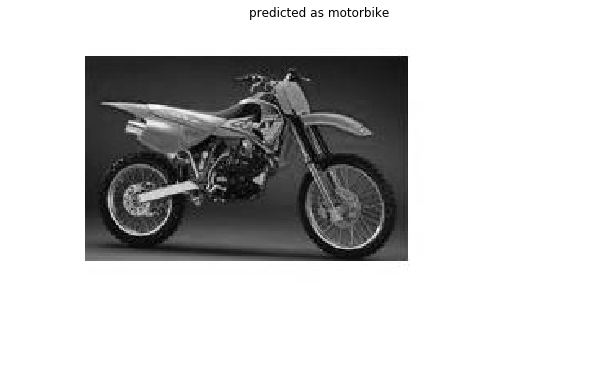

Predicting image number 280


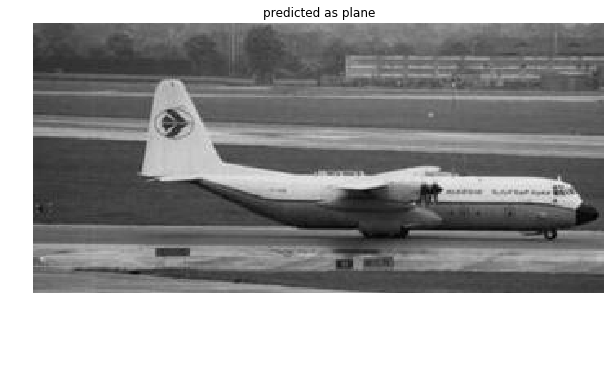

Predicting image number 281


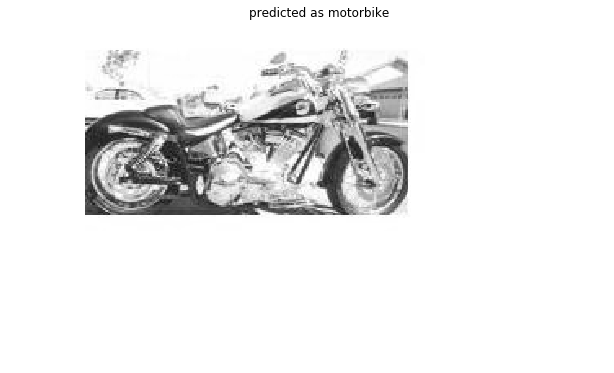

Predicting image number 282


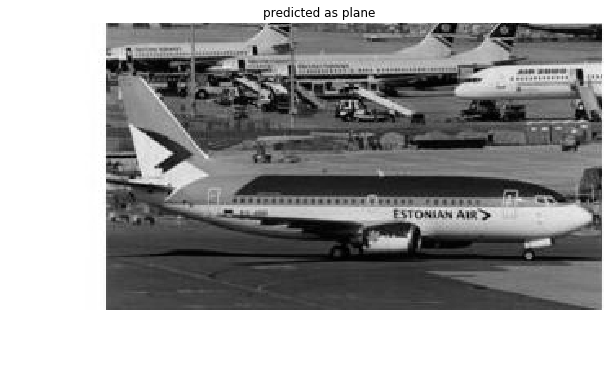

Predicting image number 283


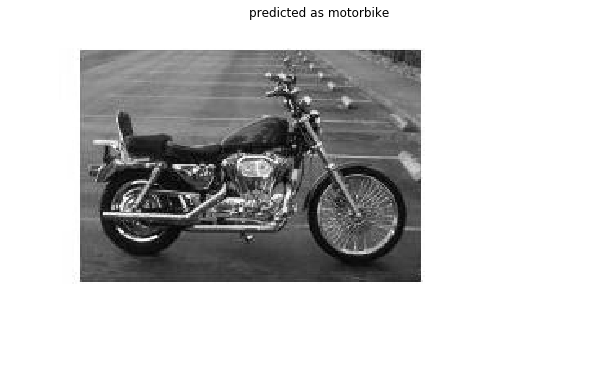

Predicting image number 284


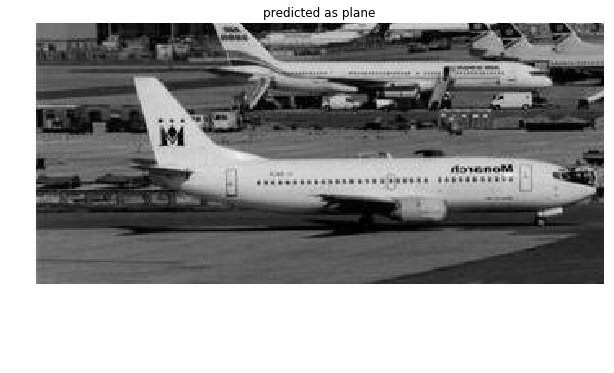

Predicting image number 285


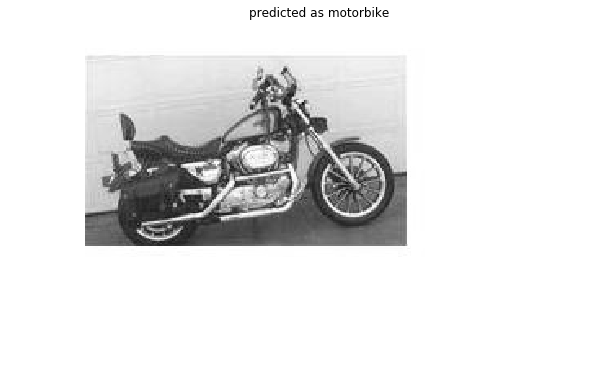

Predicting image number 286


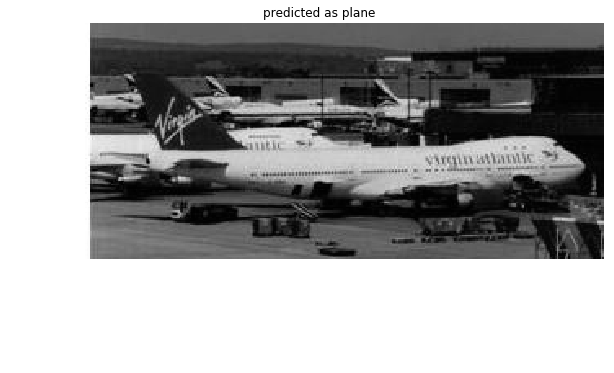

Predicting image number 287


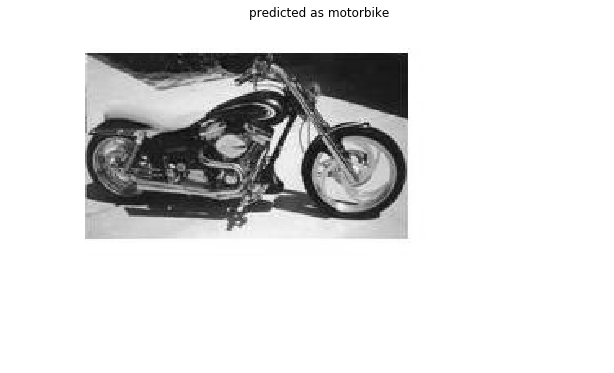

Predicting image number 288


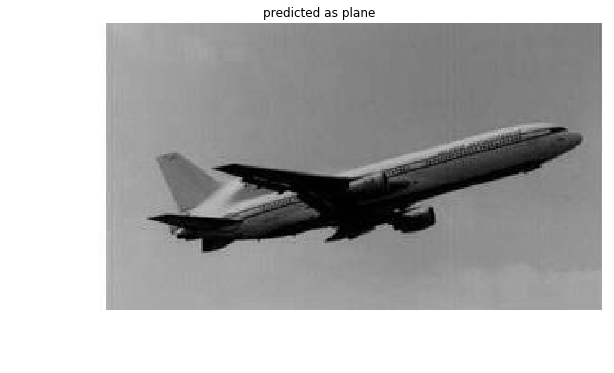

Predicting image number 289


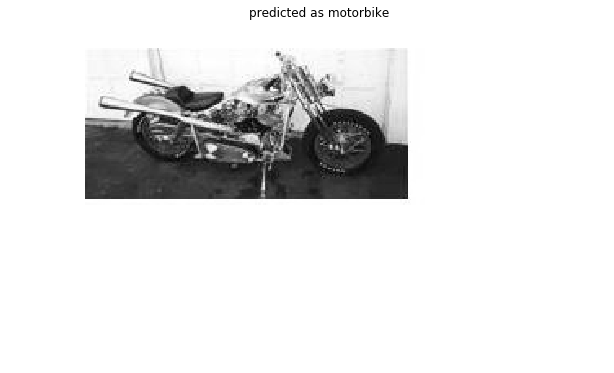

Predicting image number 290


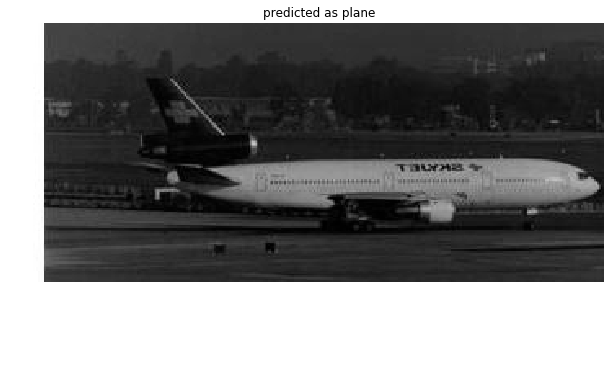

Predicting image number 291


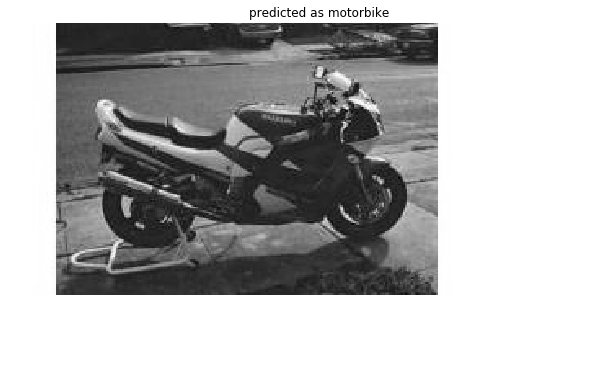

Predicting image number 292


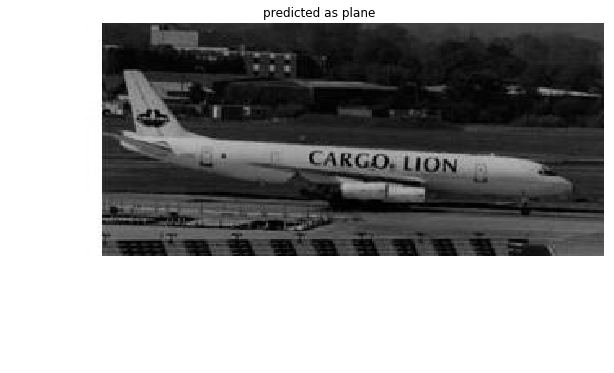

Predicting image number 293


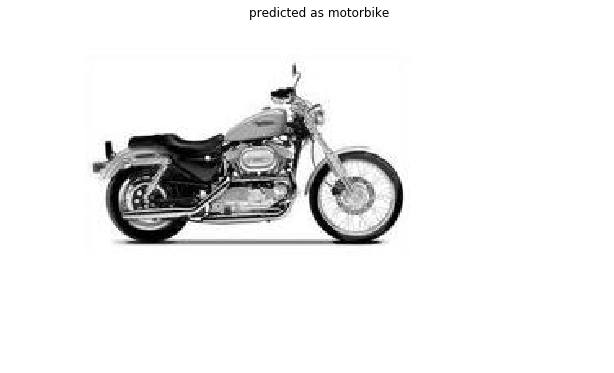

Predicting image number 294


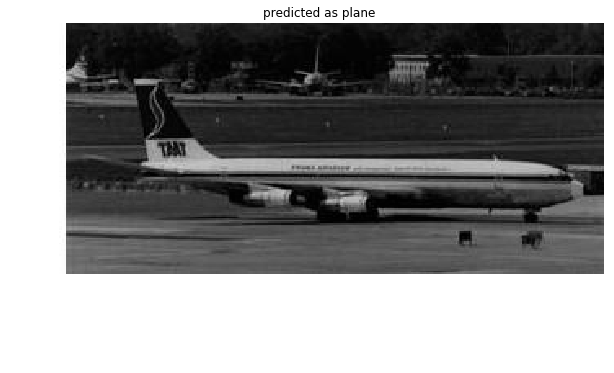

Predicting image number 295


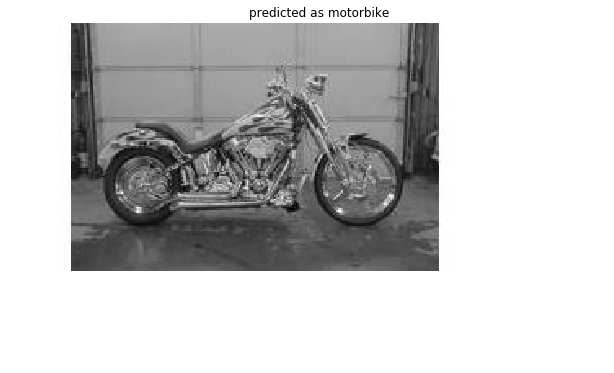

Predicting image number 296


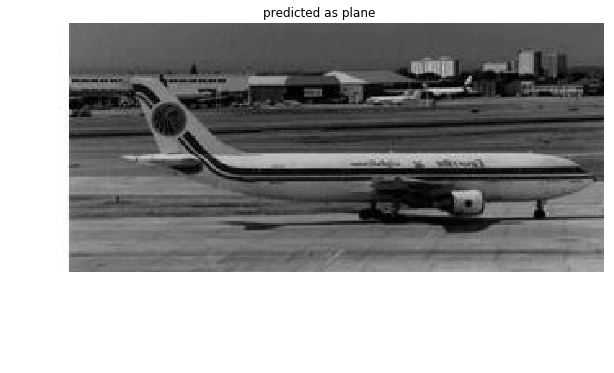

Predicting image number 297


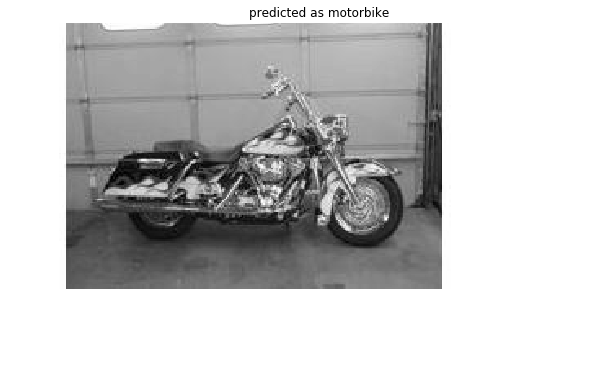

Predicting image number 298


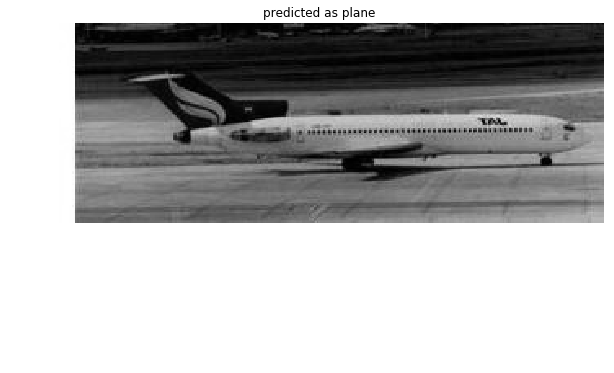

Predicting image number 299


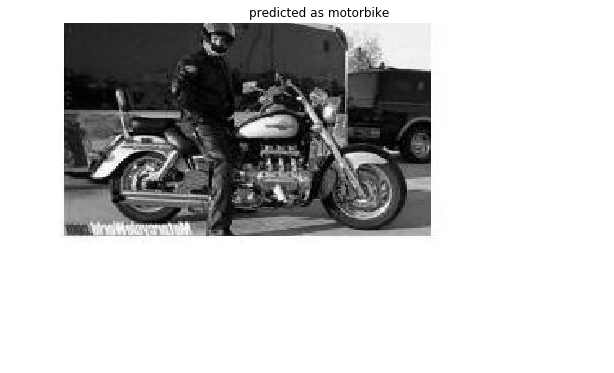

Predicting image number 300


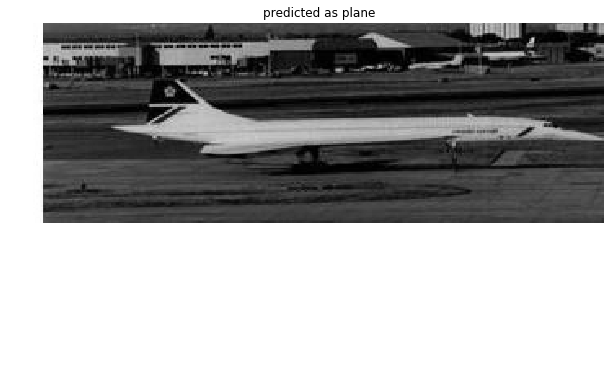

Predicting image number 301


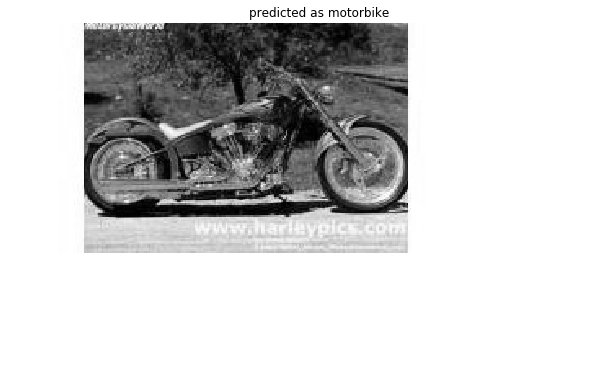

Predicting image number 302


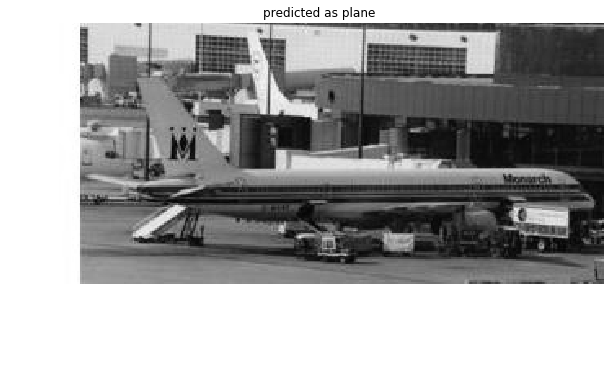

Predicting image number 303


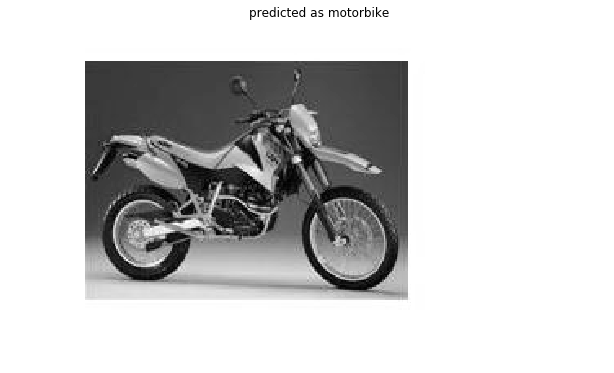

Predicting image number 304


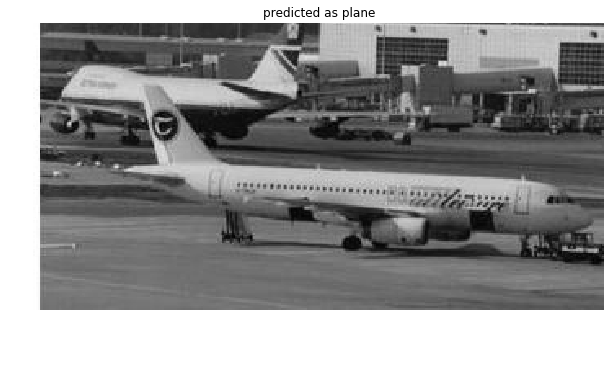

Predicting image number 305


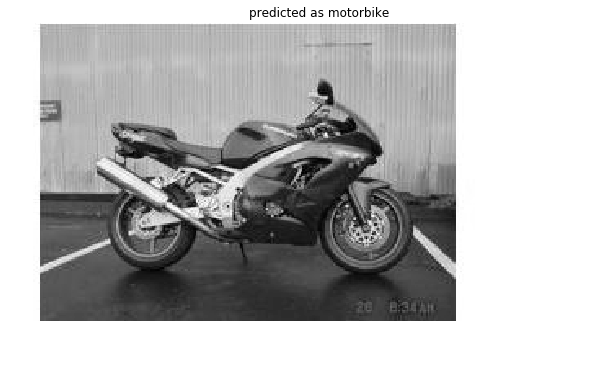

Predicting image number 306


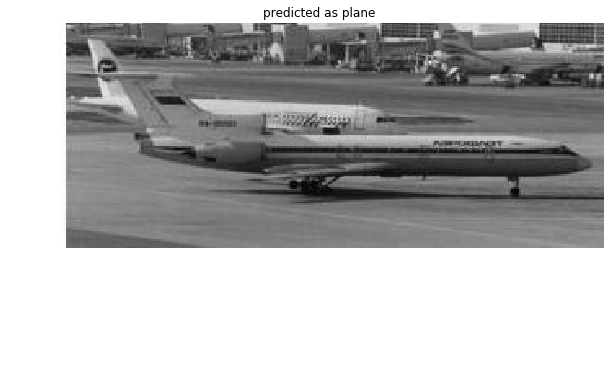

Predicting image number 307


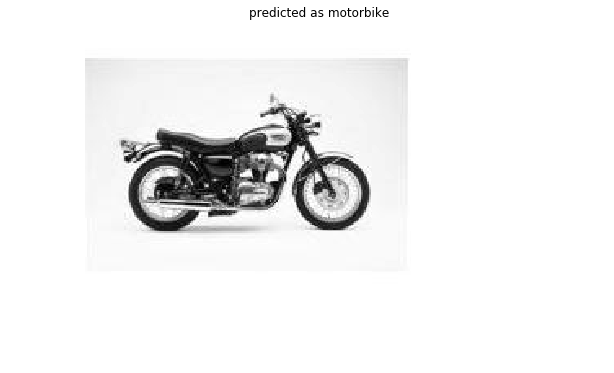

Predicting image number 308


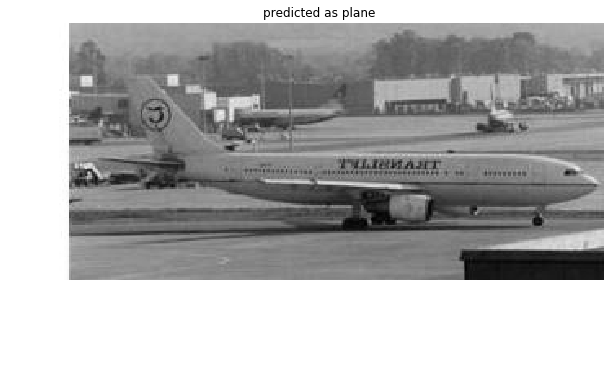

Predicting image number 309


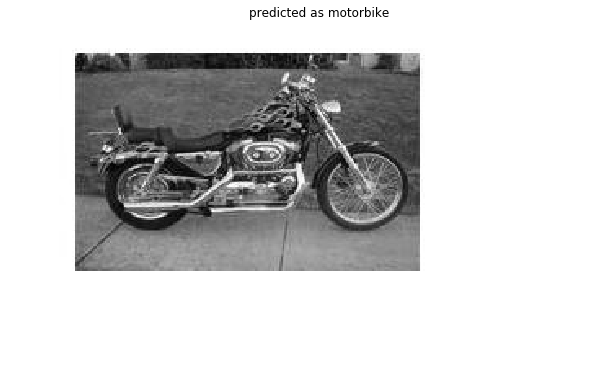

Predicting image number 310


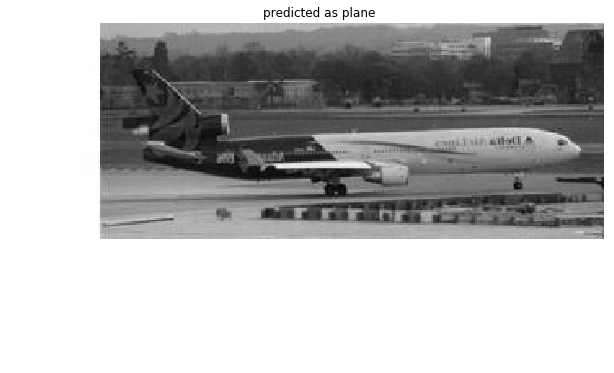

Predicting image number 311


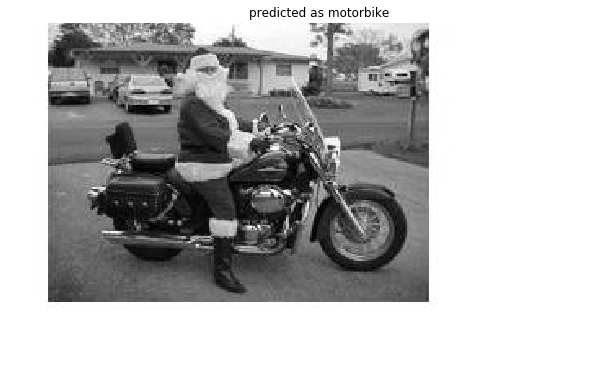

Predicting image number 312


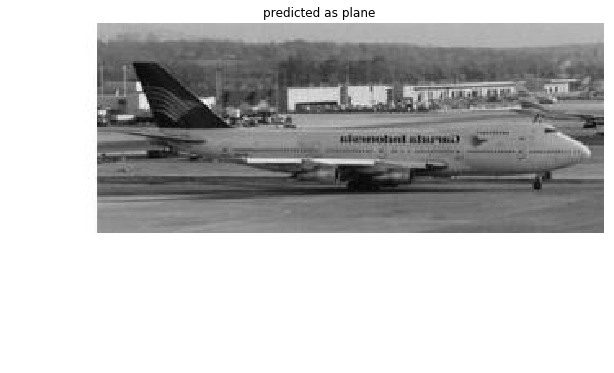

Predicting image number 313


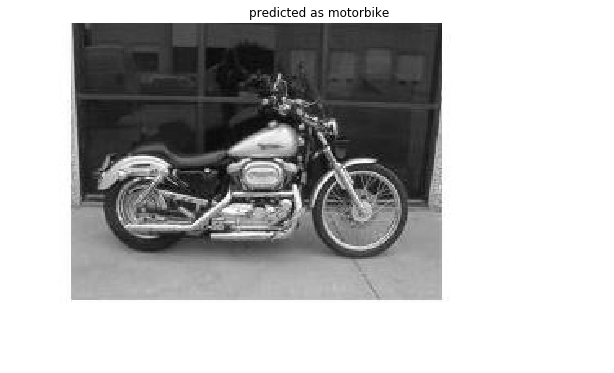

Predicting image number 314


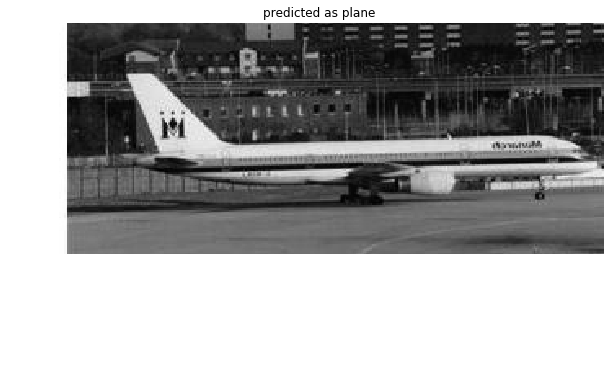

Predicting image number 315


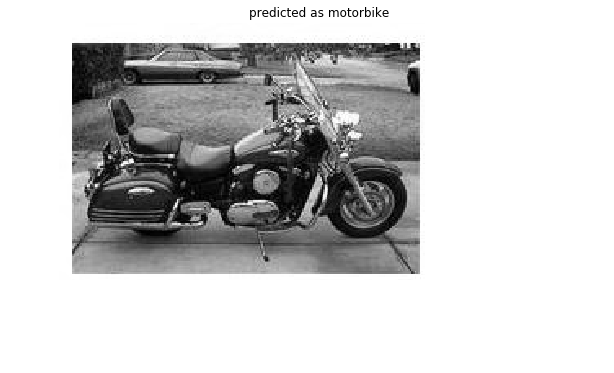

Predicting image number 316


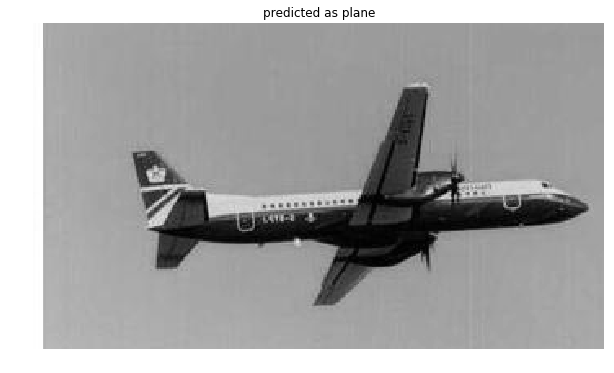

Predicting image number 317


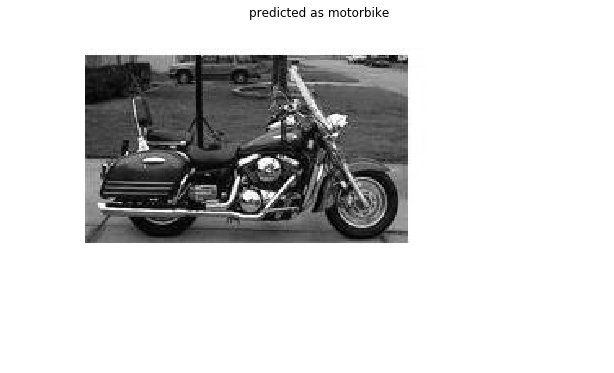

Predicting image number 318


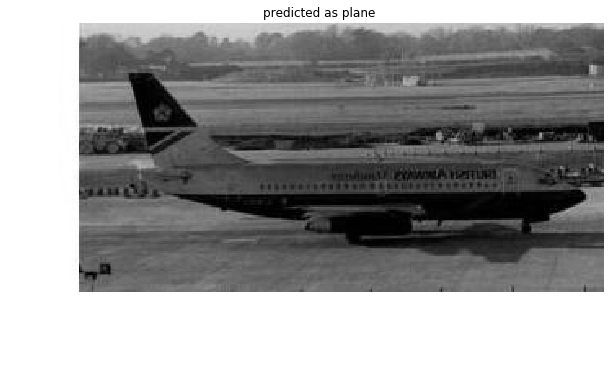

Predicting image number 319


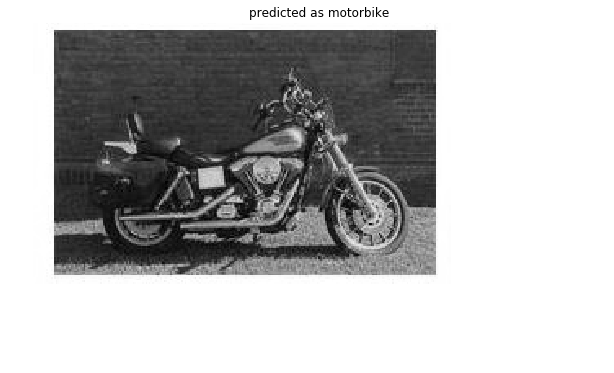

Predicting image number 320


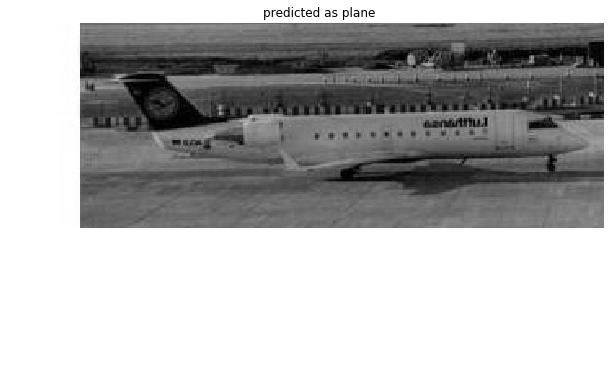

Predicting image number 321


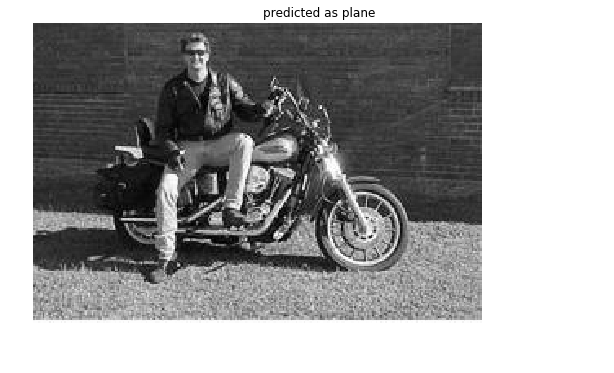

Predicting image number 322


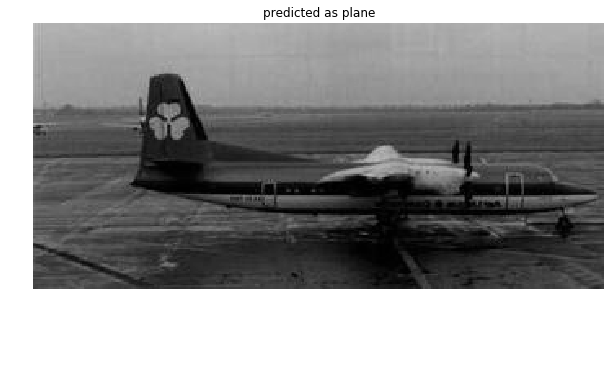

Predicting image number 323


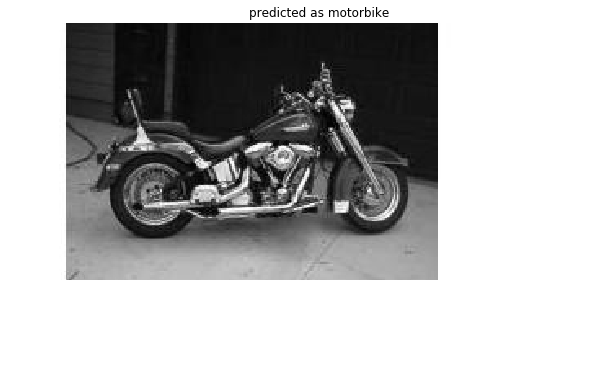

Predicting image number 324


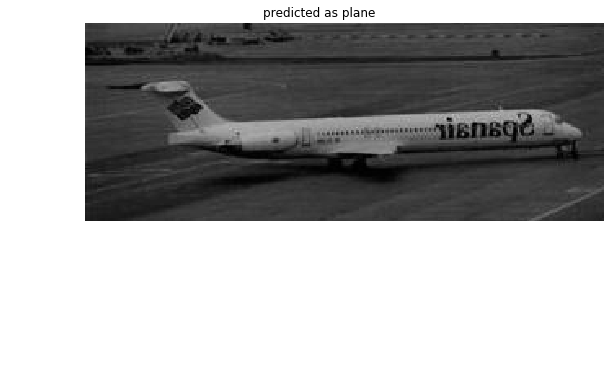

Predicting image number 325


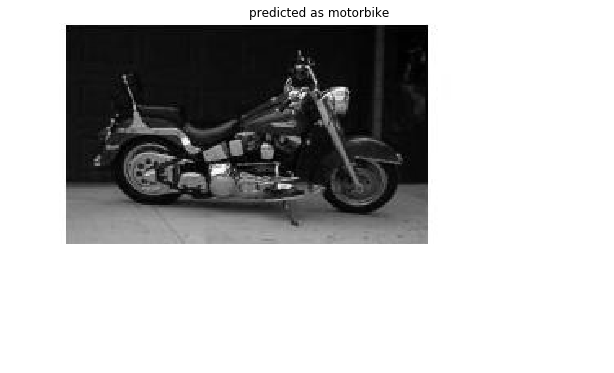

Predicting image number 326


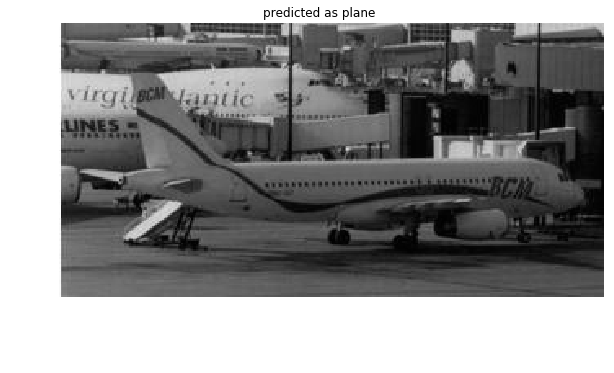

Predicting image number 327


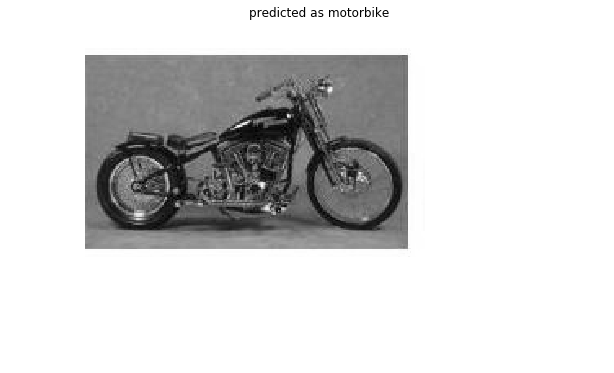

Predicting image number 328


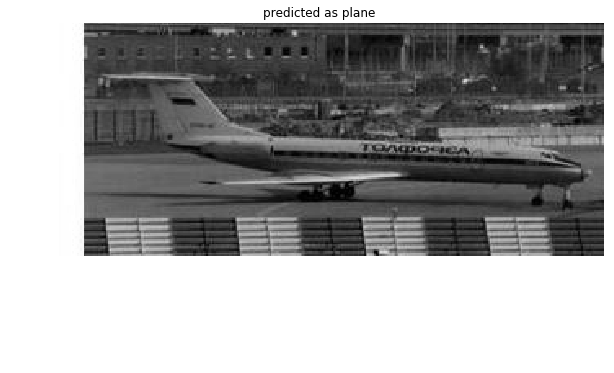

Predicting image number 329


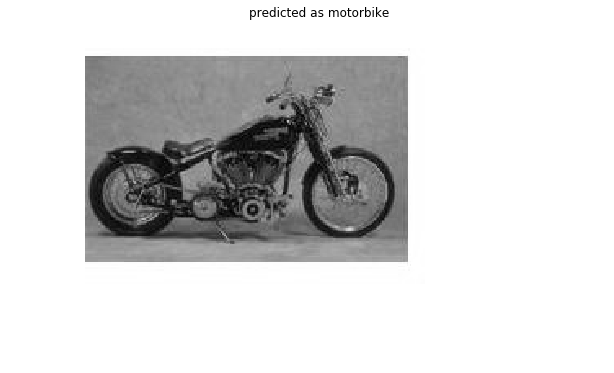

Predicting image number 330


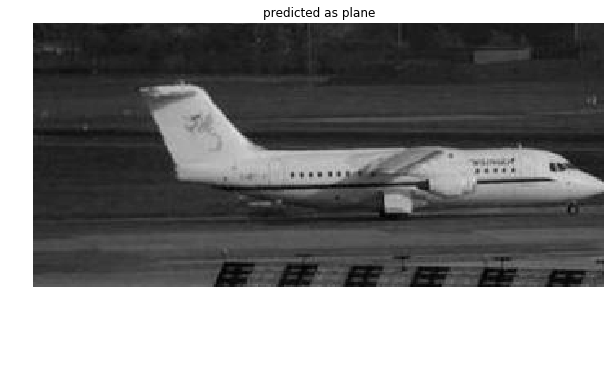

Predicting image number 331


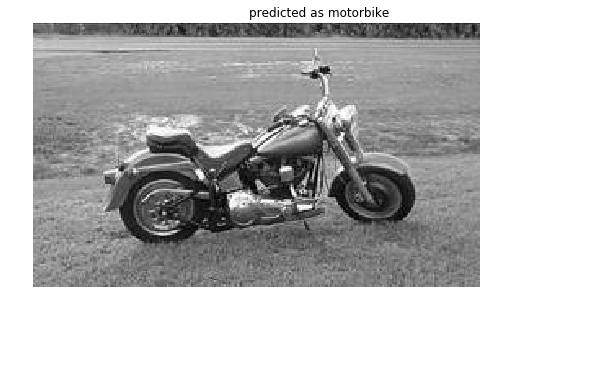

Predicting image number 332


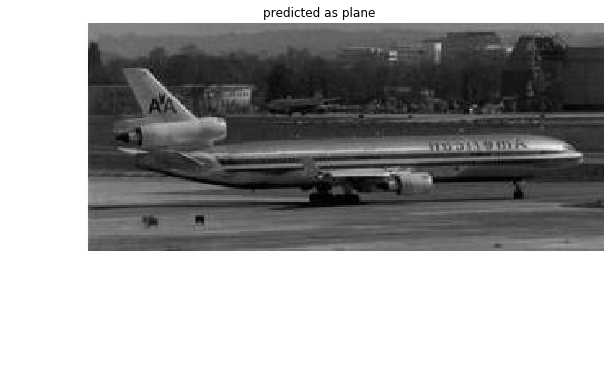

Predicting image number 333


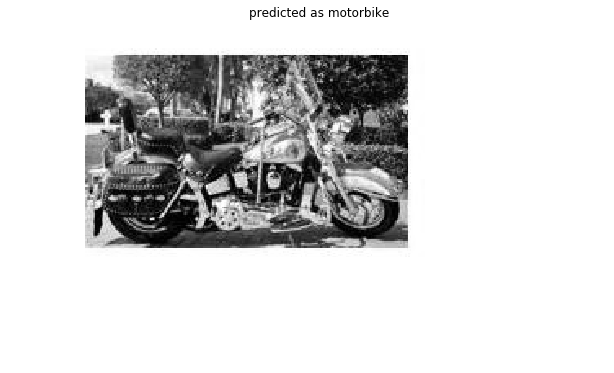

Predicting image number 334


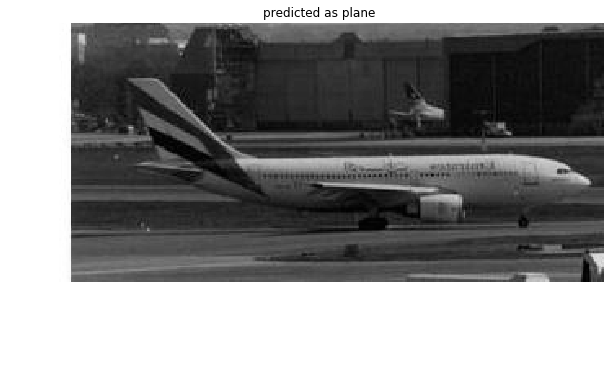

Predicting image number 335


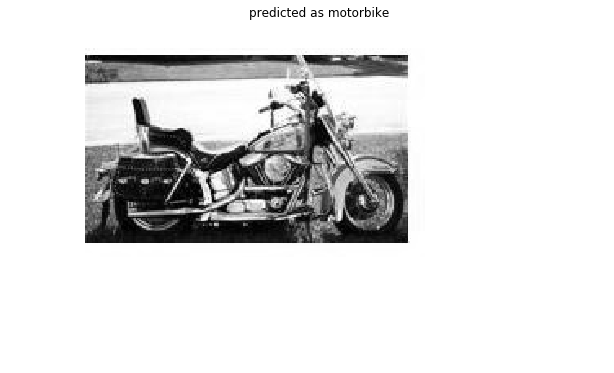

Predicting image number 336


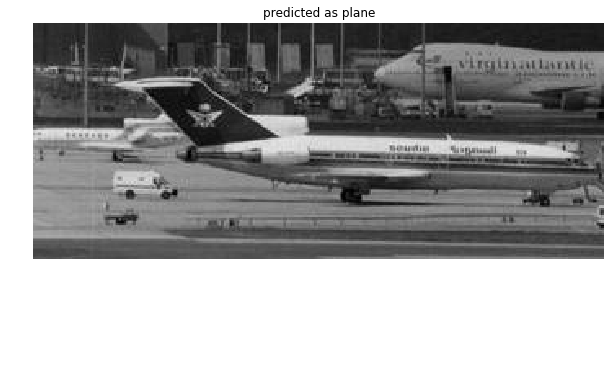

Predicting image number 337


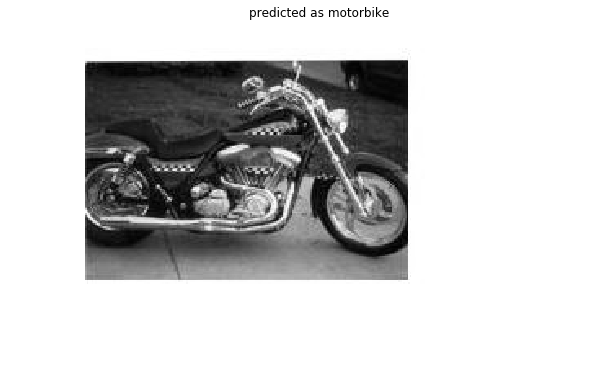

Predicting image number 338


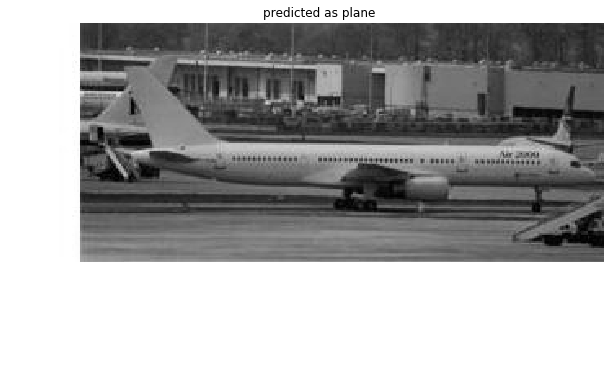

Predicting image number 339


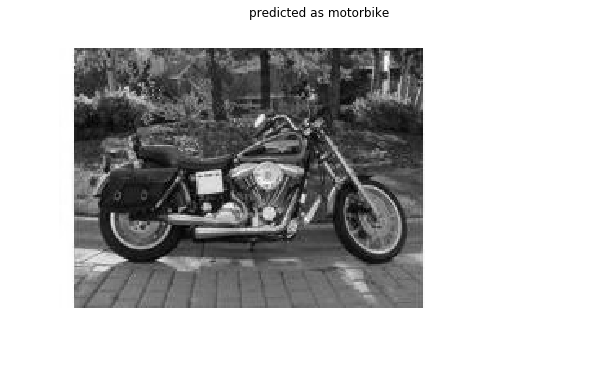

Predicting image number 340


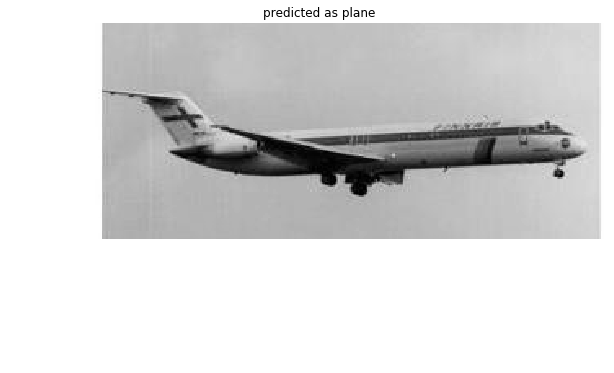

Predicting image number 341


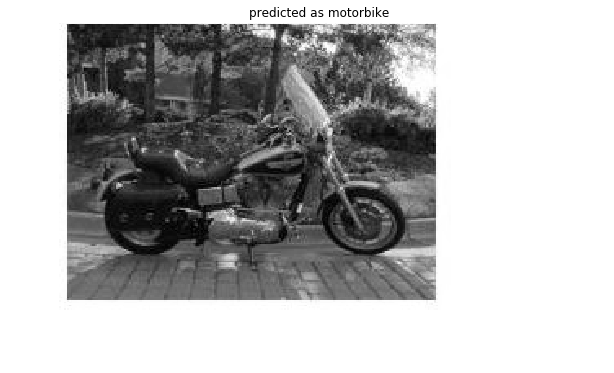

Predicting image number 342


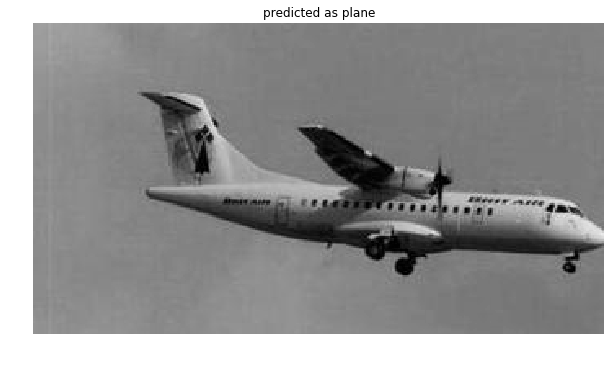

Predicting image number 343


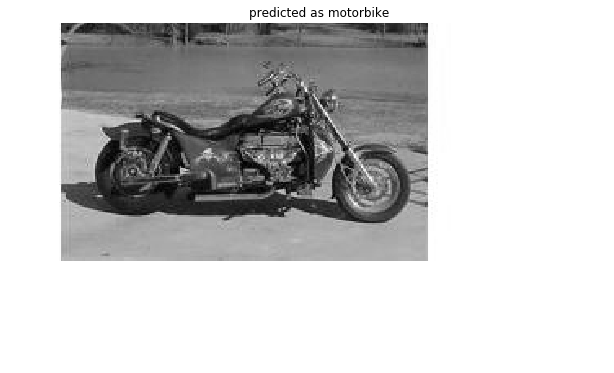

Predicting image number 344


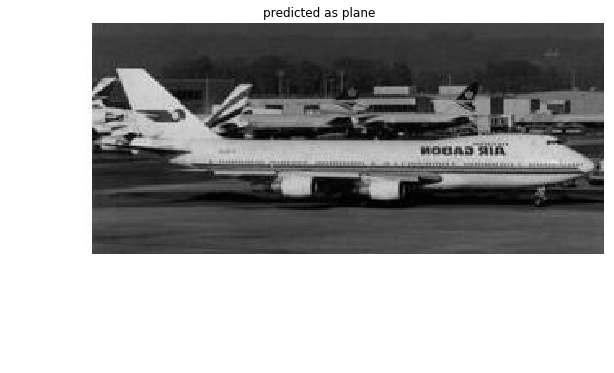

Predicting image number 345


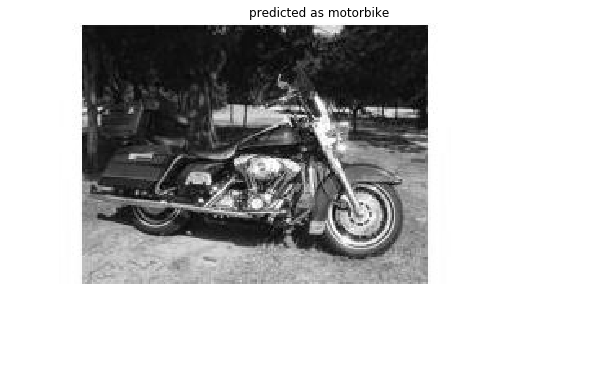

Predicting image number 346


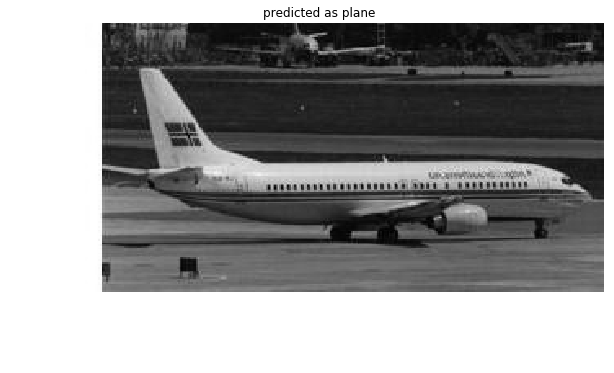

Predicting image number 347


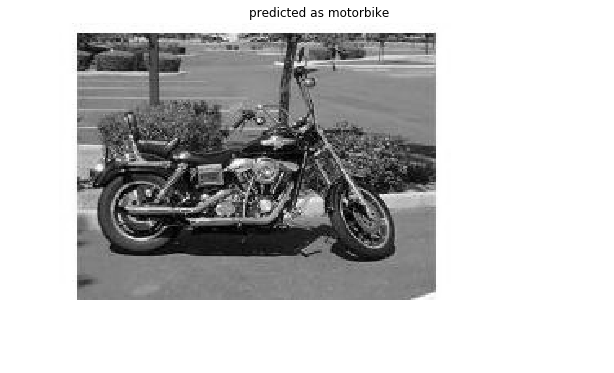

Predicting image number 348


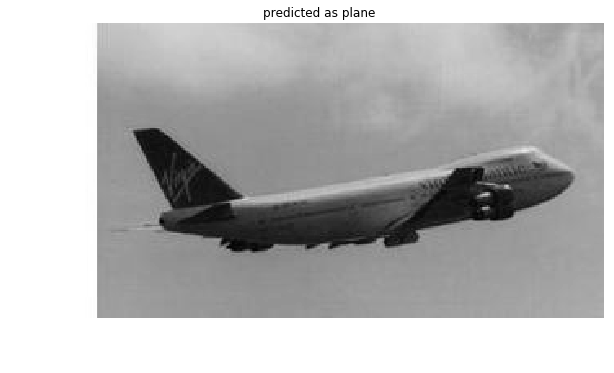

Predicting image number 349


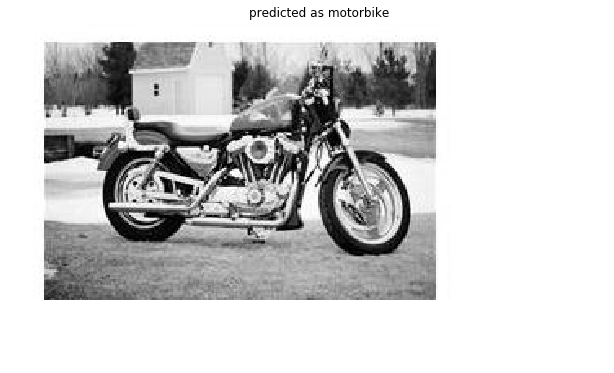

Predicting image number 350


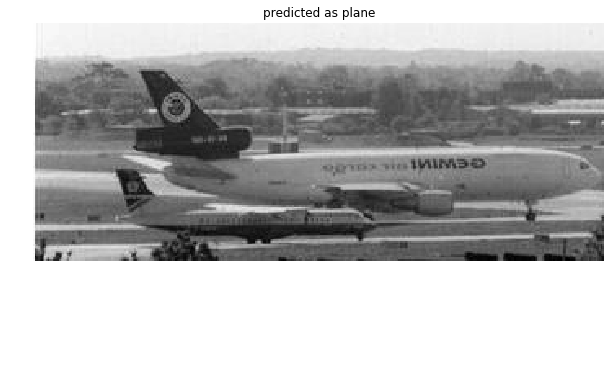

Predicting image number 351


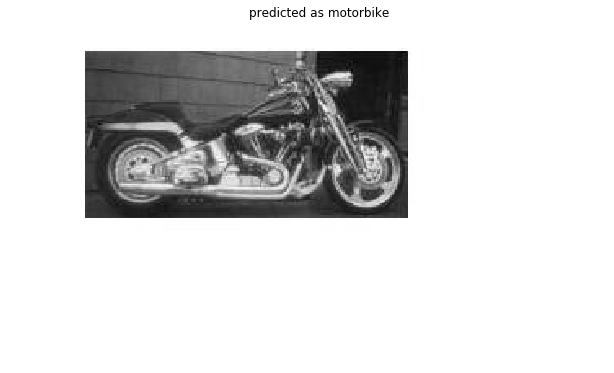

Predicting image number 352


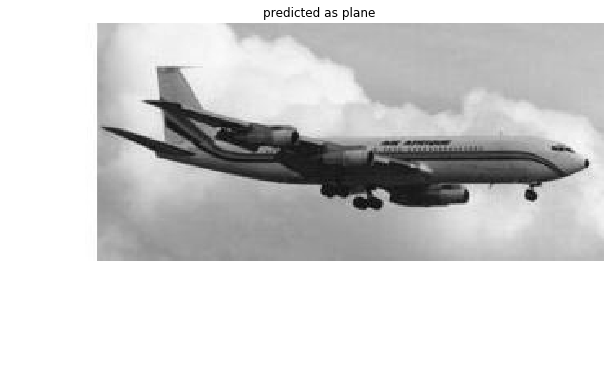

Predicting image number 353


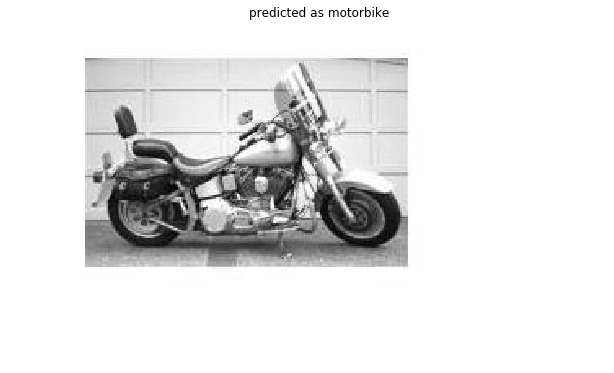

Predicting image number 354


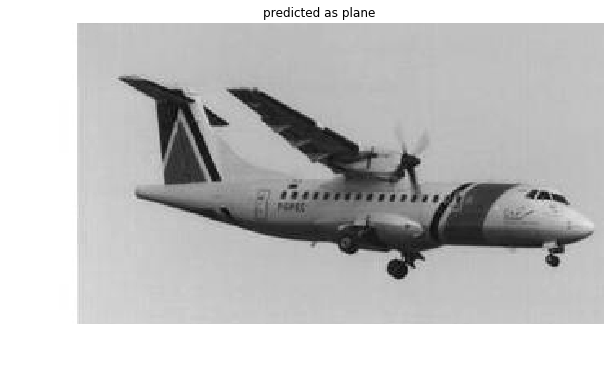

Predicting image number 355


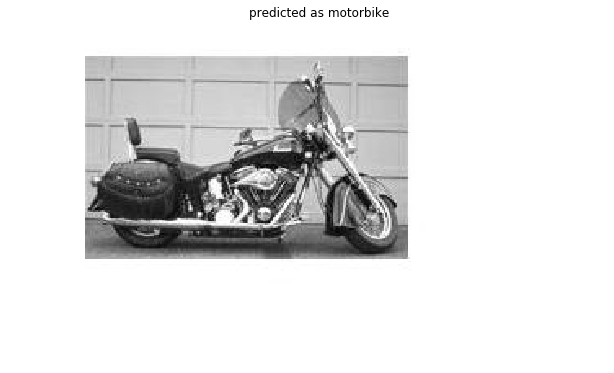

Predicting image number 356


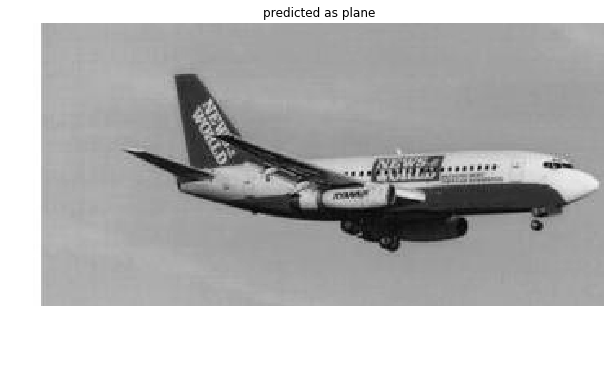

Predicting image number 357


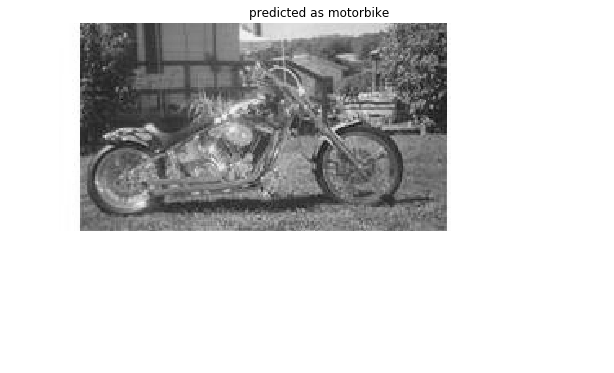

Predicting image number 358


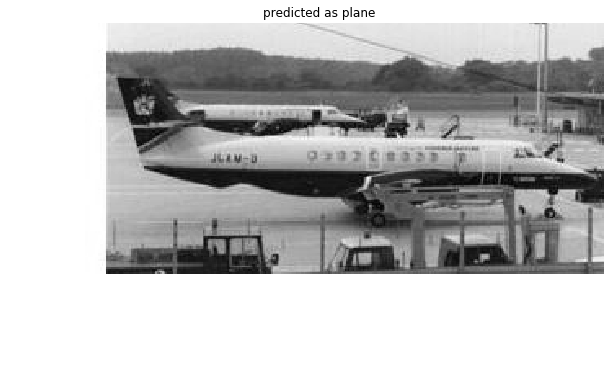

Predicting image number 359


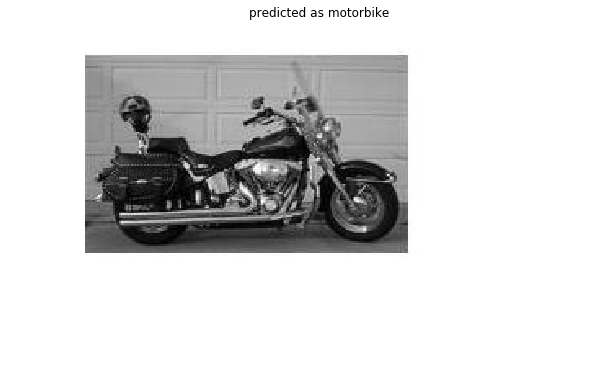

Predicting image number 360


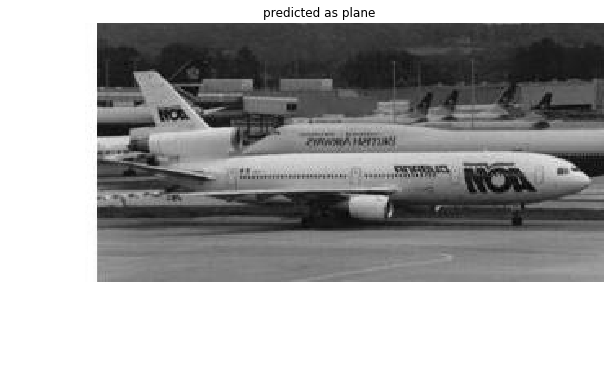

Predicting image number 361


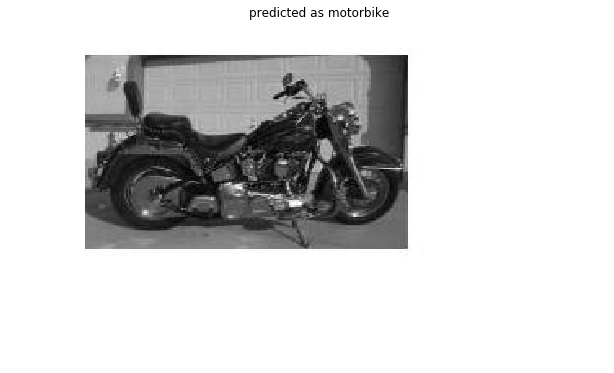

Predicting image number 362


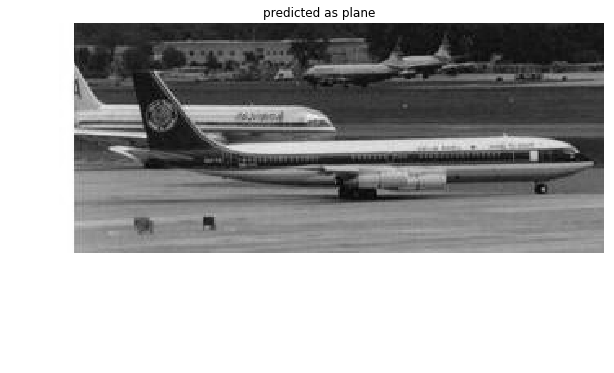

Predicting image number 363


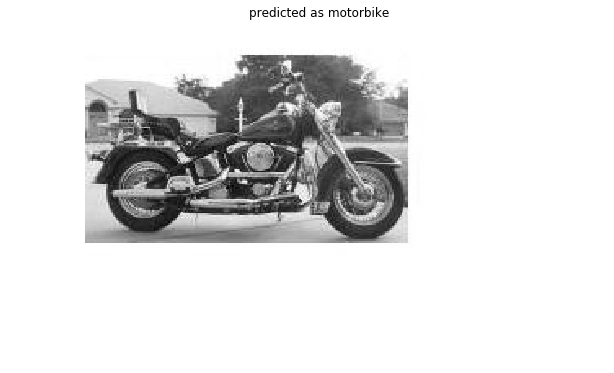

Predicting image number 364


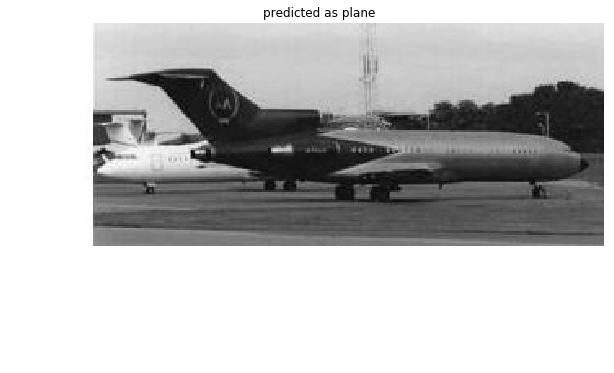

Predicting image number 365


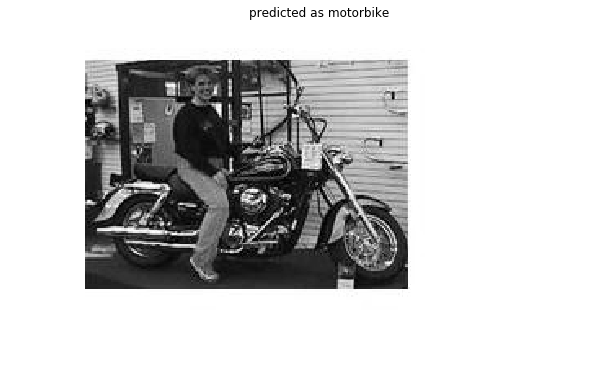

Predicting image number 366


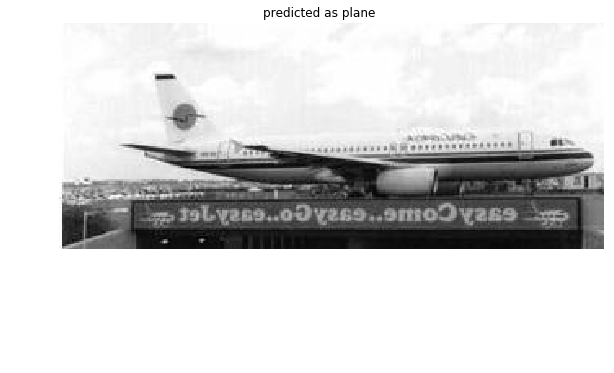

Predicting image number 367


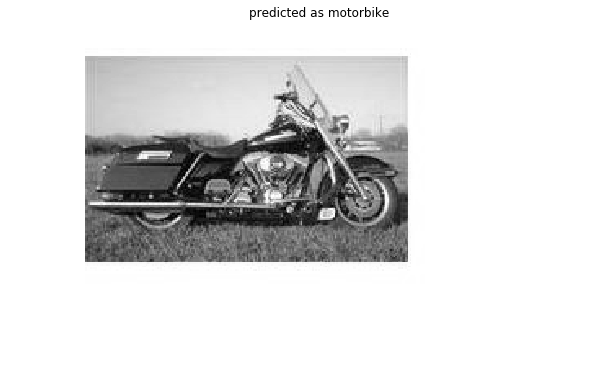

Predicting image number 368


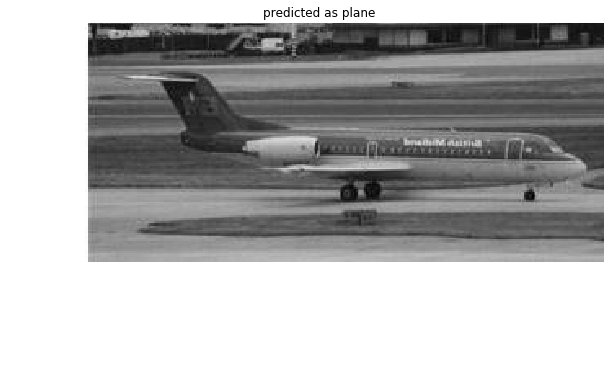

Predicting image number 369


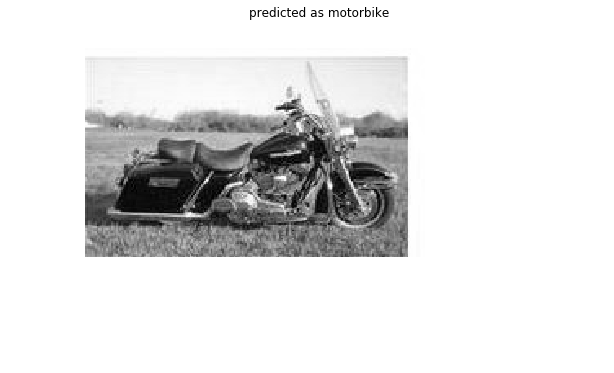

Predicting image number 370


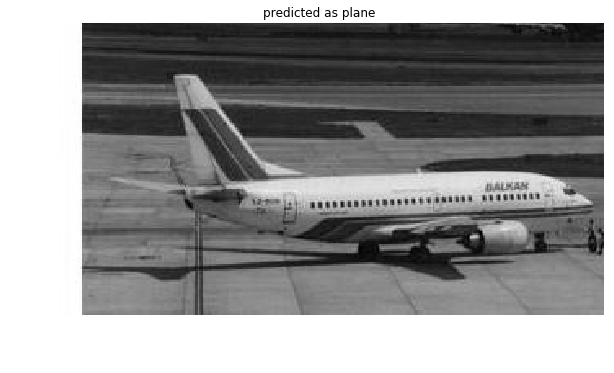

Predicting image number 371


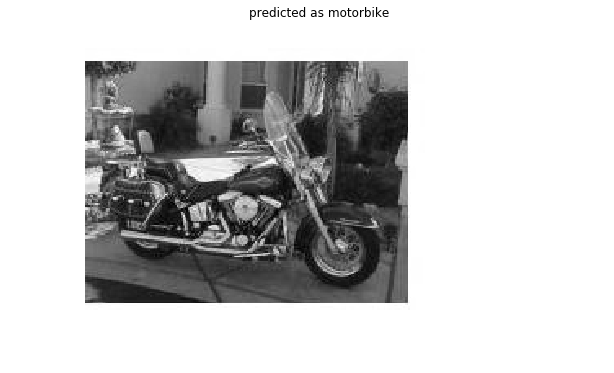

Predicting image number 372


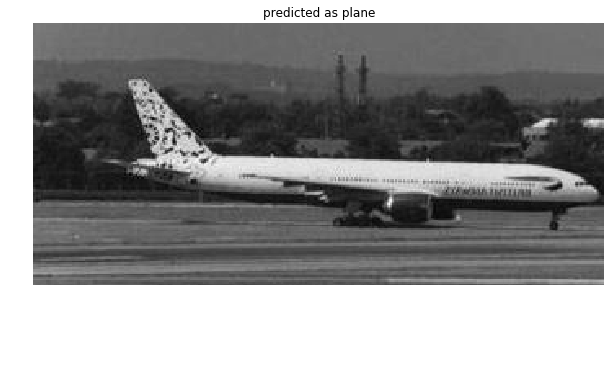

Predicting image number 373


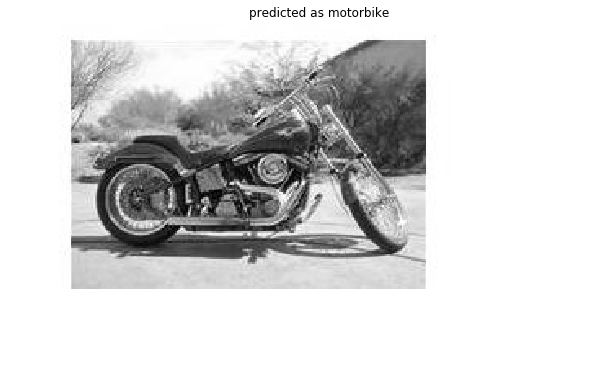

Predicting image number 374


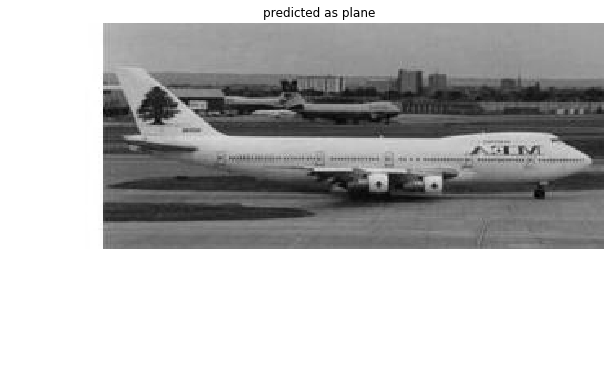

Predicting image number 375


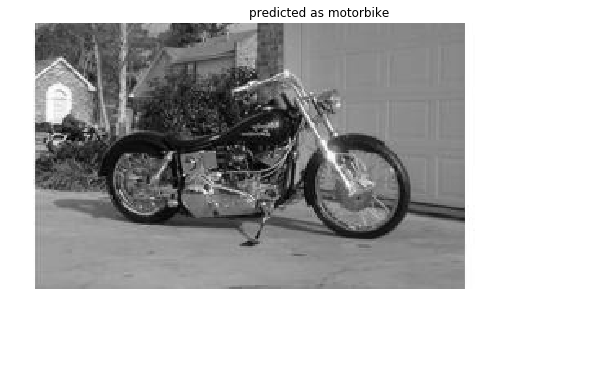

Predicting image number 376


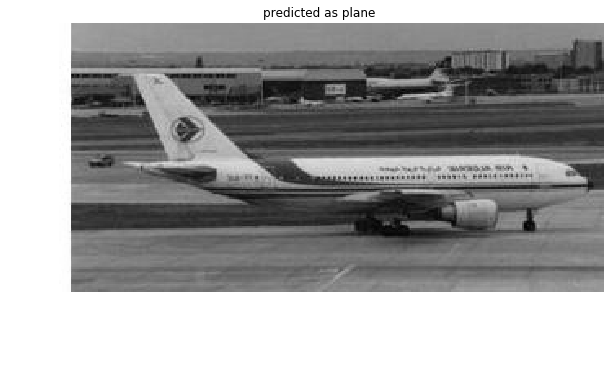

Predicting image number 377


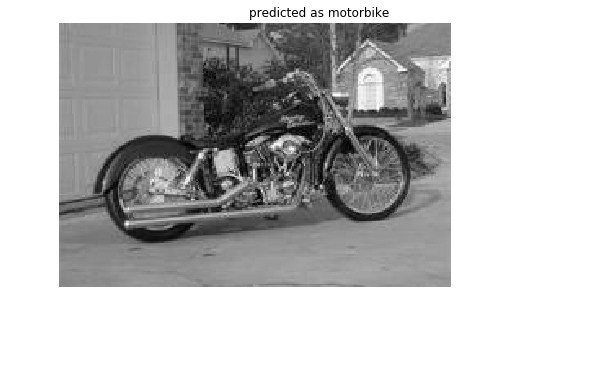

Predicting image number 378


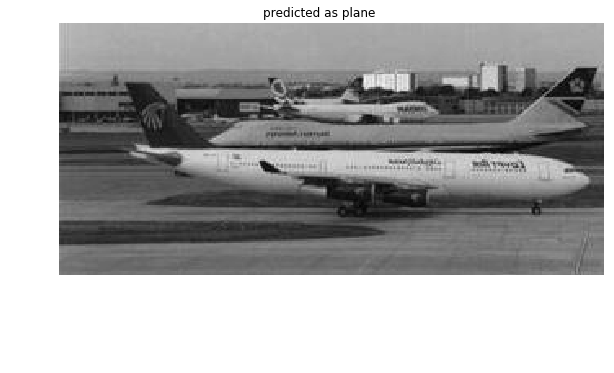

Predicting image number 379


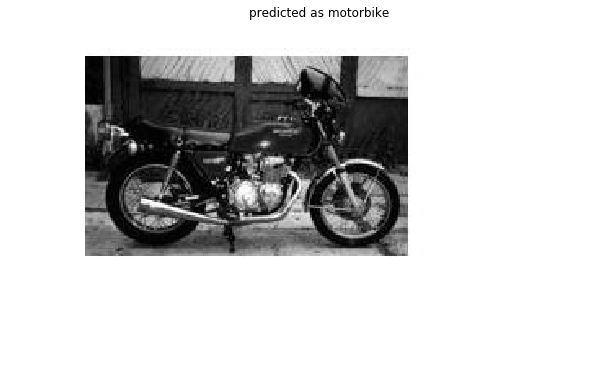

Predicting image number 380


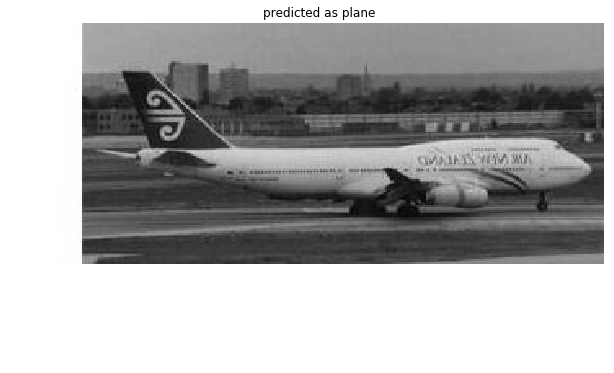

Predicting image number 381


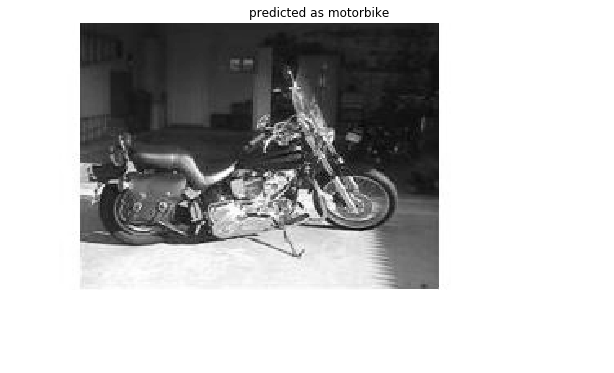

Predicting image number 382


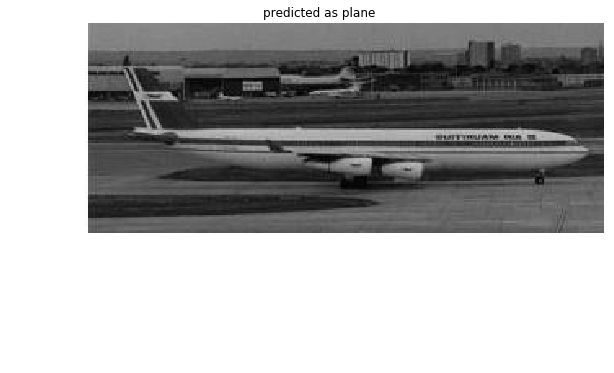

Predicting image number 383


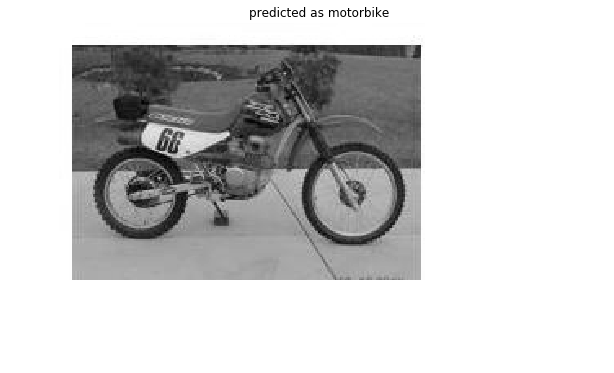

Predicting image number 384


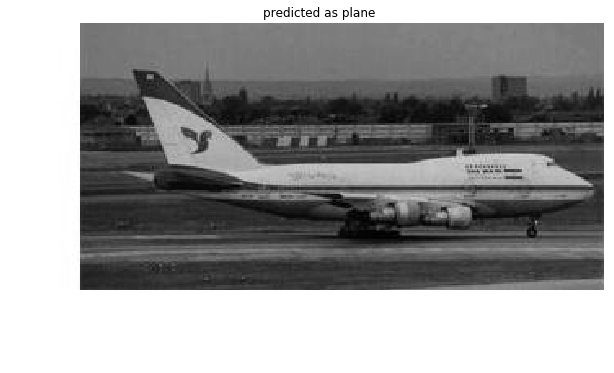

Predicting image number 385


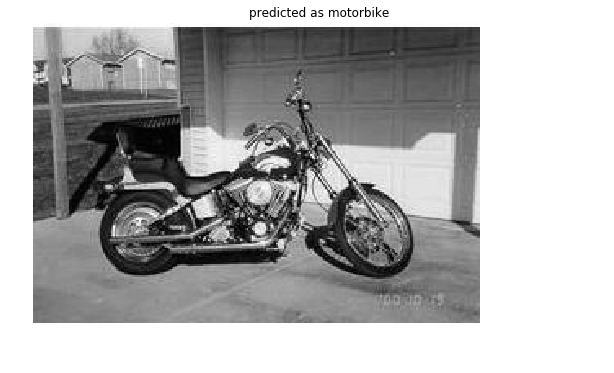

Predicting image number 386


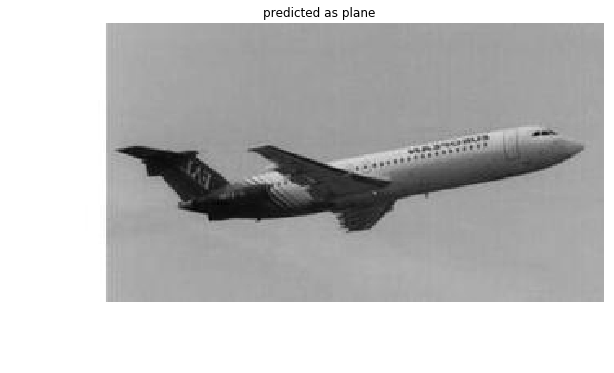

Predicting image number 387


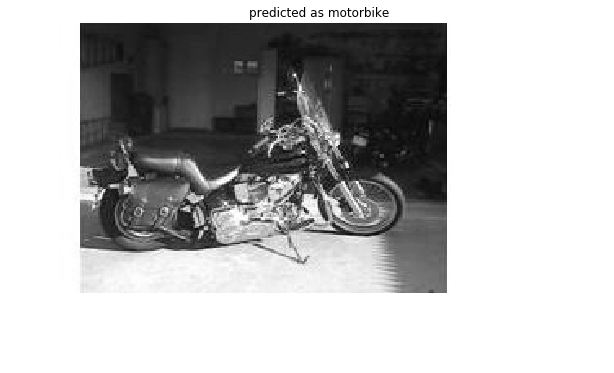

Predicting image number 388


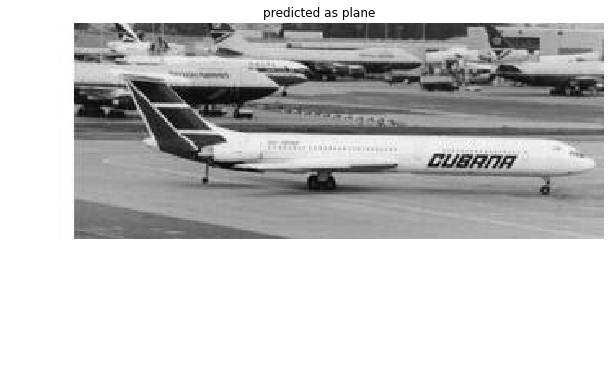

Predicting image number 389


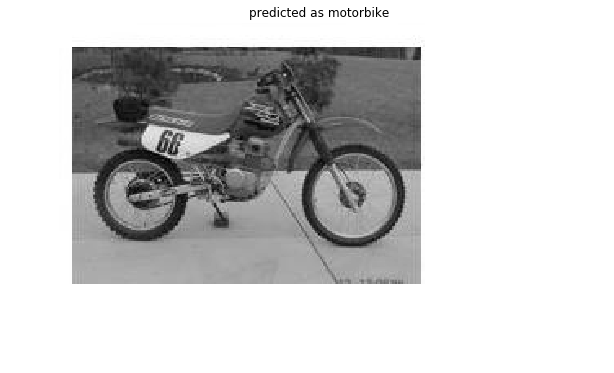

Predicting image number 390


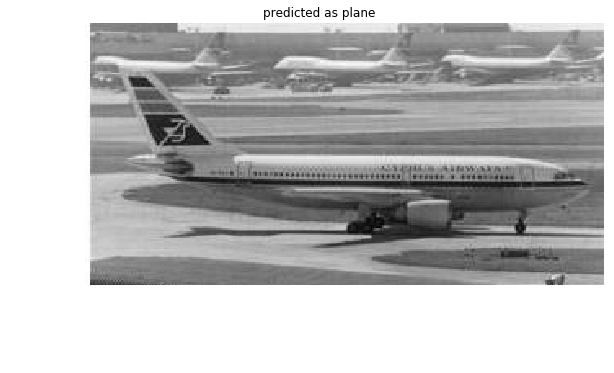

Predicting image number 391


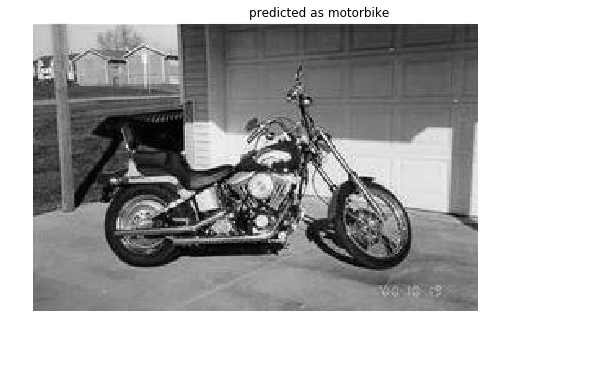

Predicting image number 392


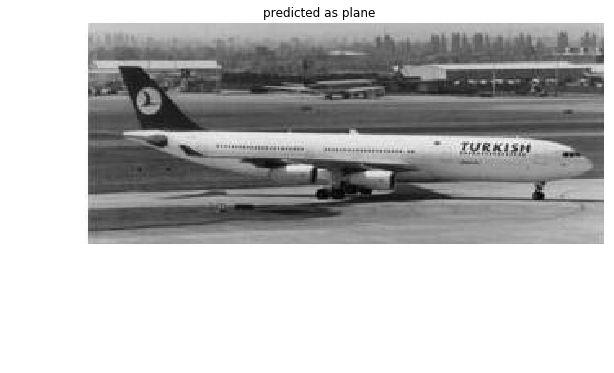

Predicting image number 393


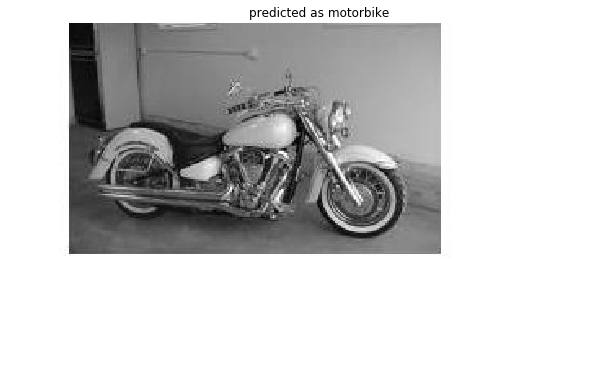

Predicting image number 394


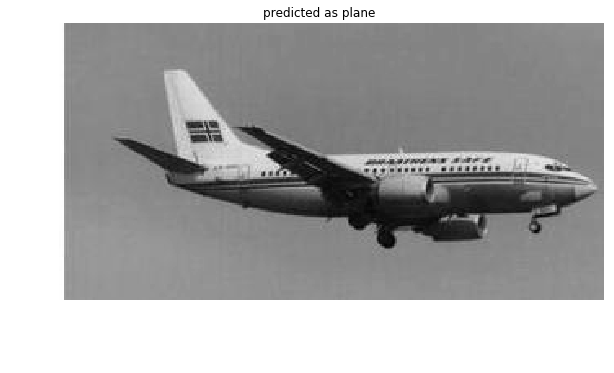

Predicting image number 395


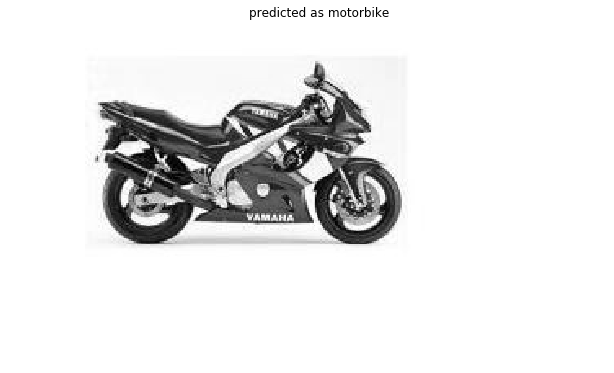

Predicting image number 396


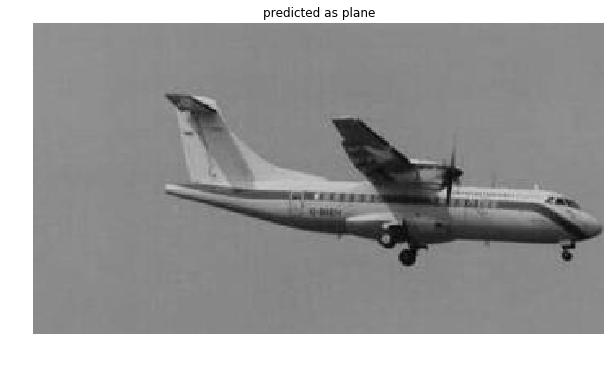

Predicting image number 397


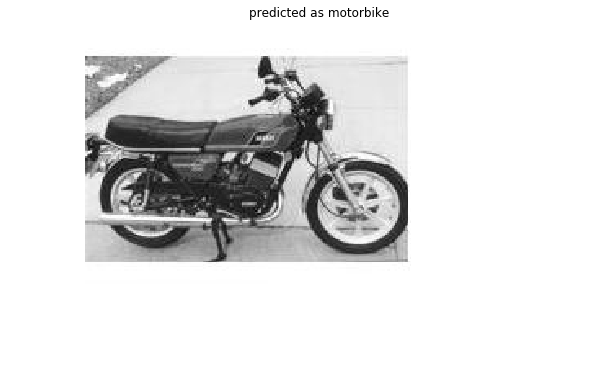

Predicting image number 398


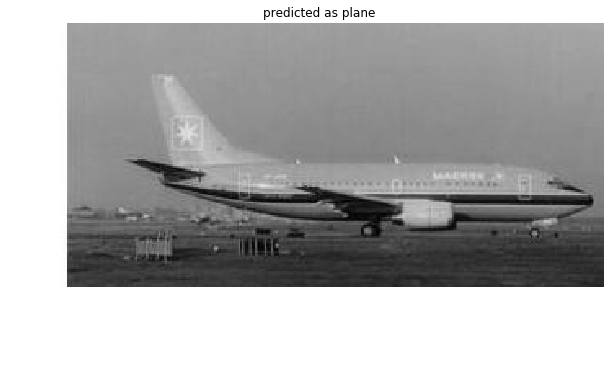

Predicting image number 399


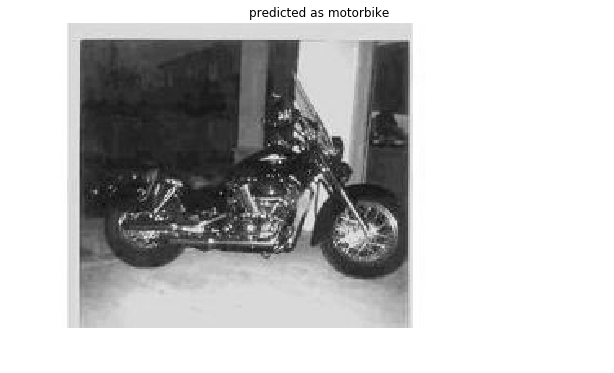

Predicting image number 400


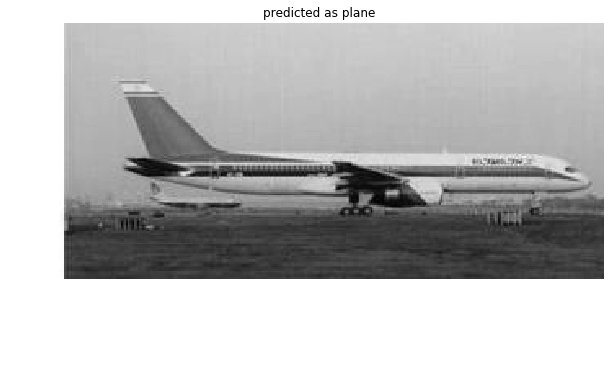

Predicting image number 401


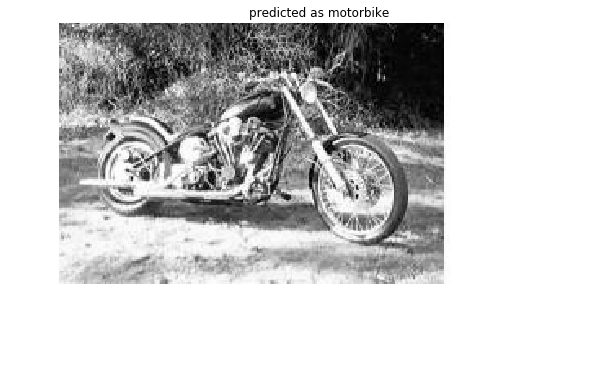

Predicting image number 402


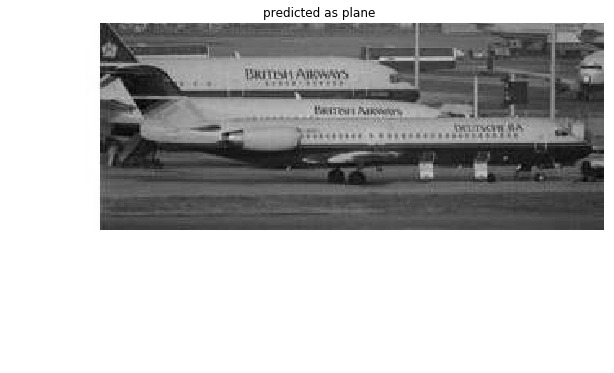

Predicting image number 403


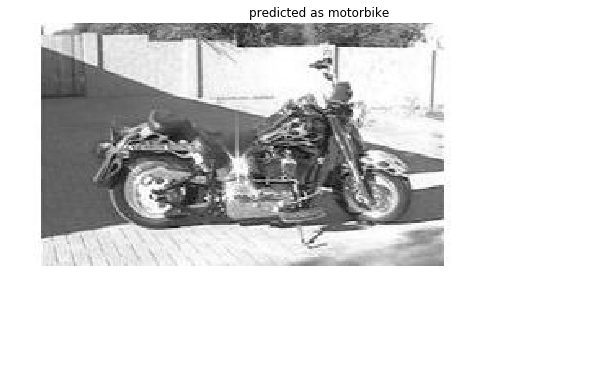

Predicting image number 404


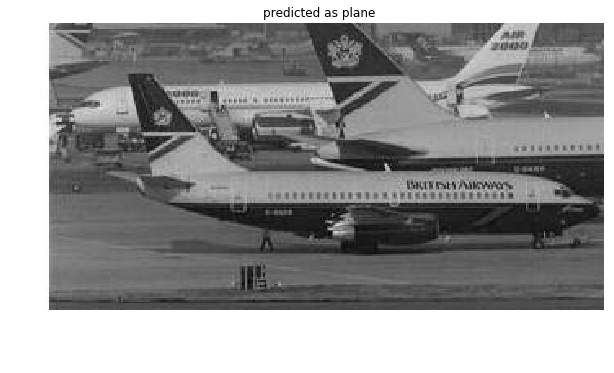

Predicting image number 405


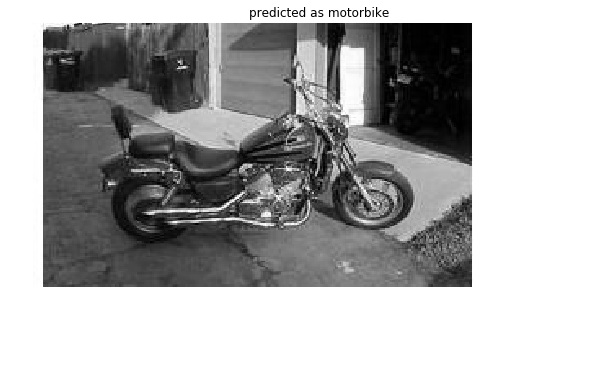

Predicting image number 406


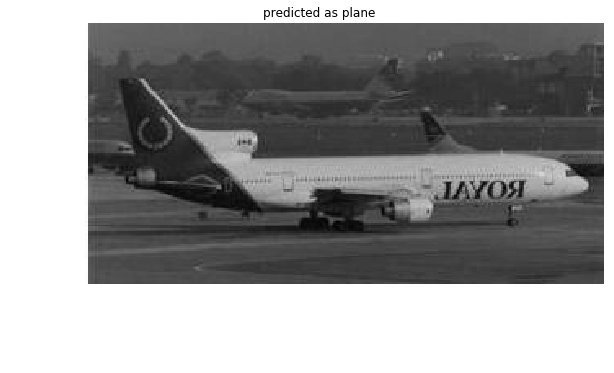

Predicting image number 407


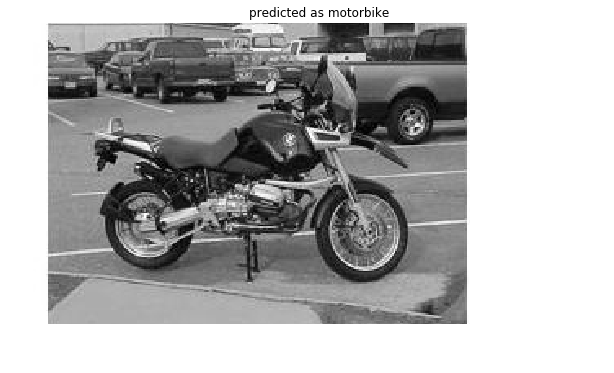

Predicting image number 408


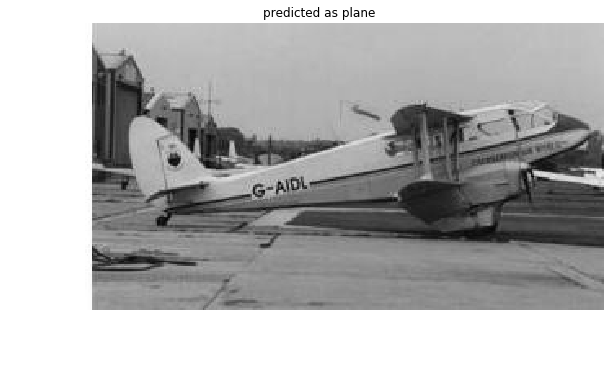

Predicting image number 409


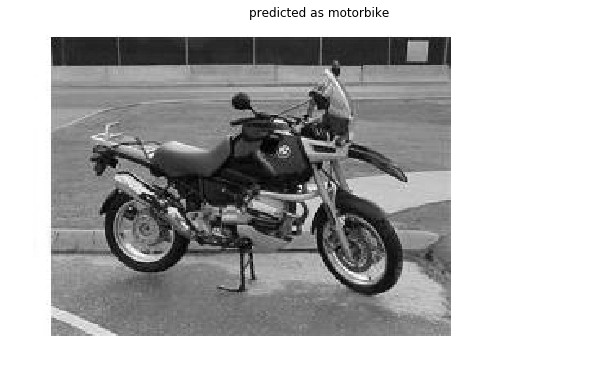

Predicting image number 410


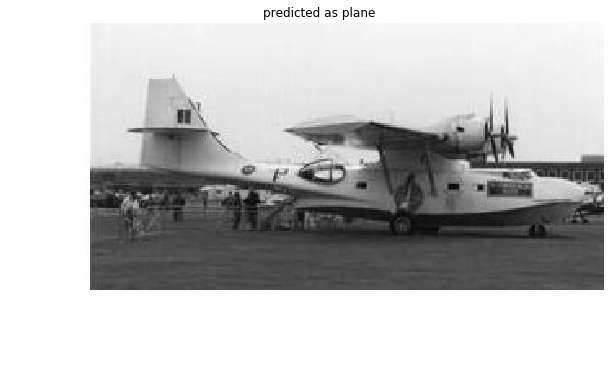

Predicting image number 411


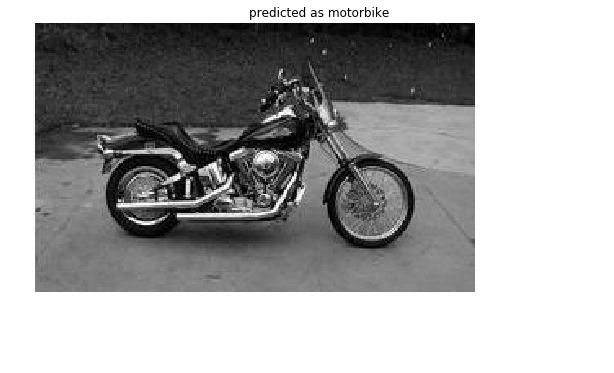

Predicting image number 412


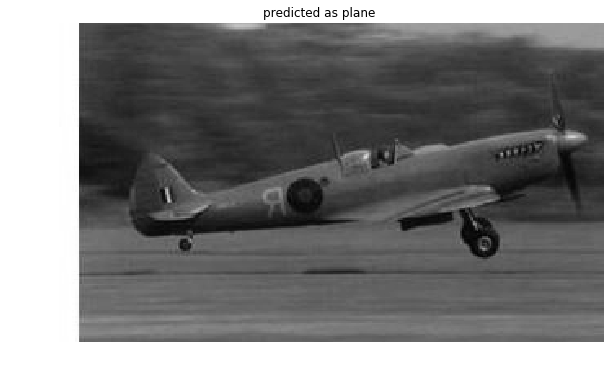

Predicting image number 413


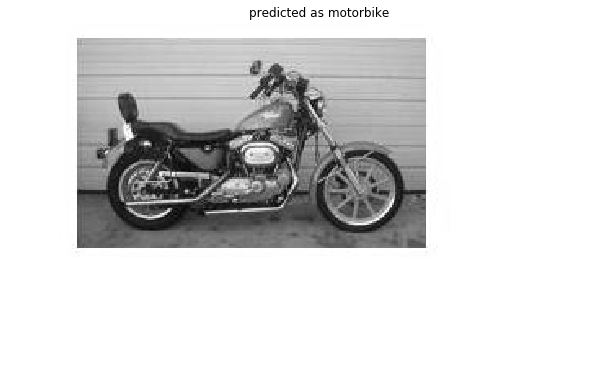

Predicting image number 414


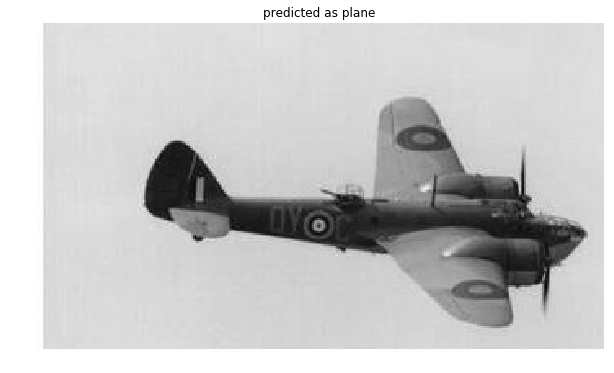

Predicting image number 415


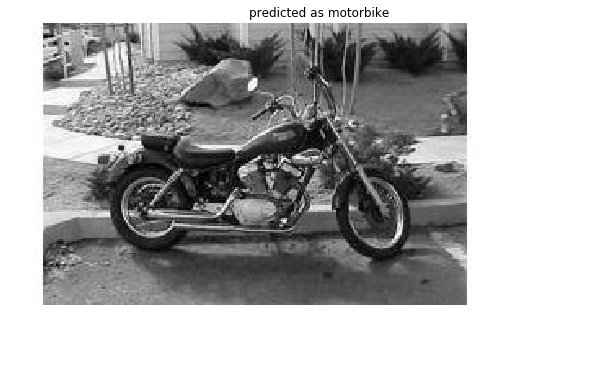

Predicting image number 416


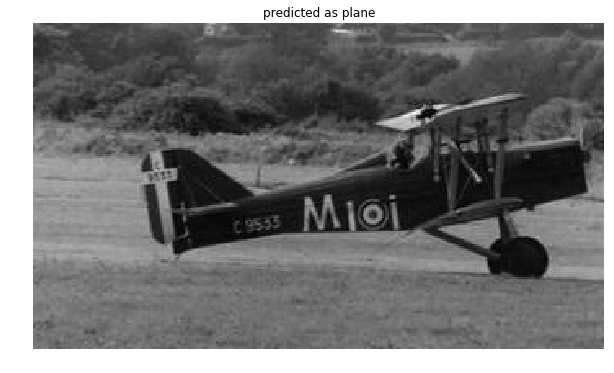

Predicting image number 417


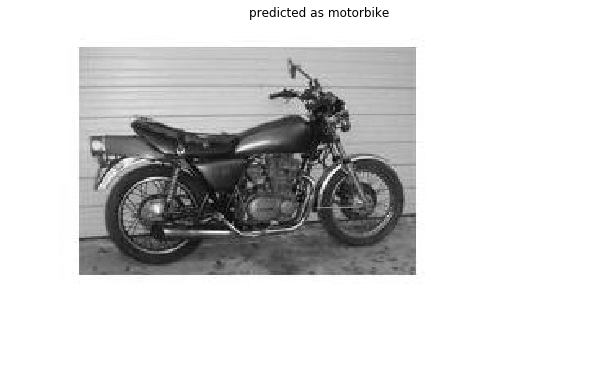

Predicting image number 418


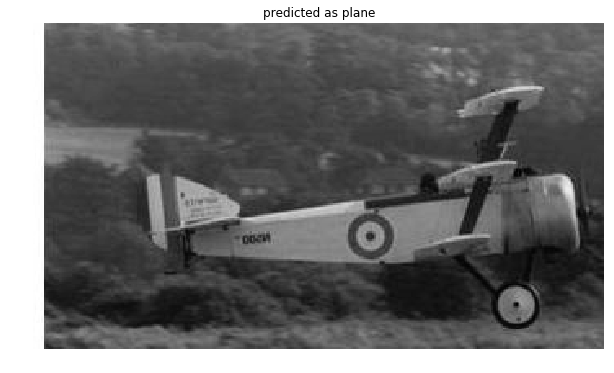

Predicting image number 419


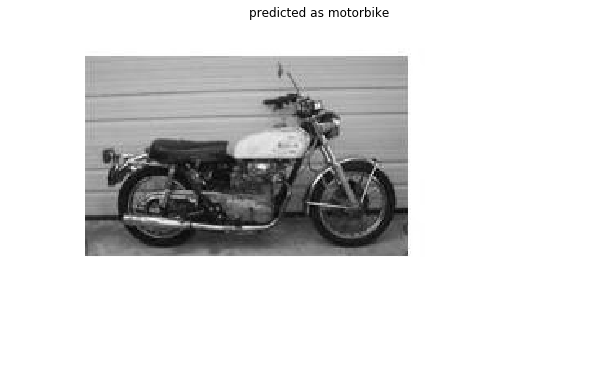

Predicting image number 420


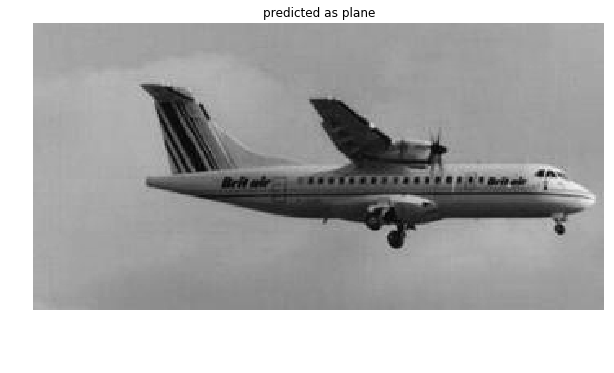

Predicting image number 421


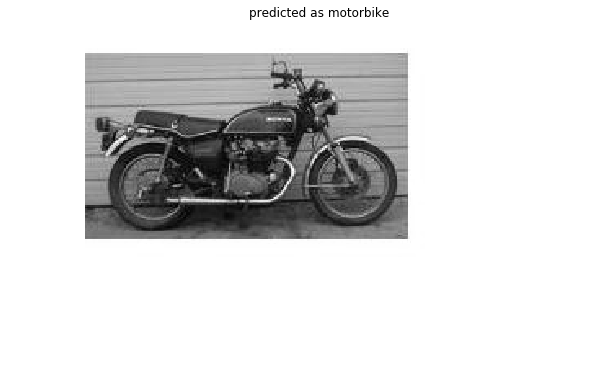

Predicting image number 422


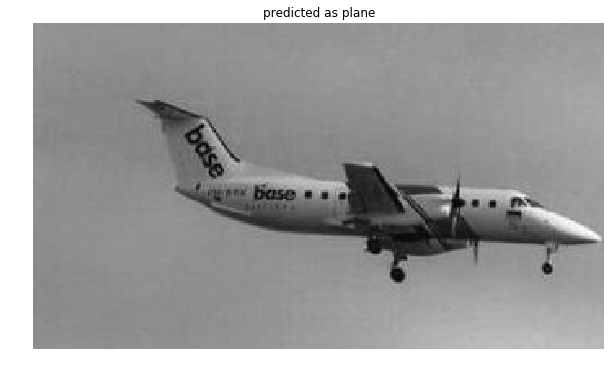

Predicting image number 423


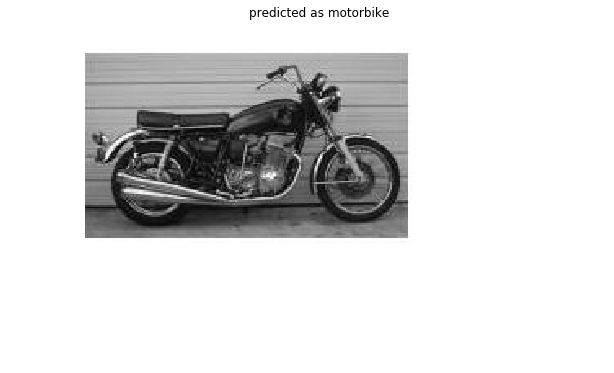

Predicting image number 424


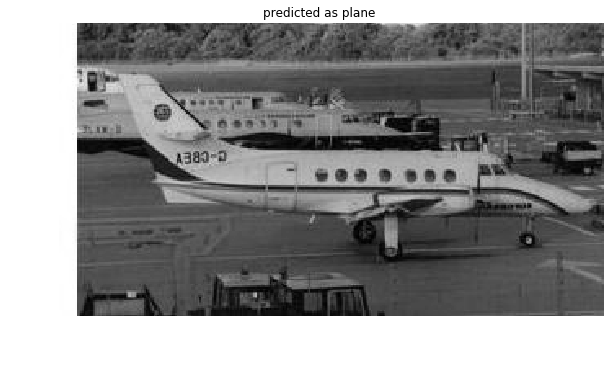

Predicting image number 425


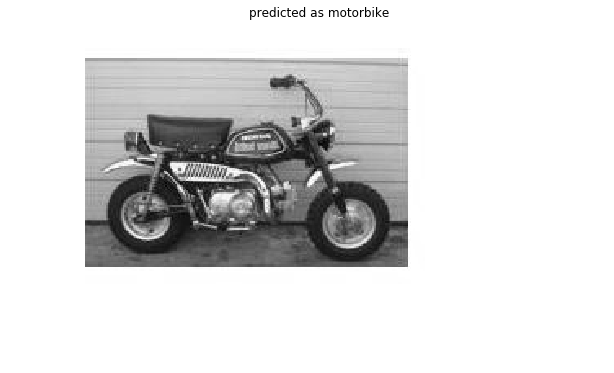

Predicting image number 426


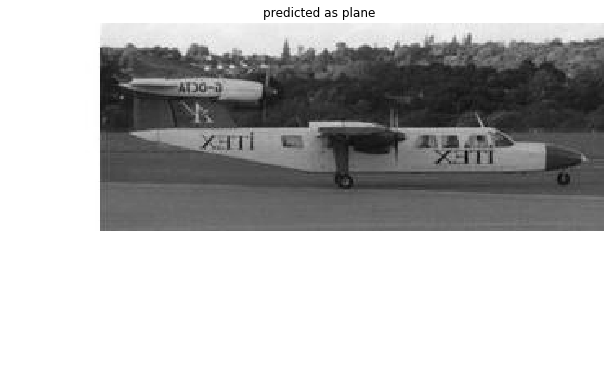

Predicting image number 427


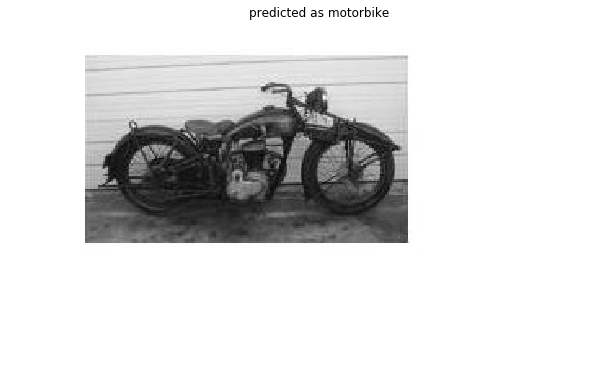

Predicting image number 428


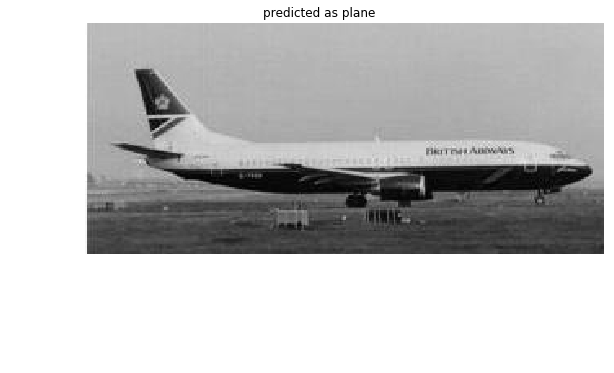

Predicting image number 429


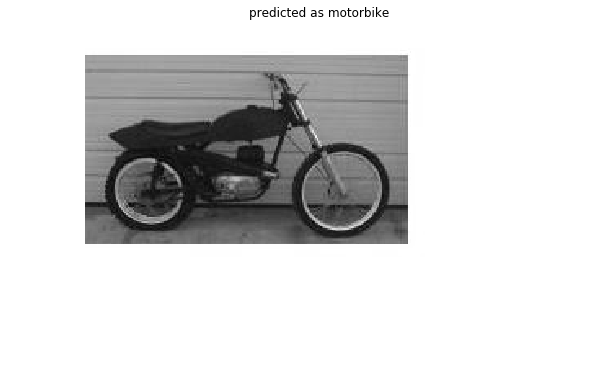

Predicting image number 430


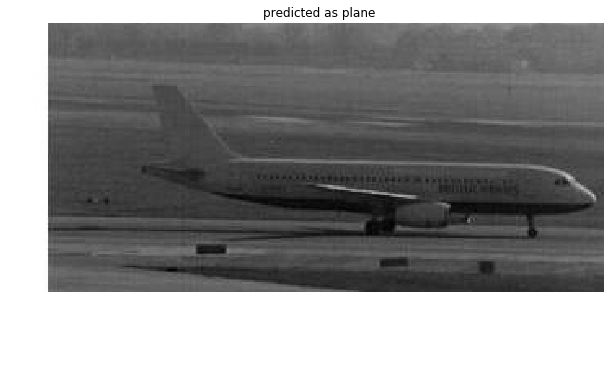

Predicting image number 431


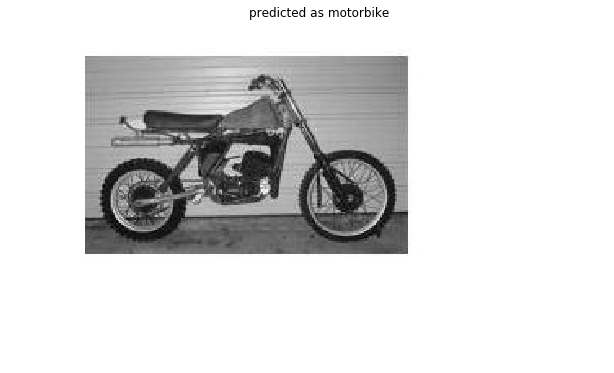

Predicting image number 432


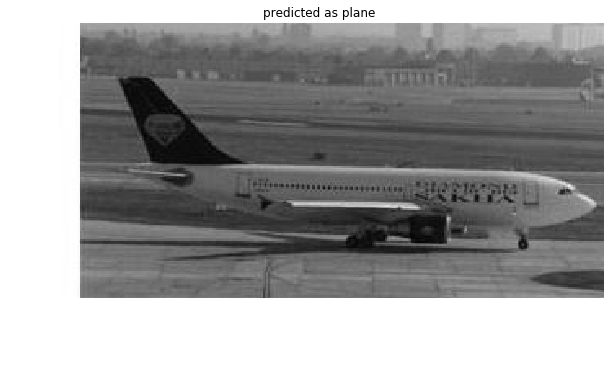

Predicting image number 433


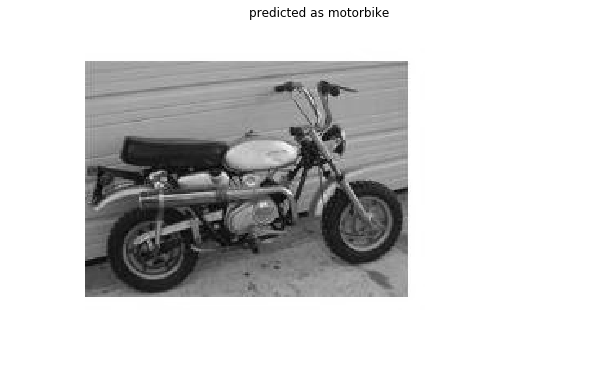

Predicting image number 434


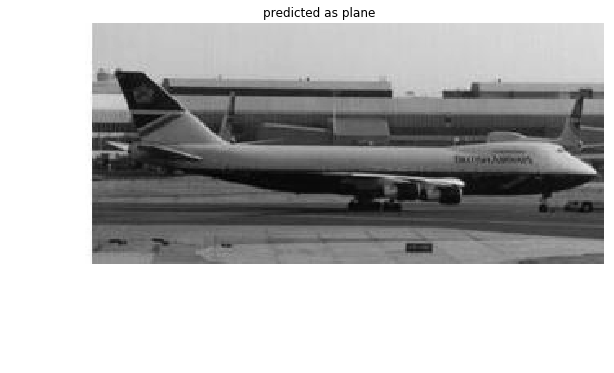

Predicting image number 435


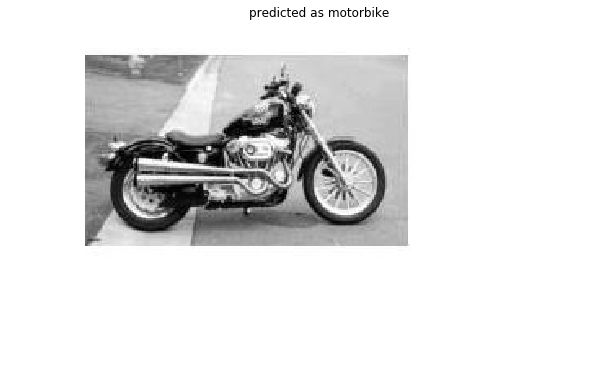

Predicting image number 436


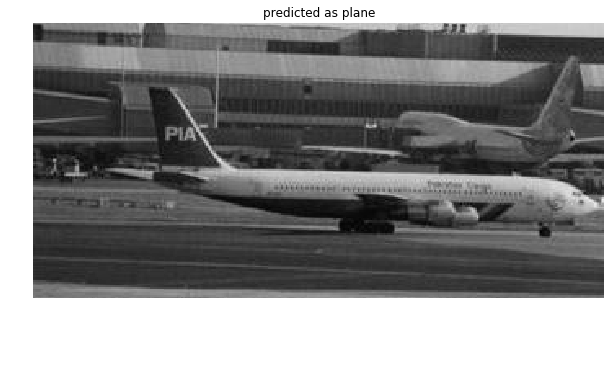

Predicting image number 437


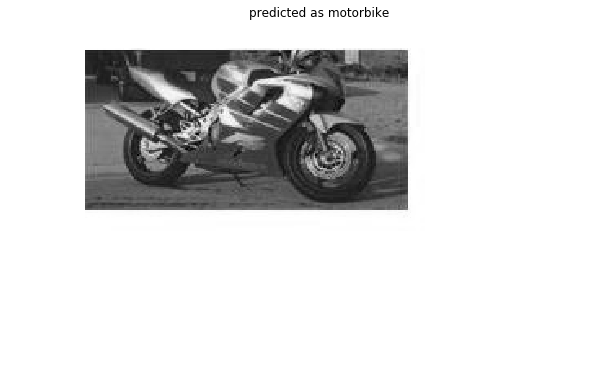

Predicting image number 438


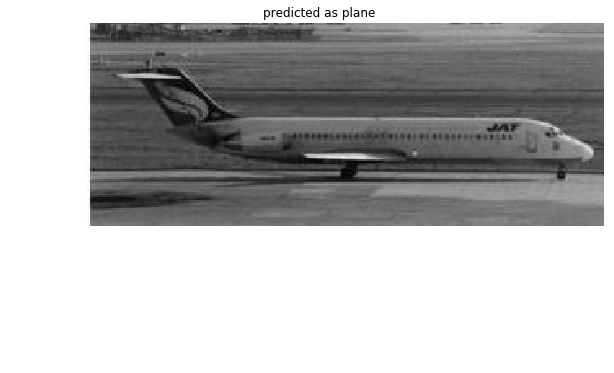

Predicting image number 439


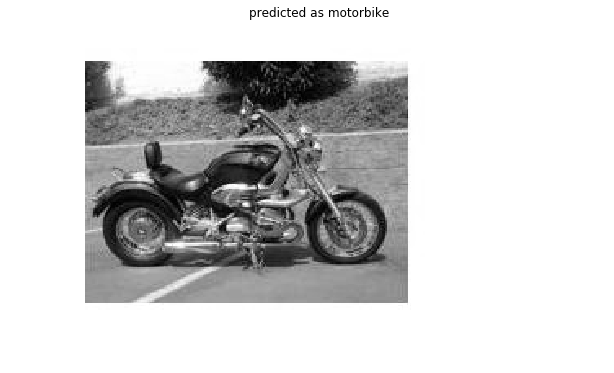

Predicting image number 440


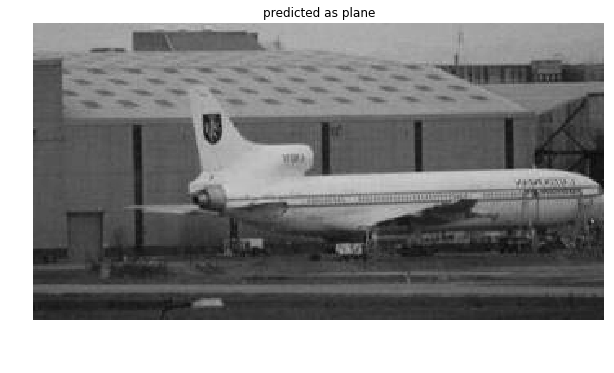

Predicting image number 441


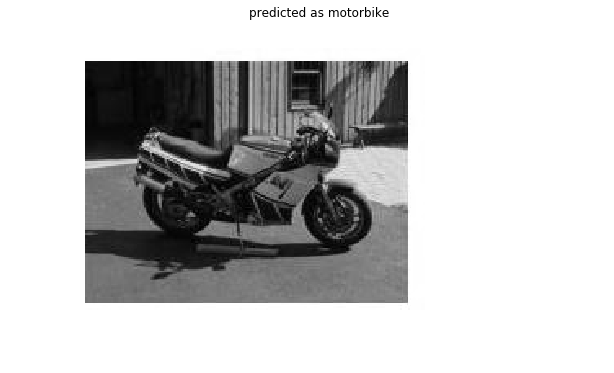

Predicting image number 442


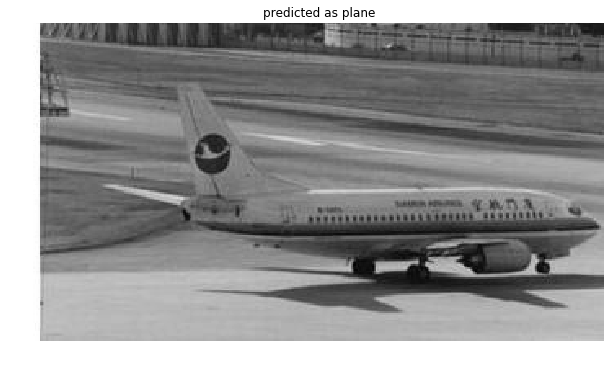

Predicting image number 443


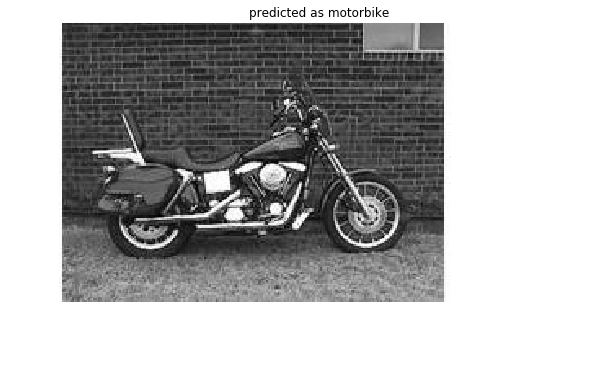

Predicting image number 444


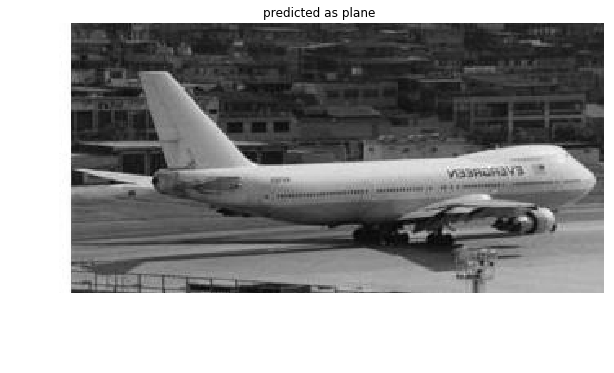

Predicting image number 445


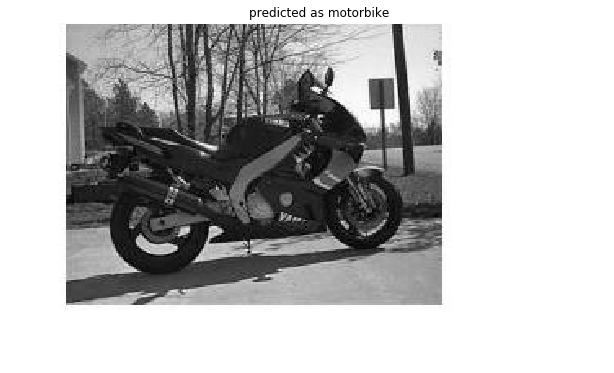

Predicting image number 446


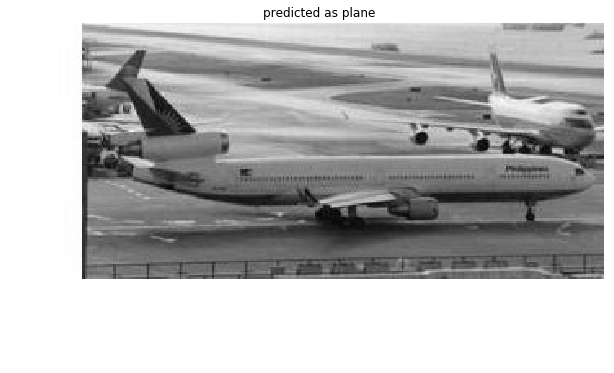

Predicting image number 447


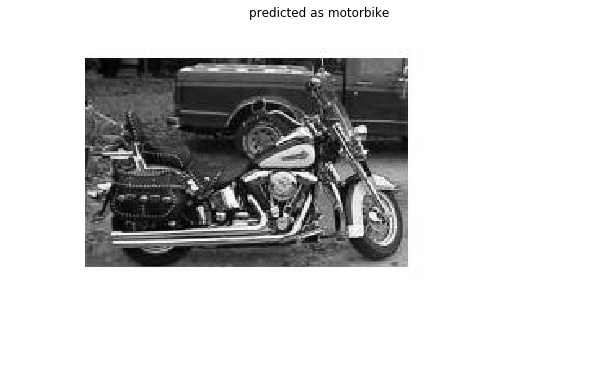

Predicting image number 448


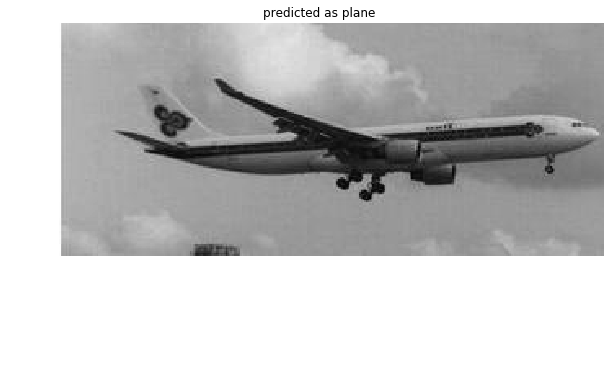

Predicting image number 449


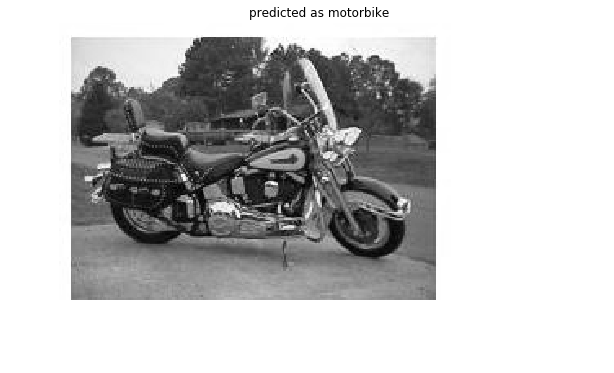

Predicting image number 450


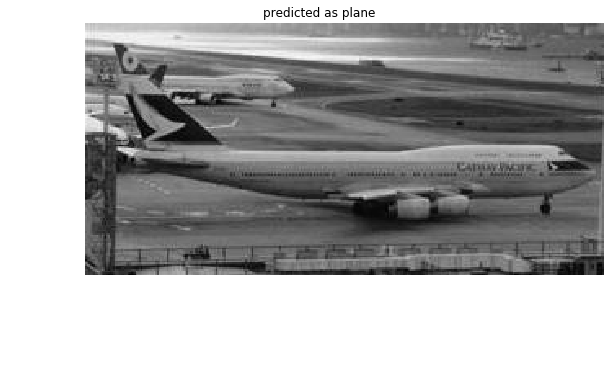

Predicting image number 451


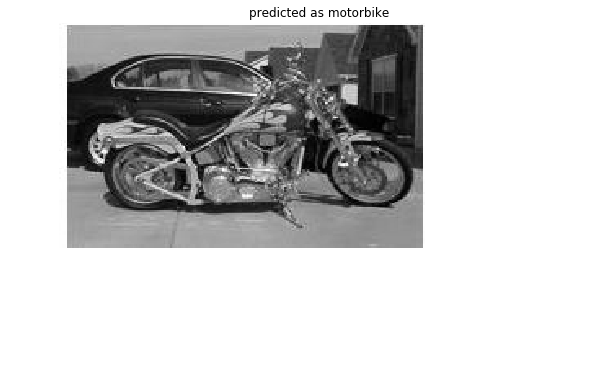

Predicting image number 452


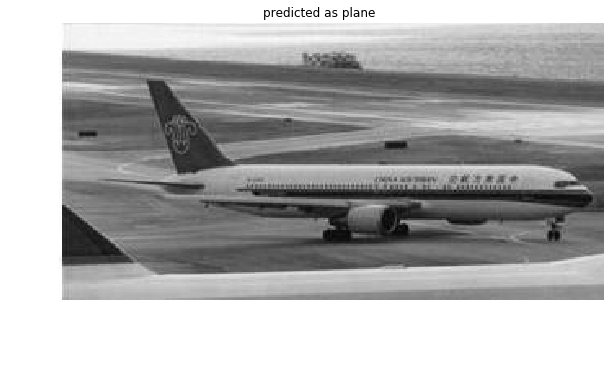

Predicting image number 453


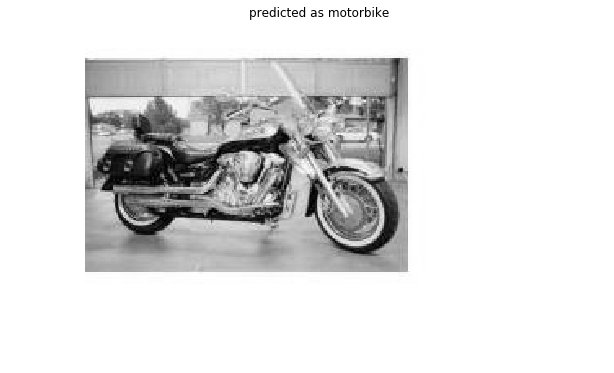

Predicting image number 454


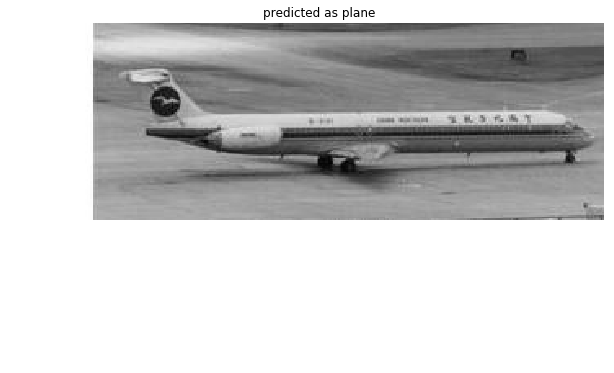

Predicting image number 455


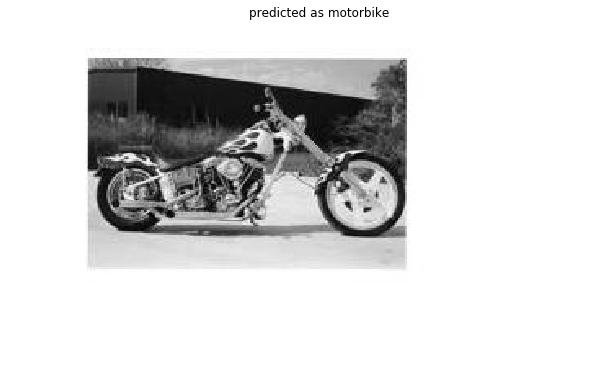

Predicting image number 456


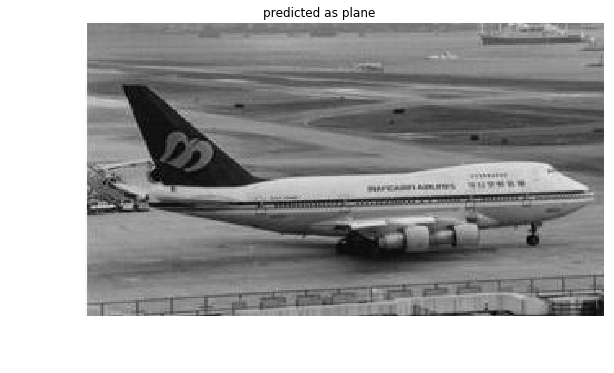

Predicting image number 457


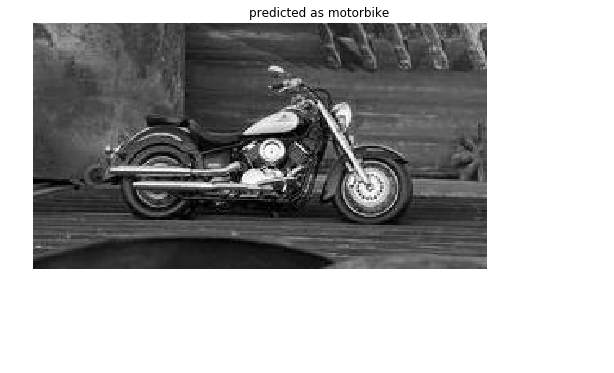

Predicting image number 458


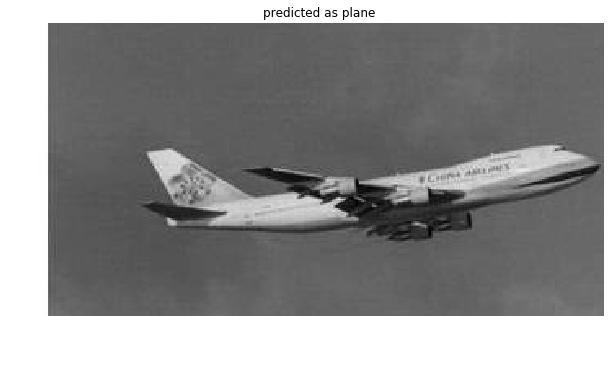

Predicting image number 459


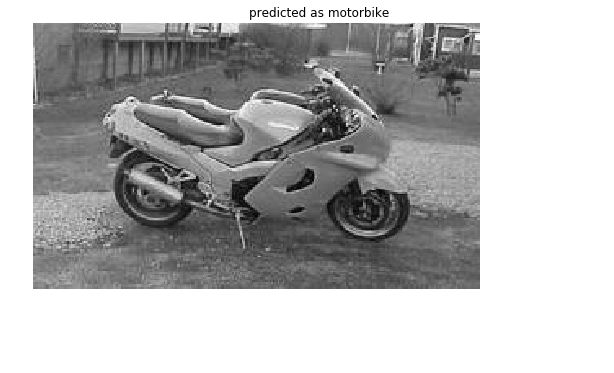

Predicting image number 460


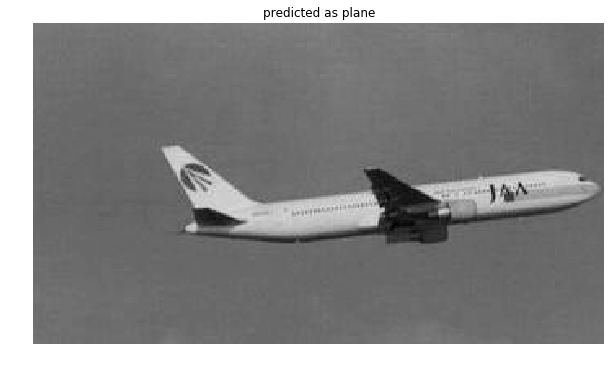

Predicting image number 461


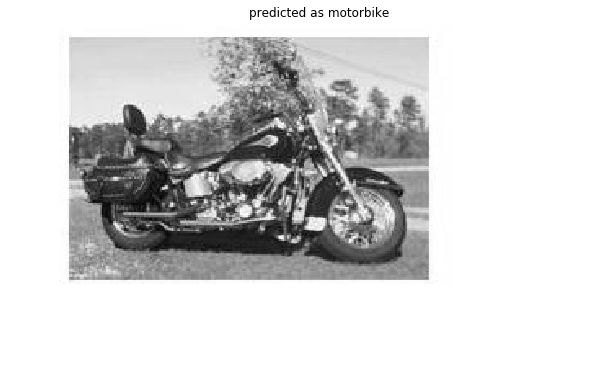

Predicting image number 462


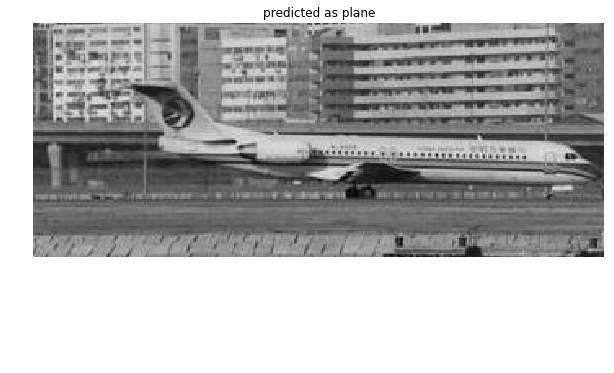

Predicting image number 463


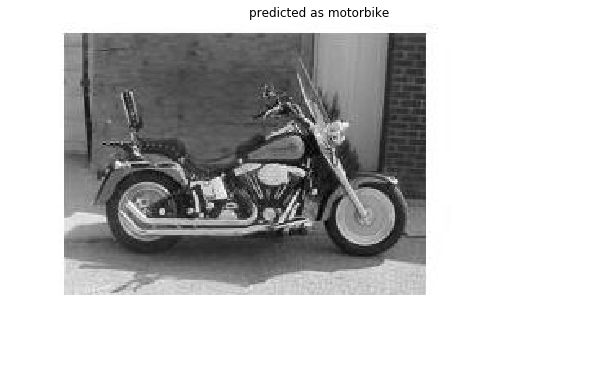

Predicting image number 464


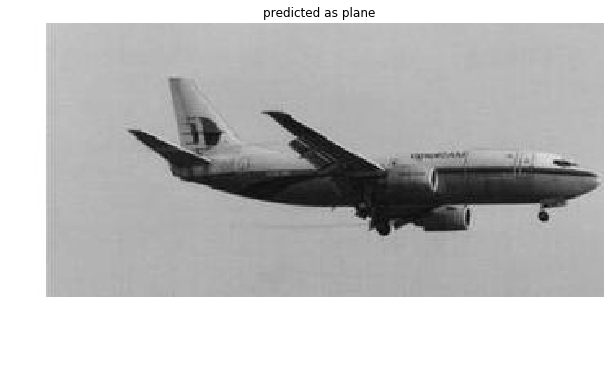

Predicting image number 465


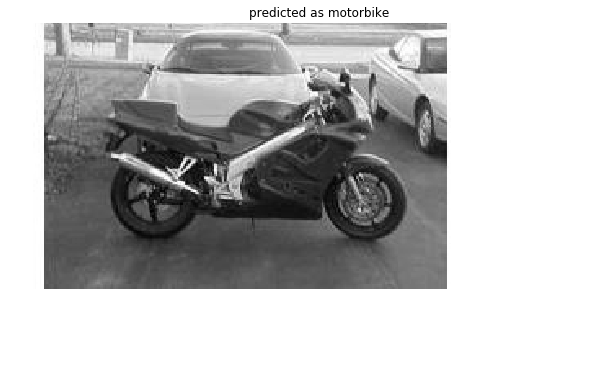

Predicting image number 466


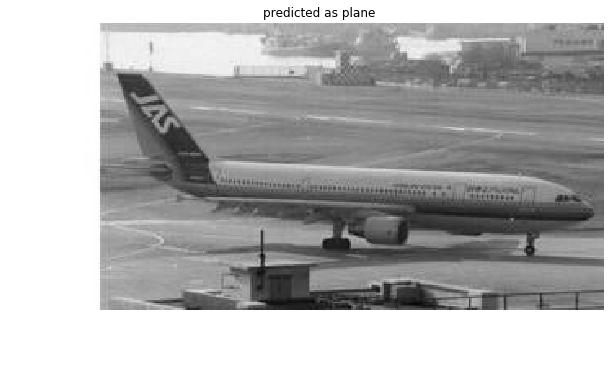

Predicting image number 467


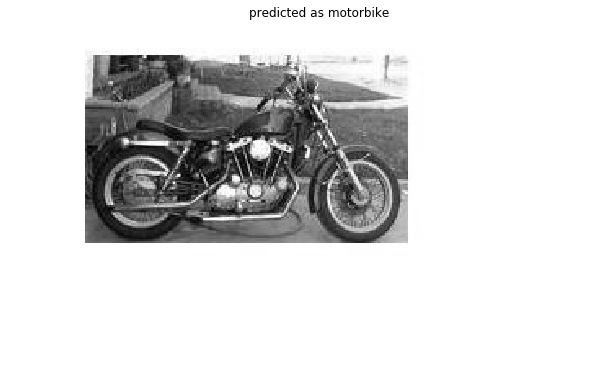

Predicting image number 468


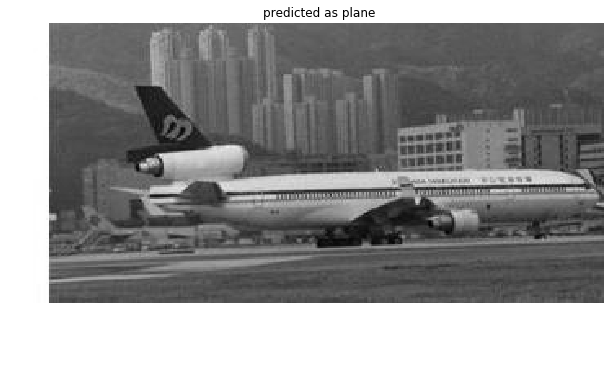

Predicting image number 469


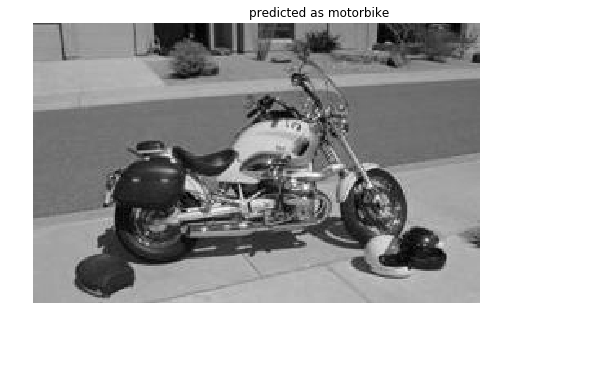

Predicting image number 470


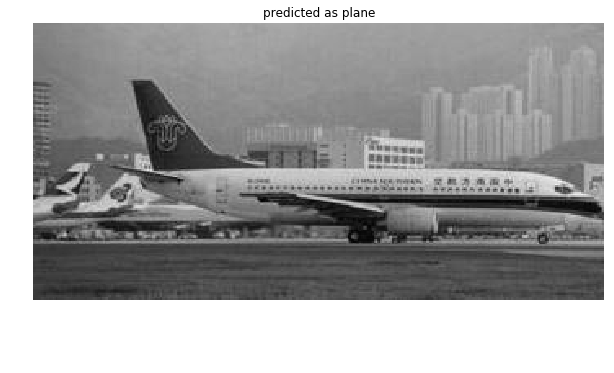

Predicting image number 471


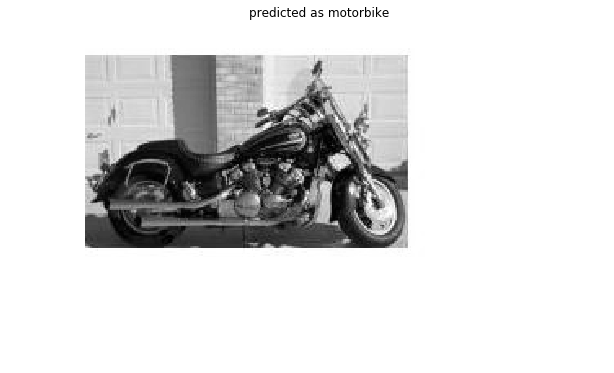

Predicting image number 472


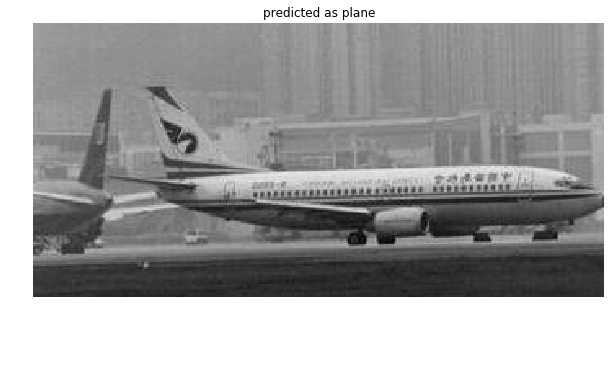

Predicting image number 473


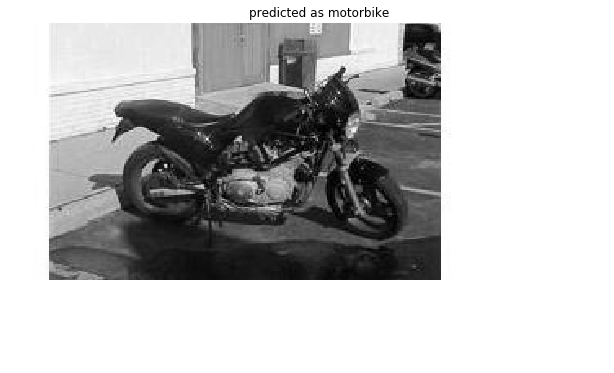

Predicting image number 474


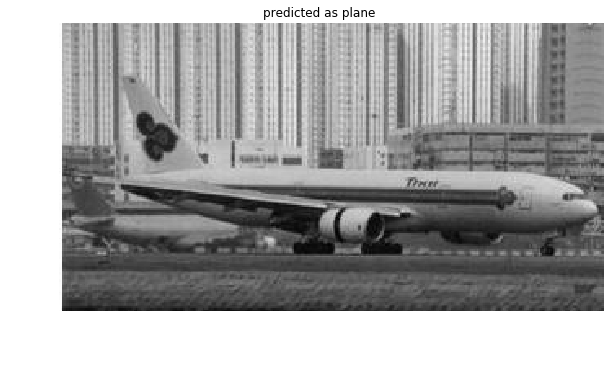

Predicting image number 475


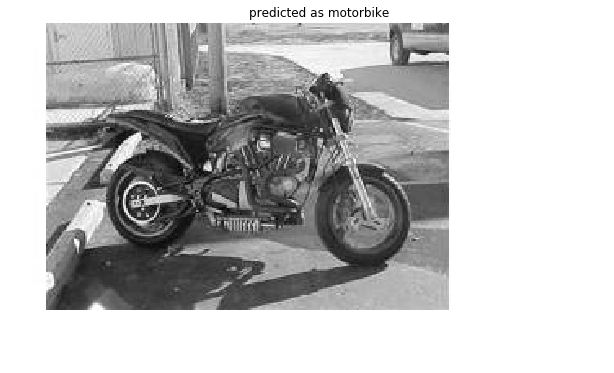

Predicting image number 476


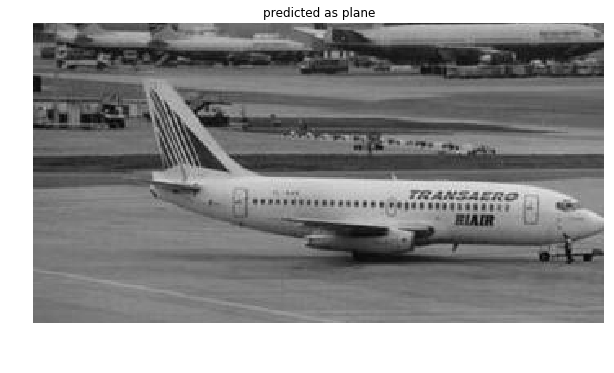

Predicting image number 477


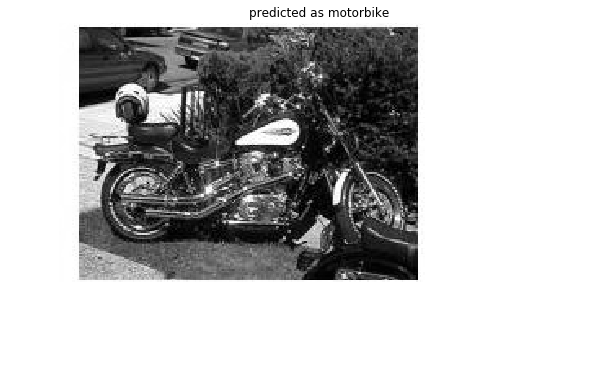

Predicting image number 478


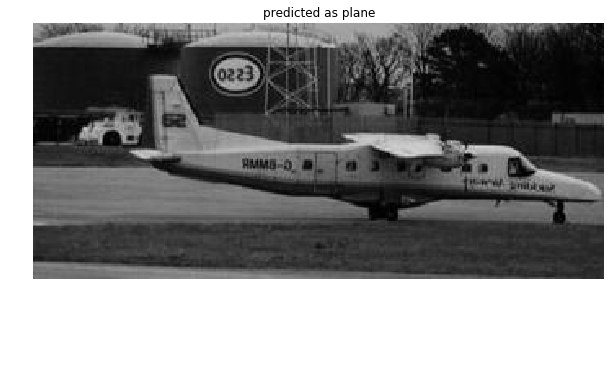

Predicting image number 479


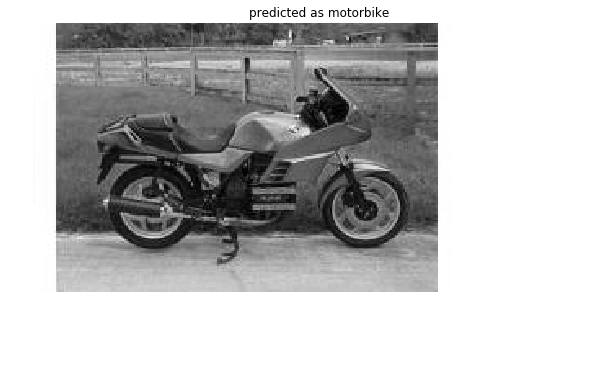

Predicting image number 480


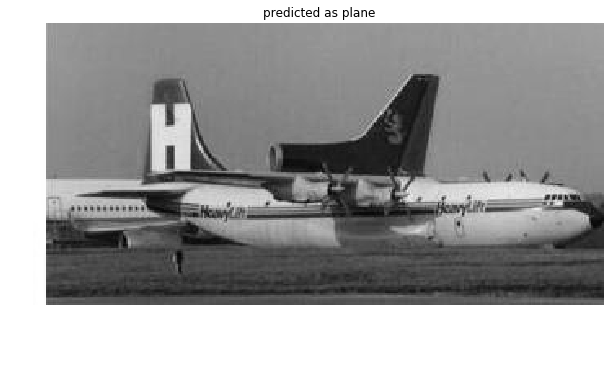

Predicting image number 481


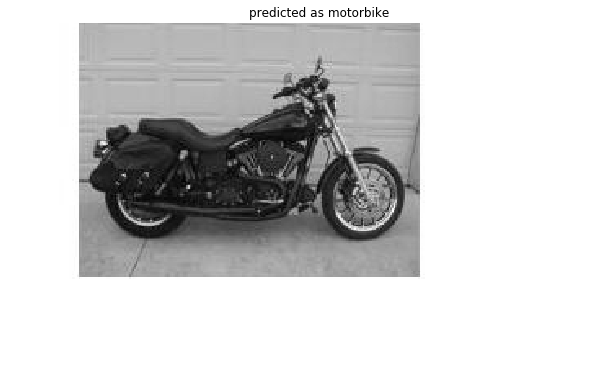

Predicting image number 482


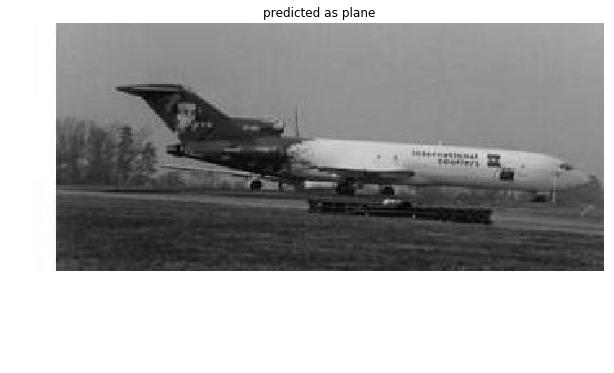

Predicting image number 483


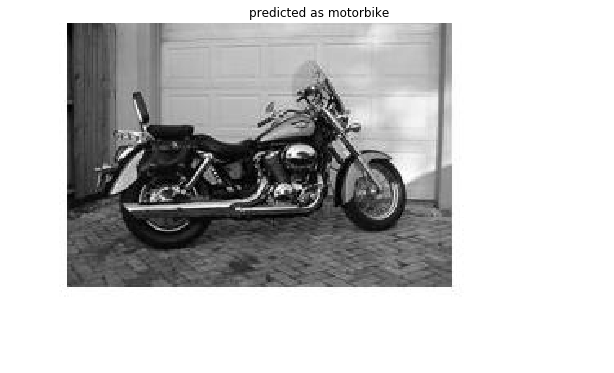

Predicting image number 484


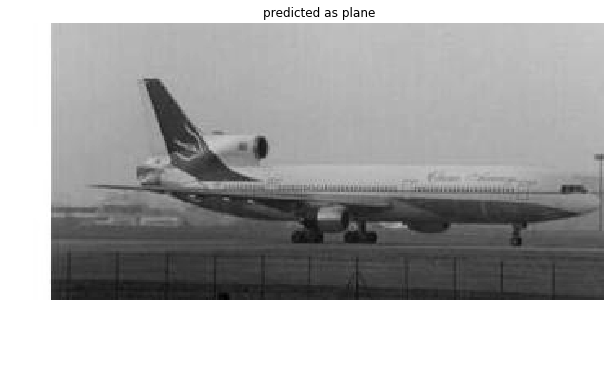

Predicting image number 485


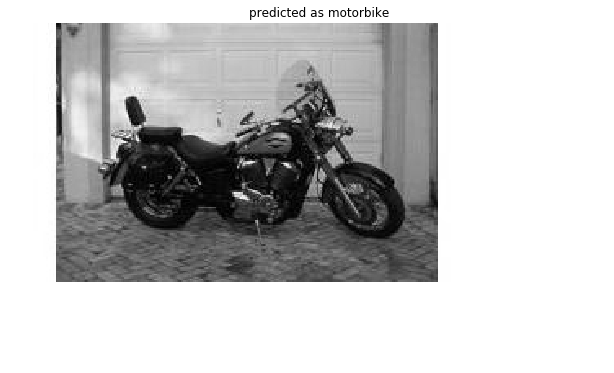

Predicting image number 486


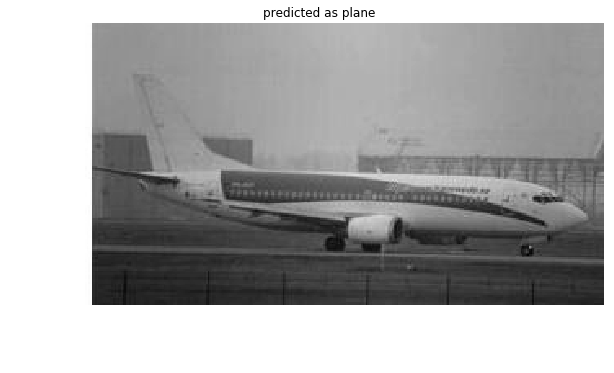

Predicting image number 487


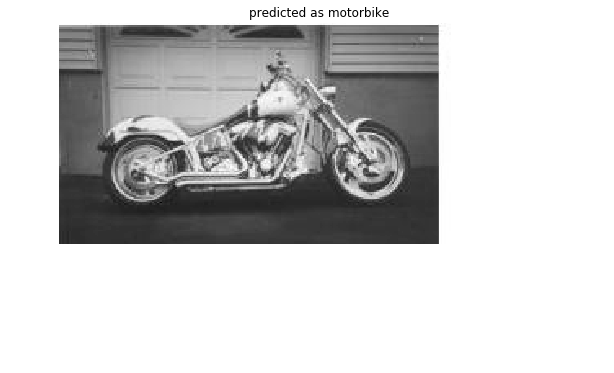

Predicting image number 488


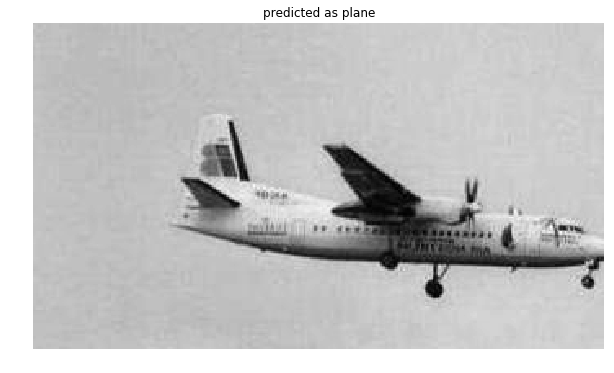

Predicting image number 489


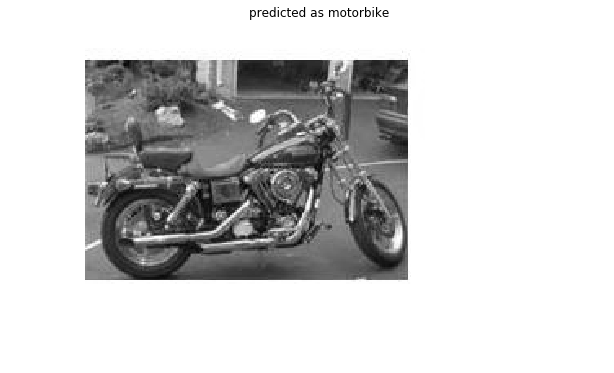

Predicting image number 490


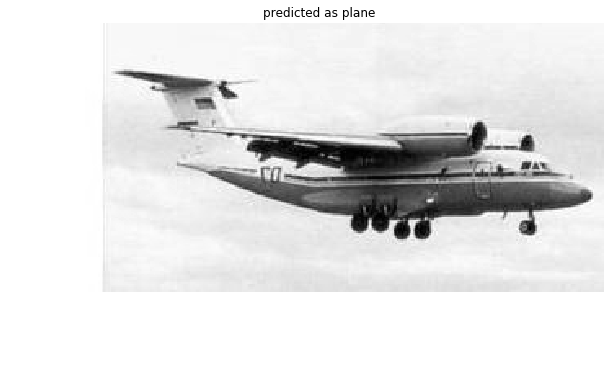

Predicting image number 491


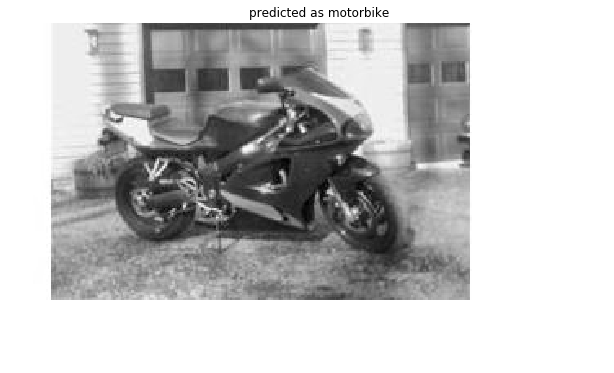

Predicting image number 492


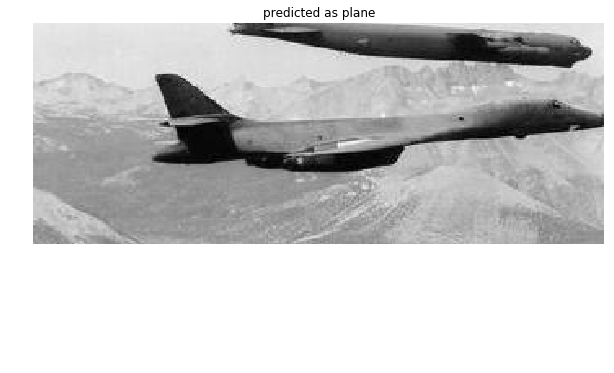

Predicting image number 493


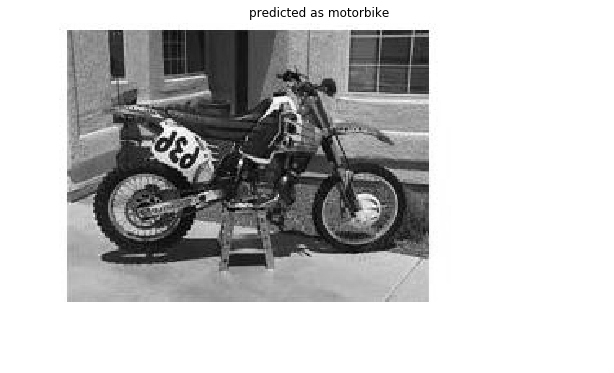

Predicting image number 494


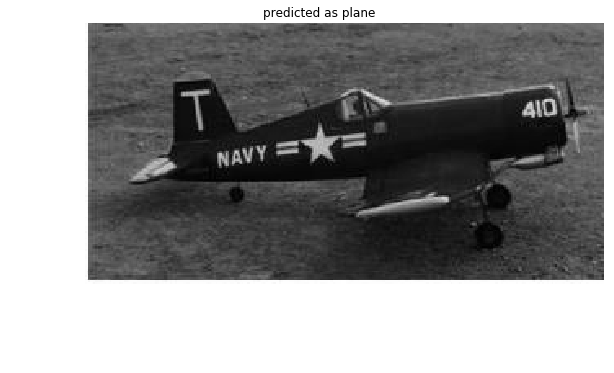

Predicting image number 495


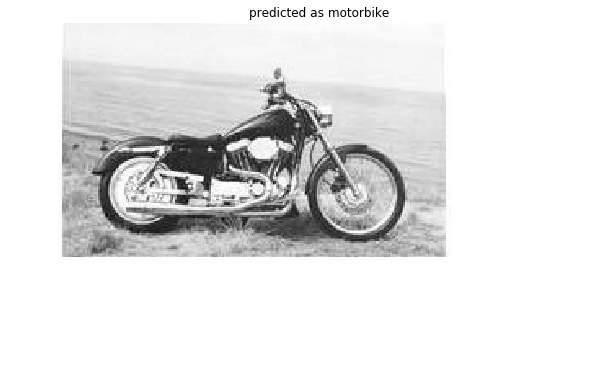

Predicting image number 496


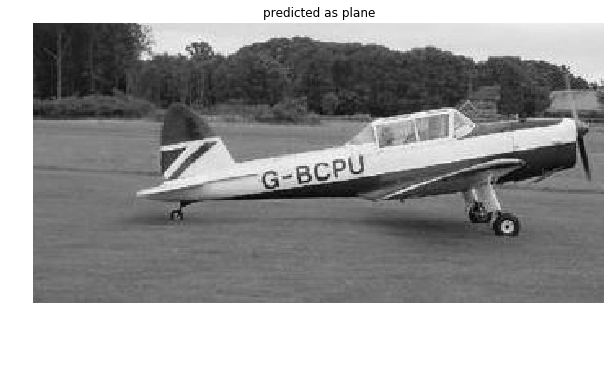

Predicting image number 497


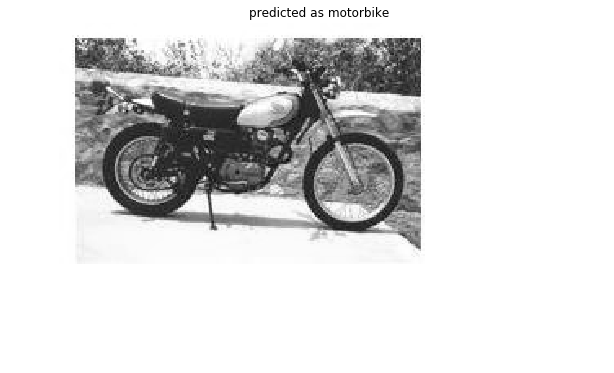

Predicting image number 498


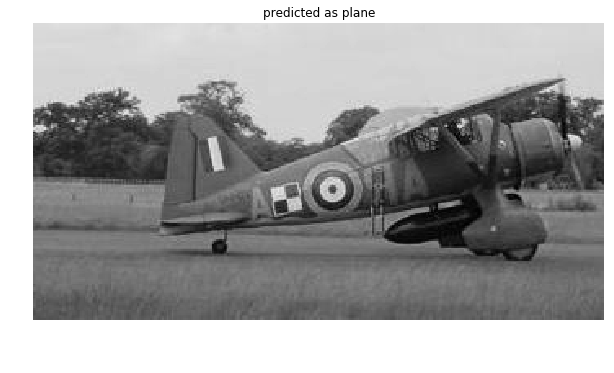

Predicting image number 499


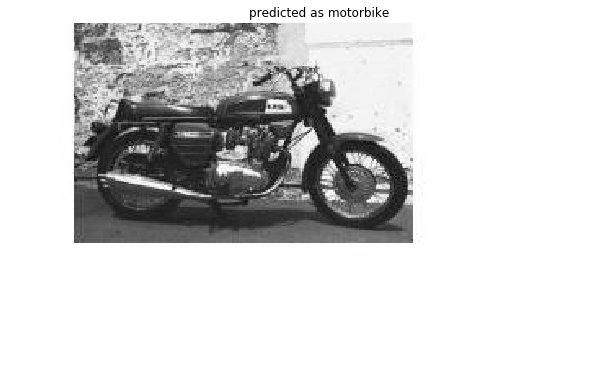

Finished predicting...
We can move on to the next step......


In [23]:
correct_index = 0
total = 0
incorrect = []
for i in range(250,500):
    plt.figure(figsize=(12,6))
    plt.imshow(img[i], 'gray')
    print "Predicting image number " + str(i)
    prediction = clf.predict(np.array(hog.compute(img[i])).reshape(1,index))
    
    if (prediction == 1):
        plt.title("predicted as plane")
    elif (prediction == -1):
        plt.title("predicted as motorbike")
    if (prediction==label[i]):
        correct_index += 1
    else:
        incorrect.append(i)
        print "Incorrect prediction"
    total+= 1   
    plt.axis("off")
    plt.show()
print "Finished predicting..."
print "We can move on to the next step......"                   

In [25]:
#accuracy for the above procedure
accuracy_percent = correct_index*100.00/total

print "Total images tested: " + str(total)
print "Correct predictions made: " + str(correct_index)
print "The percentage of accuracy is: " + str(accuracy_percent)
print "The picture that was incorrectly predicted was at " + str(incorrect) + " index." 
print "We can move on to the next step......"

# When I did my calculations, I found the following results:
    # Total images tested: 250
    # Correct predictions made: 249
    # The percentage of accuracy is: 99.6
    # The picture that was incorrectly predicted was at [321] index.
    # Bike was predicted as plane

Total images tested: 250
Correct predictions made: 249
The percentage of accuracy is: 99.6
The picture that was incorrectly predicted was at [321] index.
We can move on to the next step......


In [71]:
img_input = cv2.imread('images/test_data' + '.png')

test_data = cv2.cvtColor(img_input,cv2.COLOR_RGB2GRAY)
slide_window_h = 200
slide_window_w = 350
RED = (0,0,255) #BGR 
GREEN = (0,255,0) #BGR
plane_points = []
bike_points = []

height, width = test_data.shape # getting the height and width of the 1st image

x = 0
y = 0
p_count = 0
b_count = 0
no_count = 0

while (x <=height-slide_window_h):
    while (y <=width- slide_window_w):
        img = test_data[x:x+slide_window_h, y:y+slide_window_w] # getting a frame 
        xy = hog.compute(img) # computing the hog
        reshaped_hog = np.array(xy).reshape(1,index)
        
        prediction  = clf.predict(reshaped_hog)
        if (prediction==1):
            plane_points.append((x,y))
            print "found a plane"
            p_count +=1
        elif (prediction==-1):
            bike_points.append((x,y))
            print "found a bike"
            b_count +=1
        else:
            print "found no plane or bike"
            no_count +=1
        y+= slide_window_w/4
        print "sliding to the right..."
        print "--->"
    y = 0
    x+= slide_window_h/4
    print "sliding down....."
    print "|"
    print "|"
    print "V"
plt.show()

print ("Process Terminated")
print "plane count: " + str(p_count)
print "bike count: " + str(b_count)
print "no count: " + str(no_count)

found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
sliding down.....
|
|
V
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
sliding down.....
|
|
V
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
sliding down.....
|
|
V
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
found a plane
sliding to the right...
--->
sliding down.....
|
|
V
found a plane
sliding to the right...
--->
f

Here planes are in red and bikes are in green


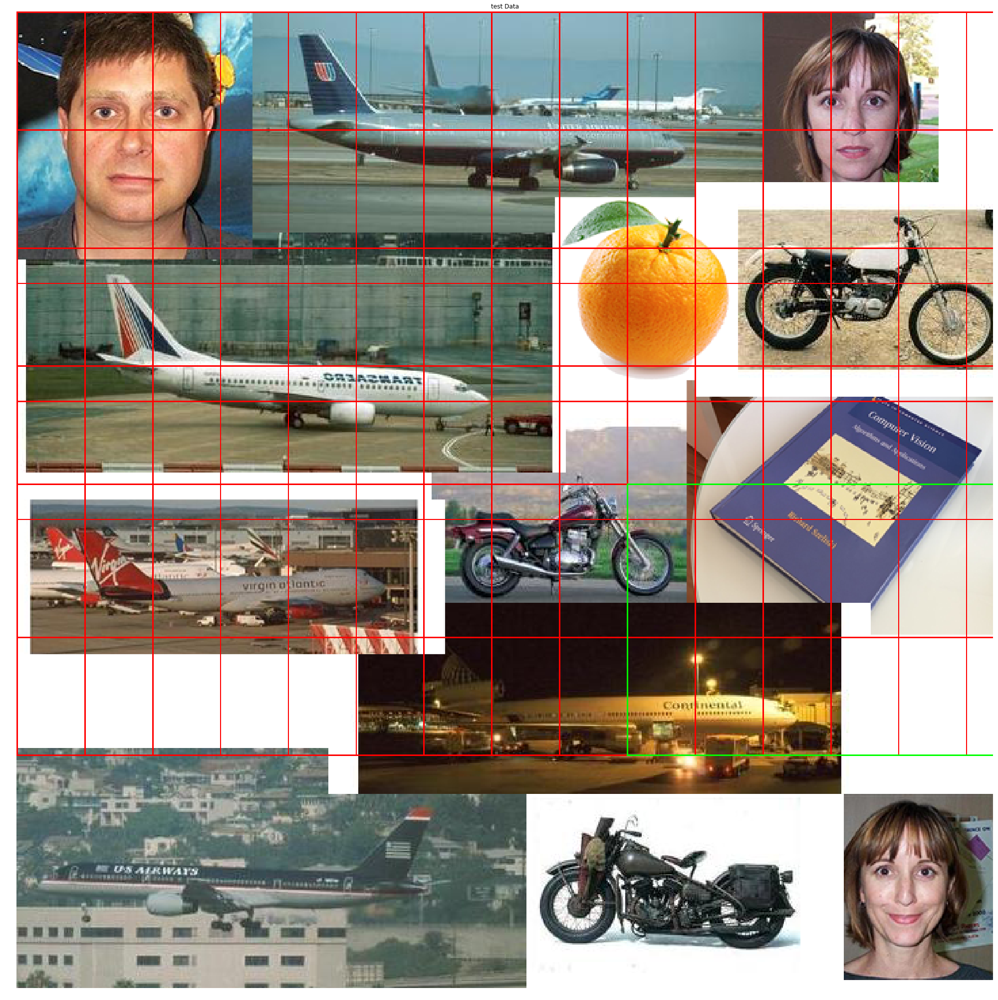

In [73]:
#test_data = cv2.cvtColor(img_input,cv2.COLOR_RGB2GRAY)
#img_input = test_data
img_input = cv2.imread('images/test_data' + '.png')
for x,y in plane_points:
    cv2.rectangle(img_input, (x,y), (x+slide_window_w,y+slide_window_h), RED,1)
    
for x,y in bike_points:
    cv2.rectangle(img_input, (x,y), (x+slide_window_w,y+slide_window_h), GREEN,1)
    
print "Here planes are in red and bikes are in green"

plt.figure(figsize=(36,36))
plt.imshow(cv2.cvtColor(img_input, cv2.COLOR_RGB2BGR))
plt.title("test Data")
plt.axis("off")
plt.show()

#have to fix the slider :(